In [1]:
!pwd
import sys
%reload_ext autoreload
%autoreload 2
%matplotlib inline
sys.executable

/c/Users/81908/jupyter_notebook/tf_2_work/Probspace_geme_compe/notebook


'C:\\Users\\81908\\Anaconda3\\envs\\tfgpu\\python.exe'

# 対戦ゲームデータ分析甲子園
- https://prob.space/competitions/game_winner/data/62

In [66]:
import os
import gc
import sys
import joblib
import warnings
import itertools

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import optuna
from joblib import Parallel, delayed
from sklearn import preprocessing
from sklearn.feature_selection import RFECV
from sklearn.inspection import permutation_importance
from sklearn.model_selection import *
from sklearn.metrics import *
import lightgbm as lgb
from lightgbm import *

sys.path.append(r"C:\Users\81908\Git\xfeat")
import xfeat
from xfeat import *
from xfeat.selector import *
from xfeat.utils import compress_df

sns.set()
warnings.simplefilter(action="ignore", category=FutureWarning)
pd.set_option('display.max_columns', None)

In [67]:
OUT_DATA = r"C:\Users\81908\jupyter_notebook\tf_2_work\Probspace_geme_compe\data\work"
os.makedirs(OUT_DATA, exist_ok=True)

ORIG = r"C:\Users\81908\jupyter_notebook\tf_2_work\Probspace_geme_compe\data\orig"
train_df = pd.read_csv(f"{ORIG}/train_data.csv")
test_df = pd.read_csv(f"{ORIG}/test_data.csv")
df_all = train_df.append(test_df).reset_index(drop=True)

## test用
#train_df = train_df.head(1000)
#test_df = test_df.head(100)
#df_all = train_df.append(test_df).reset_index(drop=True)

# データ確認

In [68]:
def df_info(df):
    df.info()
    display(df.head().style.background_gradient(cmap="Pastel1"))
    display(df.describe().T.style.background_gradient(cmap="Pastel1"))

    # カラム名 / カラムごとのユニーク値数 / 最も出現頻度の高い値 / 最も出現頻度の高い値の出現回数 / 欠損損値の割合 / 最も多いカテゴリの割合 / dtypes を表示
    stats = []
    for col in df.columns:
        stats.append(
            (
                col,
                df[col].nunique(),
                df[col].value_counts().index[0],
                df[col].value_counts().values[0],
                df[col].isnull().sum() * 100 / df.shape[0],
                df[col].value_counts(normalize=True, dropna=False).values[0] * 100,
                df[col].dtype,
            )
        )
    stats_df = pd.DataFrame(
        stats,
        columns=[
            "Feature",
            "Unique values",
            "Most frequent item",
            "Freuquence of most frequent item",
            "Percentage of missing values",
            "Percentage of values in the biggest category",
            "Type",
        ],
    )
    display(stats_df.sort_values("Percentage of missing values", ascending=False).style.background_gradient(cmap="Pastel1"))

In [69]:
df_info(train_df)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 66125 entries, 0 to 66124
Data columns (total 32 columns):
id            66125 non-null int64
period        66125 non-null object
game-ver      66125 non-null object
lobby-mode    66125 non-null object
lobby         66125 non-null object
mode          66125 non-null object
stage         66125 non-null object
A1-weapon     66125 non-null object
A1-rank       51681 non-null object
A1-level      66125 non-null int64
A2-weapon     66125 non-null object
A2-rank       51681 non-null object
A2-level      66125 non-null float64
A3-weapon     66125 non-null object
A3-rank       51681 non-null object
A3-level      66125 non-null float64
A4-weapon     66074 non-null object
A4-rank       51638 non-null object
A4-level      66074 non-null float64
B1-weapon     66125 non-null object
B1-rank       51681 non-null object
B1-level      66125 non-null int64
B2-weapon     66125 non-null object
B2-rank       51681 non-null object
B2-level      66125 non-nul

,id,period,game-ver,lobby-mode,lobby,mode,stage,A1-weapon,A1-rank,A1-level,A2-weapon,A2-rank,A2-level,A3-weapon,A3-rank,A3-level,A4-weapon,A4-rank,A4-level,B1-weapon,B1-rank,B1-level,B2-weapon,B2-rank,B2-level,B3-weapon,B3-rank,B3-level,B4-weapon,B4-rank,B4-level,y
0,1,2019-10-15T20:00:00+00:00,5.0.1,regular,standard,nawabari,sumeshi,sshooter_becchu,nan,139,soytuber_custom,nan,118,pablo_hue,nan,13,hokusai,nan,10,bold_7,nan,28,hokusai_becchu,nan,26,herocharger_replica,nan,68,sharp_neo,nan,31,1
1,2,2019-12-14T04:00:00+00:00,5.0.1,regular,standard,nawabari,arowana,parashelter_sorella,nan,198,jetsweeper,nan,77,campingshelter_camo,nan,198,nzap85,nan,123,momiji,nan,83,squiclean_b,nan,118,campingshelter,nan,168,sputtery_clear,nan,151,0
2,3,2019-12-25T14:00:00+00:00,5.0.1,gachi,standard,hoko,ama,nzap89,a-,114,quadhopper_black,a,68,prime_becchu,a,225,jetsweeper,a,107,bold_7,a-,50,nzap85,a+,163,prime_becchu,a-,160,dualsweeper_custom,a,126,0
3,4,2019-11-11T14:00:00+00:00,5.0.1,regular,standard,nawabari,engawa,bamboo14mk1,nan,336,splatroller_becchu,nan,131,dynamo_tesla,nan,189,prime_becchu,nan,41,splatcharger_becchu,nan,273,liter4k,nan,189,promodeler_mg,nan,194,hotblaster_custom,nan,391,0
4,5,2019-12-14T06:00:00+00:00,5.0.1,gachi,standard,hoko,chozame,bold_7,x,299,hissen_hue,x,97,h3reelgun_d,x,96,splatroller,x,136,furo,x,101,sputtery_hue,x,45,bucketslosher_soda,x,246,wakaba,x,160,1


,count,mean,std,min,25%,50%,75%,max
id,66125,33063,19088.8,1,16532,33063,49594,66125
A1-level,66125,208.839,118.987,1,120,188,277,585
A2-level,66125,155.352,96.184,1,82,139,208,913
A3-level,66125,153.175,95.4707,1,80,137,205,920
A4-level,66074,156.002,95.5246,1,84,140,208,931
B1-level,66125,156.379,97.1095,1,83,139,210,920
B2-level,66125,152.765,95.3735,1,80,136,205,913
B3-level,66124,153.105,94.8917,1,81,137,205,933
B4-level,66058,157.87,95.7776,1,86,142,212,936
y,66125,0.524703,0.499393,0,0,1,1,1


,Feature,Unique values,Most frequent item,Freuquence of most frequent item,Percentage of missing values,Percentage of values in the biggest category,Type
29,B4-rank,12,x,24704,21.9297,37.3595,object
17,A4-rank,12,x,24714,21.9085,37.3747,object
23,B2-rank,12,x,24736,21.8435,37.4079,object
20,B1-rank,12,x,24736,21.8435,37.4079,object
26,B3-rank,12,x,24736,21.8435,37.4079,object
14,A3-rank,12,x,24736,21.8435,37.4079,object
8,A1-rank,12,x,24736,21.8435,37.4079,object
11,A2-rank,12,x,24736,21.8435,37.4079,object
30,B4-level,612,198,893,0.101323,1.35047,float64
28,B4-weapon,139,splatroller,3380,0.101323,5.11153,object


In [70]:
df_info(test_df)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28340 entries, 0 to 28339
Data columns (total 31 columns):
id            28340 non-null int64
period        28340 non-null object
game-ver      28340 non-null object
lobby-mode    28340 non-null object
lobby         28340 non-null object
mode          28340 non-null object
stage         28340 non-null object
A1-weapon     28340 non-null object
A1-rank       22068 non-null object
A1-level      28340 non-null int64
A2-weapon     28340 non-null object
A2-rank       22068 non-null object
A2-level      28340 non-null float64
A3-weapon     28340 non-null object
A3-rank       22068 non-null object
A3-level      28340 non-null float64
A4-weapon     28325 non-null object
A4-rank       22060 non-null object
A4-level      28325 non-null float64
B1-weapon     28340 non-null object
B1-rank       22068 non-null object
B1-level      28340 non-null int64
B2-weapon     28340 non-null object
B2-rank       22068 non-null object
B2-level      28340 non-nul

,id,period,game-ver,lobby-mode,lobby,mode,stage,A1-weapon,A1-rank,A1-level,A2-weapon,A2-rank,A2-level,A3-weapon,A3-rank,A3-level,A4-weapon,A4-rank,A4-level,B1-weapon,B1-rank,B1-level,B2-weapon,B2-rank,B2-level,B3-weapon,B3-rank,B3-level,B4-weapon,B4-rank,B4-level
0,1,2019-12-17T12:00:00+00:00,5.0.1,gachi,standard,area,hakofugu,prime_collabo,x,174,herospinner_replica,x,130,nzap89,x,127,nova_becchu,x,233,furo,x,160,nautilus47,x,151,l3reelgun_d,x,213,nzap89,x,306
1,2,2019-11-25T16:00:00+00:00,5.0.1,gachi,standard,asari,anchovy,prime_becchu,s+,363,nzap89,s+,59,dynamo_becchu,s+,36,rapid_becchu,s+,225,furo,s+,326,dualsweeper_custom,s+,289,prime_becchu,s+,147,splatroller,s+,156
2,3,2019-10-22T08:00:00+00:00,5.0.1,gachi,standard,area,mutsugoro,furo_deco,s,116,bold,s,125,nzap85,s,124,wakaba,s,181,splatroller,s,76,momiji,s,232,nzap83,s,183,promodeler_pg,s,105
3,4,2019-12-30T04:00:00+00:00,5.0.1,gachi,standard,asari,devon,prime_becchu,s+,192,splatspinner_collabo,s+,115,pablo,s+,171,dualsweeper_custom,s+,170,momiji,s+,90,quadhopper_black,s+,119,soytuber,s+,172,prime,s+,70
4,5,2019-10-15T16:00:00+00:00,5.0.1,gachi,standard,yagura,anchovy,l3reelgun_d,x,267,rapid_becchu,x,223,heroroller_replica,x,240,hydra_custom,x,190,nzap83,x,259,sshooter_becchu,x,198,splatscope,x,50,screwslosher_becchu,x,287


,count,mean,std,min,25%,50%,75%,max
id,28340,14170.5,8181.2,1,7085.75,14170.5,21255.2,28340
A1-level,28340,208.422,118.525,1,120,188,277,584
A2-level,28340,154.657,95.8917,1,81,138,207,838
A3-level,28340,152.615,95.3408,1,80,136,205,718
A4-level,28325,155.381,95.3221,1,84,139,207,933
B1-level,28340,157.108,97.7774,2,83,139,211,920
B2-level,28340,152.772,95.4024,1,79,136,206,931
B3-level,28339,153.151,94.8699,1,81,136,205,931
B4-level,28310,155.591,94.4819,1,85,140,208,930


,Feature,Unique values,Most frequent item,Freuquence of most frequent item,Percentage of missing values,Percentage of values in the biggest category,Type
29,B4-rank,12,x,10574,22.2195,37.3112,object
17,A4-rank,12,x,10577,22.1595,37.3218,object
26,B3-rank,12,x,10583,22.1348,37.343,object
8,A1-rank,12,x,10583,22.1313,37.343,object
14,A3-rank,12,x,10583,22.1313,37.343,object
20,B1-rank,12,x,10583,22.1313,37.343,object
11,A2-rank,12,x,10583,22.1313,37.343,object
23,B2-rank,12,x,10583,22.1313,37.343,object
28,B4-weapon,139,splatroller,1422,0.105857,5.01764,object
30,B4-level,569,198,378,0.105857,1.3338,float64


In [71]:
df_info(df_all)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 94465 entries, 0 to 94464
Data columns (total 32 columns):
A1-level      94465 non-null int64
A1-rank       73749 non-null object
A1-weapon     94465 non-null object
A2-level      94465 non-null float64
A2-rank       73749 non-null object
A2-weapon     94465 non-null object
A3-level      94465 non-null float64
A3-rank       73749 non-null object
A3-weapon     94465 non-null object
A4-level      94399 non-null float64
A4-rank       73698 non-null object
A4-weapon     94399 non-null object
B1-level      94465 non-null int64
B1-rank       73749 non-null object
B1-weapon     94465 non-null object
B2-level      94465 non-null float64
B2-rank       73749 non-null object
B2-weapon     94465 non-null object
B3-level      94463 non-null float64
B3-rank       73748 non-null object
B3-weapon     94463 non-null object
B4-level      94368 non-null float64
B4-rank       73667 non-null object
B4-weapon     94368 non-null object
game-ver      94465 non

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,game-ver,id,lobby,lobby-mode,mode,period,stage,y
0,139,nan,sshooter_becchu,118,nan,soytuber_custom,13,nan,pablo_hue,10,nan,hokusai,28,nan,bold_7,26,nan,hokusai_becchu,68,nan,herocharger_replica,31,nan,sharp_neo,5.0.1,1,standard,regular,nawabari,2019-10-15T20:00:00+00:00,sumeshi,1
1,198,nan,parashelter_sorella,77,nan,jetsweeper,198,nan,campingshelter_camo,123,nan,nzap85,83,nan,momiji,118,nan,squiclean_b,168,nan,campingshelter,151,nan,sputtery_clear,5.0.1,2,standard,regular,nawabari,2019-12-14T04:00:00+00:00,arowana,0
2,114,a-,nzap89,68,a,quadhopper_black,225,a,prime_becchu,107,a,jetsweeper,50,a-,bold_7,163,a+,nzap85,160,a-,prime_becchu,126,a,dualsweeper_custom,5.0.1,3,standard,gachi,hoko,2019-12-25T14:00:00+00:00,ama,0
3,336,nan,bamboo14mk1,131,nan,splatroller_becchu,189,nan,dynamo_tesla,41,nan,prime_becchu,273,nan,splatcharger_becchu,189,nan,liter4k,194,nan,promodeler_mg,391,nan,hotblaster_custom,5.0.1,4,standard,regular,nawabari,2019-11-11T14:00:00+00:00,engawa,0
4,299,x,bold_7,97,x,hissen_hue,96,x,h3reelgun_d,136,x,splatroller,101,x,furo,45,x,sputtery_hue,246,x,bucketslosher_soda,160,x,wakaba,5.0.1,5,standard,gachi,hoko,2019-12-14T06:00:00+00:00,chozame,1


,count,mean,std,min,25%,50%,75%,max
A1-level,94465,208.714,118.848,1,120,188,277,585
A2-level,94465,155.143,96.0964,1,82,139,208,913
A3-level,94465,153.007,95.4316,1,80,136,205,920
A4-level,94399,155.815,95.4638,1,84,139,208,933
B1-level,94465,156.598,97.3104,1,83,139,210,920
B2-level,94465,152.767,95.3817,1,80,136,205,931
B3-level,94463,153.119,94.8847,1,81,137,205,933
B4-level,94368,157.186,95.396,1,85,141,210,936
id,94465,27395.2,18711,1,11809,23617,42509,66125
y,66125,0.524703,0.499393,0,0,1,1,1


,Feature,Unique values,Most frequent item,Freuquence of most frequent item,Percentage of missing values,Percentage of values in the biggest category,Type
31,y,2,1,34696,30.0005,36.7289,float64
22,B4-rank,12,x,35278,22.0166,37.345,object
10,A4-rank,12,x,35291,21.9838,37.3588,object
19,B3-rank,12,x,35319,21.9309,37.3885,object
7,A3-rank,12,x,35319,21.9298,37.3885,object
1,A1-rank,12,x,35319,21.9298,37.3885,object
13,B1-rank,12,x,35319,21.9298,37.3885,object
16,B2-rank,12,x,35319,21.9298,37.3885,object
4,A2-rank,12,x,35319,21.9298,37.3885,object
23,B4-weapon,139,splatroller,4802,0.102684,5.08336,object


In [72]:
def check_dup_nan(df):
    # 重複データ確認
    _df = df.copy()  # 重複削除する場合はcopy不要
    print(f"shape before drop: {_df.shape}")
    _df.drop_duplicates(inplace=True)
    _df.reset_index(drop=True, inplace=True)
    print(f"shape after drop: {_df.shape}")

    # 欠損データ確認
    display(pd.DataFrame({"is_null": _df.isnull().sum()}))

_df = train_df.copy().drop(["id"], axis=1)
check_dup_nan(_df)
    
_df = test_df.copy().drop(["id"], axis=1)
check_dup_nan(_df)
    
_df = df_all.copy().drop(["id"], axis=1)
check_dup_nan(_df)

shape before drop: (66125, 31)
shape after drop: (66105, 31)


,is_null
period,0
game-ver,0
lobby-mode,0
lobby,0
mode,0
stage,0
A1-weapon,0
A1-rank,14436
A1-level,0
A2-weapon,0


shape before drop: (28340, 30)
shape after drop: (28334, 30)


,is_null
period,0
game-ver,0
lobby-mode,0
lobby,0
mode,0
stage,0
A1-weapon,0
A1-rank,6269
A1-level,0
A2-weapon,0


shape before drop: (94465, 31)
shape after drop: (94439, 31)


,is_null
A1-level,0
A1-rank,20705
A1-weapon,0
A2-level,0
A2-rank,20705
A2-weapon,0
A3-level,0
A3-rank,20705
A3-weapon,0
A4-level,66


- idとラベル除いたら、train内だけで重複レコードあり
- idとラベル除いたら、trainとtestでも重複レコードあり
- id除いただけでも、重複レコードあり。消すべきレコード

<br>

- 欠損はrankが多いのはウデマエがランクつくレベルにきてないユーザだからか？ウデマエはC-が一番低くてXが一番高いみたい
    - https://wiki.denfaminicogamer.jp/Splatoon2/%E3%82%A6%E3%83%87%E3%83%9E%E3%82%A8

<br>
    
- levelがゲーム内の経験値（ランク）っぽい。ランクはやればやるほど上がり、ウデマエは試合に負けると下がるみたい
    - https://www.nintendo.co.jp/switch/aab6a/battle/index.html

<br>

- 武器の欠損はメンバーが4人集まらなかったから？

<br>

- modeがバトルモードみたい。ナワバリバトルは4対4らしい
    - https://wiki.denfaminicogamer.jp/Splatoon2/%E3%82%A6%E3%83%87%E3%83%9E%E3%82%A8

<br>



# 前処理

In [73]:
# 重複レコード確認して消す
_df = train_df.drop(["id"], axis=1)
_df_dup = _df[_df.duplicated()]
display(_df_dup)

# 重複レコード削除
print(train_df.shape)
train_df = train_df[~train_df.drop(["id"], axis=1).duplicated()]
print(train_df.shape)
df_all = train_df.append(test_df).reset_index(drop=True)

,period,game-ver,lobby-mode,lobby,mode,stage,A1-weapon,A1-rank,A1-level,A2-weapon,A2-rank,A2-level,A3-weapon,A3-rank,A3-level,A4-weapon,A4-rank,A4-level,B1-weapon,B1-rank,B1-level,B2-weapon,B2-rank,B2-level,B3-weapon,B3-rank,B3-level,B4-weapon,B4-rank,B4-level,y
7221,2019-12-02T04:00:00+00:00,5.0.1,gachi,standard,asari,ama,bamboo14mk1,x,78,l3reelgun,x,140.0,maneuver_collabo,x,150.0,splatcharger_becchu,x,231.0,hotblaster_custom,x,130,96gal,x,232.0,pablo,x,161.0,splatscope_becchu,x,348.0,1
7967,2019-12-02T00:00:00+00:00,5.0.1,regular,standard,nawabari,arowana,96gal,NaN,78,dynamo_becchu,NaN,67.0,squiclean_g,NaN,127.0,variableroller,NaN,54.0,kelvin525,NaN,94,clashblaster,NaN,51.0,splatroller,NaN,55.0,bamboo14mk3,NaN,105.0,1
32868,2019-12-02T02:00:00+00:00,5.0.1,gachi,standard,yagura,shottsuru,bamboo14mk1,x,78,longblaster_necro,x,127.0,screwslosher_becchu,x,389.0,parashelter_sorella,x,45.0,splatroller,x,171,hotblaster_custom,x,96.0,barrelspinner_remix,x,167.0,bottlegeyser_foil,x,392.0,1
35812,2019-12-25T12:00:00+00:00,5.0.1,regular,standard,nawabari,devon,nzap83,NaN,215,bamboo14mk1,NaN,130.0,wakaba,NaN,58.0,sshooter,NaN,59.0,promodeler_mg,NaN,94,momiji,NaN,177.0,jetsweeper,NaN,48.0,squiclean_b,NaN,139.0,1
35934,2019-12-02T02:00:00+00:00,5.0.1,gachi,standard,yagura,chozame,rapid_becchu,x,78,sharp_neo,x,432.0,nzap85,x,142.0,l3reelgun_d,x,198.0,prime_becchu,x,165,sharp_neo,x,385.0,nzap85,x,69.0,screwslosher_becchu,x,137.0,1
37649,2019-12-25T12:00:00+00:00,5.0.1,regular,standard,nawabari,devon,nzap83,NaN,215,maneuver_collabo,NaN,165.0,campingshelter,NaN,135.0,hydra_custom,NaN,84.0,bold_neo,NaN,64,bold_7,NaN,257.0,splatroller,NaN,93.0,sshooter_collabo,NaN,256.0,1
39198,2019-12-02T04:00:00+00:00,5.0.1,gachi,standard,asari,battera,bamboo14mk1,x,78,prime,x,184.0,nova,x,103.0,splatroller,x,276.0,nzap85,x,215,splatscope_becchu,x,273.0,prime_collabo,x,193.0,hokusai_becchu,x,186.0,1
44851,2019-12-02T04:00:00+00:00,5.0.1,gachi,standard,asari,battera,bamboo14mk1,x,78,dualsweeper_custom,x,290.0,splatroller,x,252.0,quadhopper_black,x,259.0,bucketslosher_deco,x,132,hokusai_becchu,x,137.0,dualsweeper_custom,x,219.0,nzap85,x,159.0,0
47795,2019-12-02T04:00:00+00:00,5.0.1,gachi,standard,asari,ama,bamboo14mk1,x,78,prime_becchu,x,89.0,sharp_neo,x,167.0,octoshooter_replica,x,213.0,jetsweeper,x,119,quadhopper_black,x,167.0,bold_7,x,99.0,furo,x,113.0,1
48078,2019-12-02T00:00:00+00:00,5.0.1,regular,standard,nawabari,otoro,96gal,NaN,78,sshooter_becchu,NaN,97.0,wakaba,NaN,54.0,maneuver,NaN,55.0,barrelspinner_remix,NaN,67,clashblaster,NaN,51.0,squiclean_g,NaN,127.0,splatcharger,NaN,40.0,1


(66125, 32)
(66105, 32)


In [74]:
# 値がすべて同じ game-ver, lobbyは消しとく。idも一意なだけで多分使わないから消しとく
df_all = df_all.drop(["id", "game-ver", "lobby"], axis=1)
print(df_all.shape)

(94445, 29)


In [75]:
# 時刻列ばらしておく
def time_cols(df, date_col):
    df[date_col] = pd.to_datetime(df[date_col]) # dtype を datetime64 に変換
    df['year'] = df[date_col].dt.year
    df['month'] = df[date_col].dt.month
    df['day'] = df[date_col].dt.day
    df['dayofyear'] = df[date_col].dt.dayofyear
    df['dayofweek'] = df[date_col].dt.dayofweek
    df['weekend'] = (df[date_col].dt.dayofweek.values >= 5).astype(int)
    df['hour'] = df[date_col].dt.hour
    return df


df_all = time_cols(df_all, 'period')
print(df_all.shape)

(94445, 36)


In [76]:
display(df_all.head(3))

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,period,stage,y,year,month,day,dayofyear,dayofweek,weekend,hour
0,139,NaN,sshooter_becchu,118.0,NaN,soytuber_custom,13.0,NaN,pablo_hue,10.0,NaN,hokusai,28,NaN,bold_7,26.0,NaN,hokusai_becchu,68.0,NaN,herocharger_replica,31.0,NaN,sharp_neo,regular,nawabari,2019-10-15 20:00:00+00:00,sumeshi,1.0,2019,10,15,288,1,0,20
1,198,NaN,parashelter_sorella,77.0,NaN,jetsweeper,198.0,NaN,campingshelter_camo,123.0,NaN,nzap85,83,NaN,momiji,118.0,NaN,squiclean_b,168.0,NaN,campingshelter,151.0,NaN,sputtery_clear,regular,nawabari,2019-12-14 04:00:00+00:00,arowana,0.0,2019,12,14,348,5,1,4
2,114,a-,nzap89,68.0,a,quadhopper_black,225.0,a,prime_becchu,107.0,a,jetsweeper,50,a-,bold_7,163.0,a+,nzap85,160.0,a-,prime_becchu,126.0,a,dualsweeper_custom,gachi,hoko,2019-12-25 14:00:00+00:00,ama,0.0,2019,12,25,359,2,0,14


# EDA

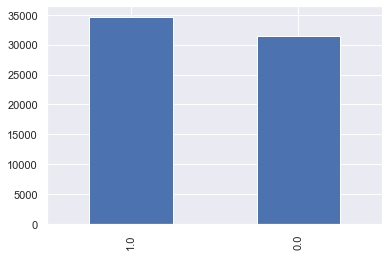

In [77]:
# ラベル不均衡でない
df_all["y"].value_counts().plot.bar()

game-ver


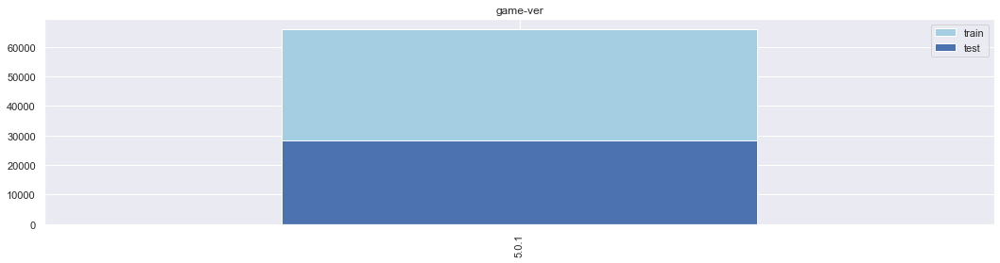

lobby-mode


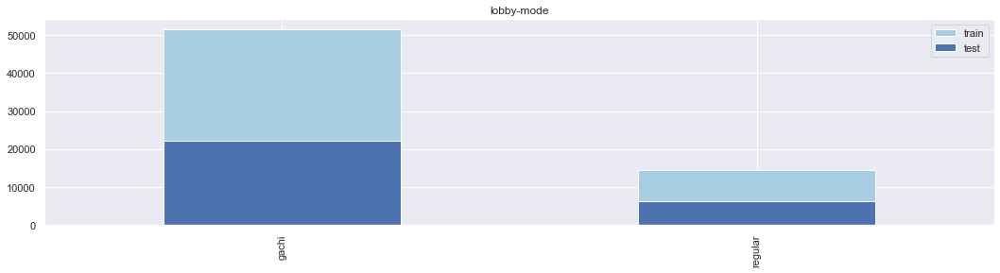

lobby


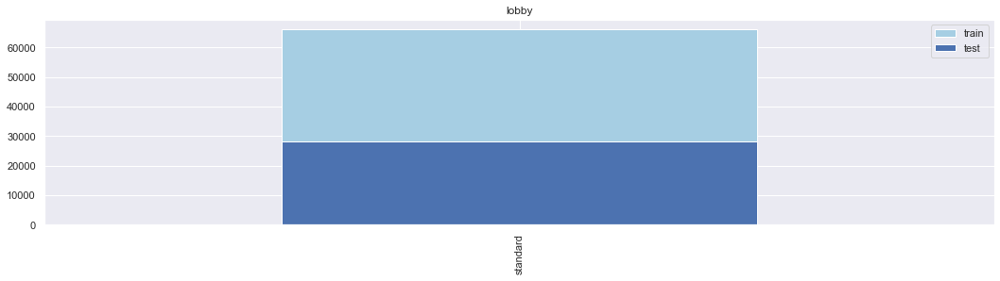

mode


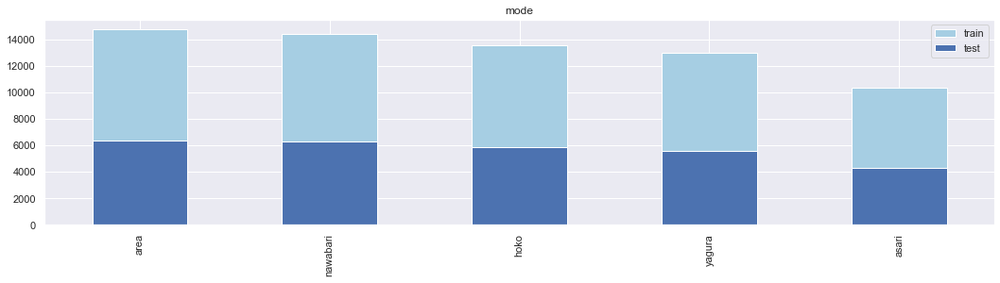

stage


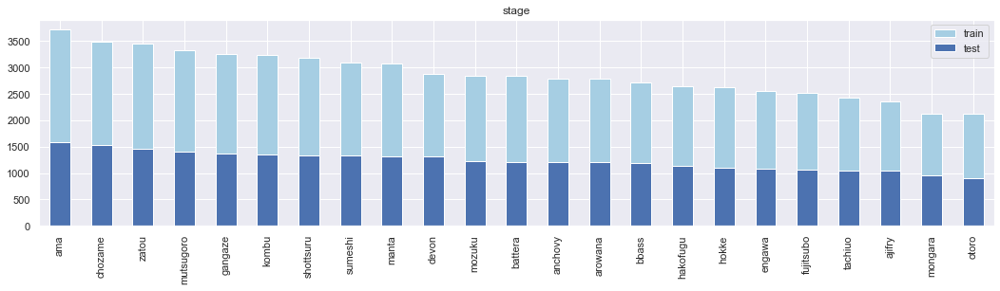

A1-weapon


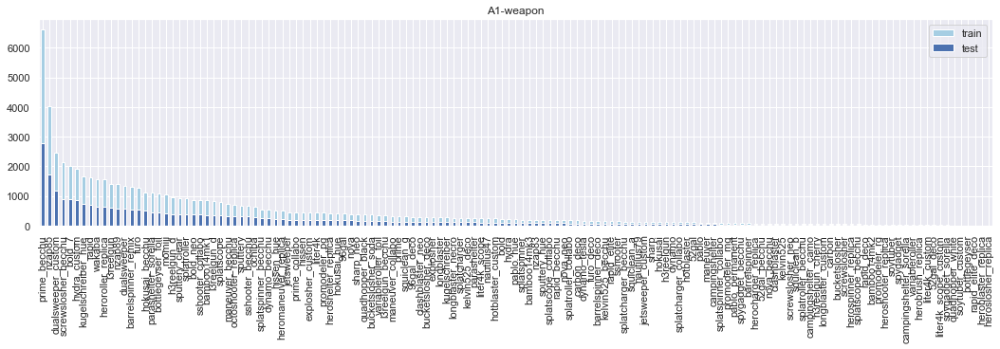

A1-rank


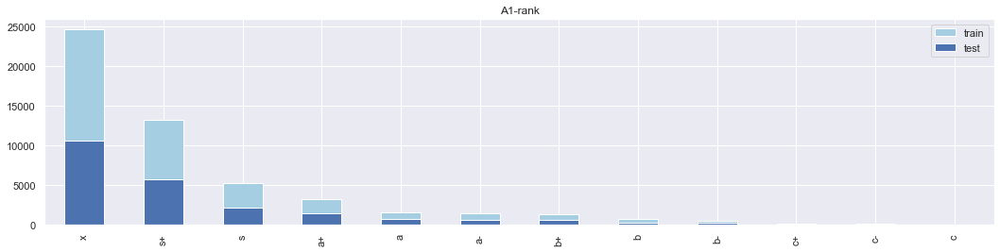

A2-weapon


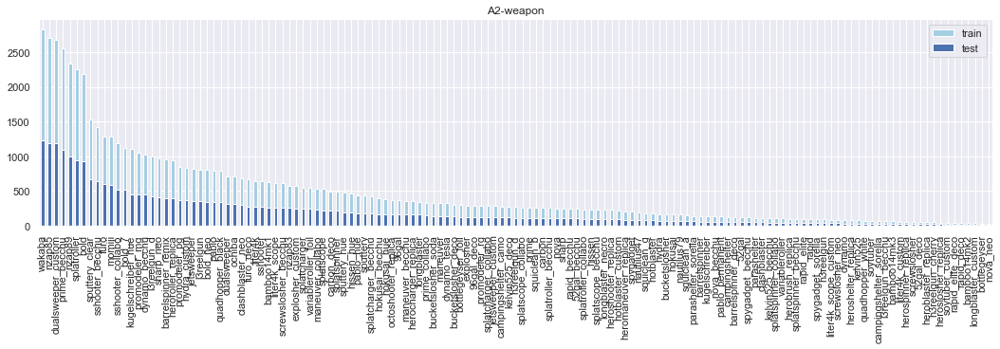

A2-rank


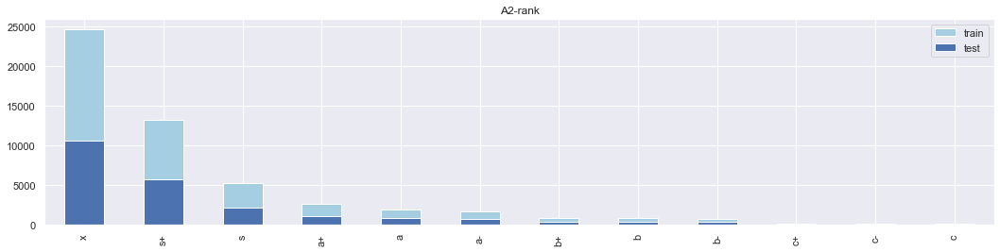

A3-weapon


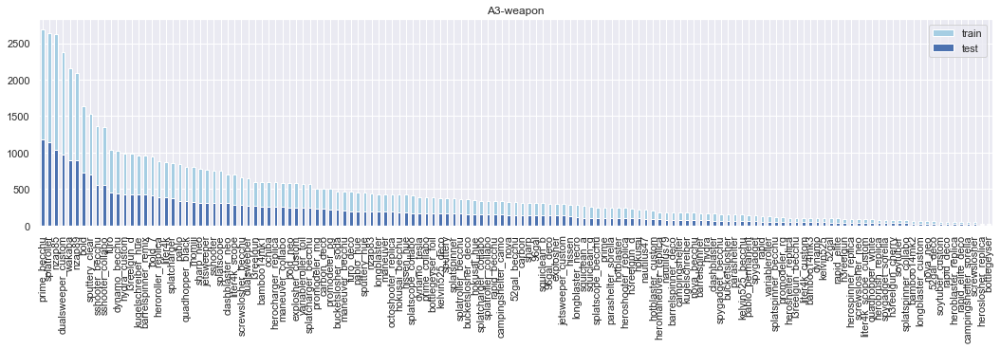

A3-rank


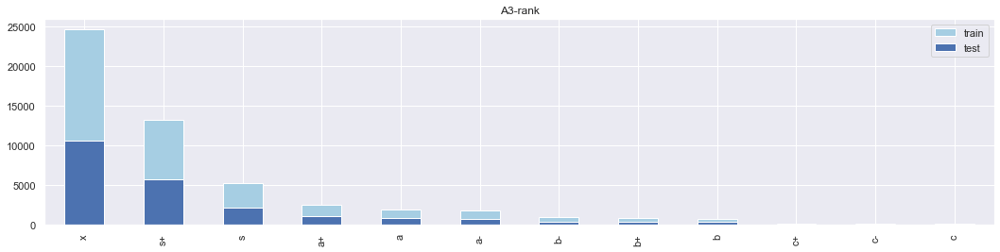

A4-weapon


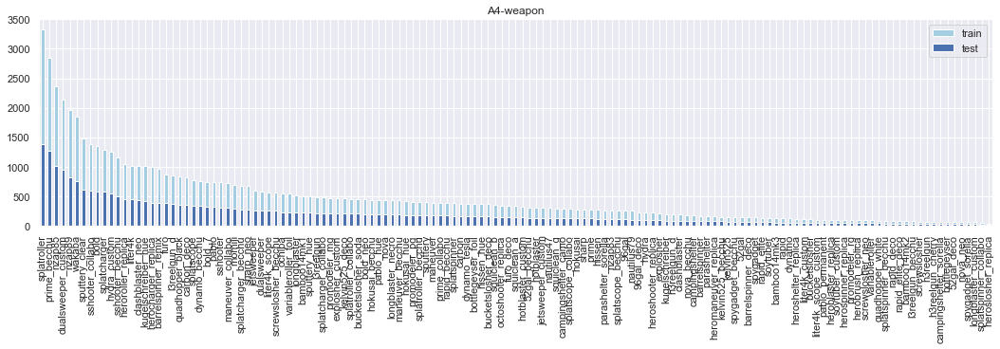

A4-rank


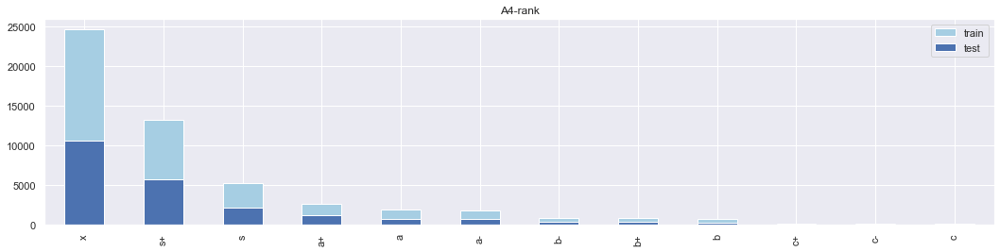

B1-weapon


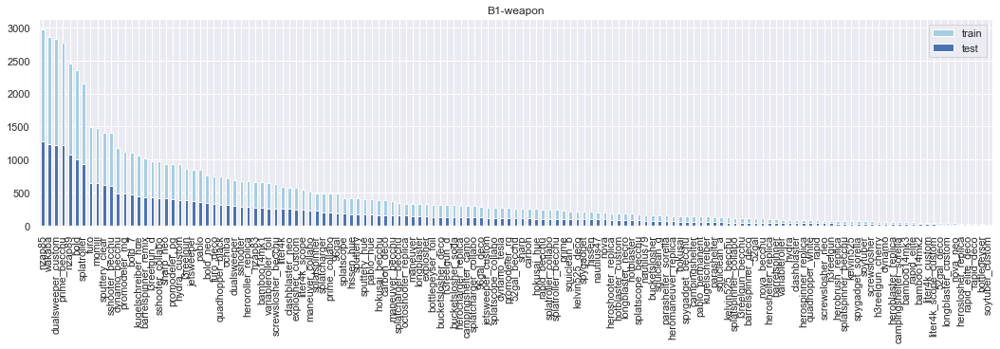

B1-rank


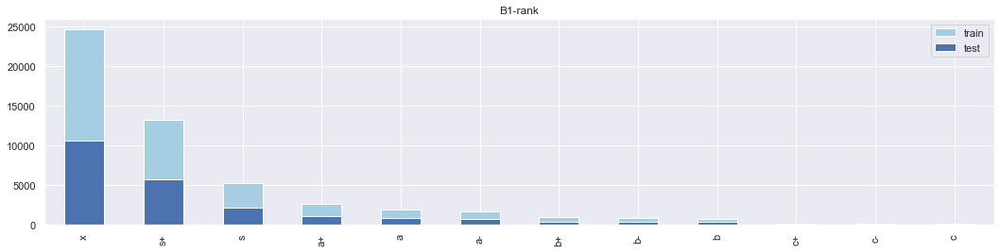

B2-weapon


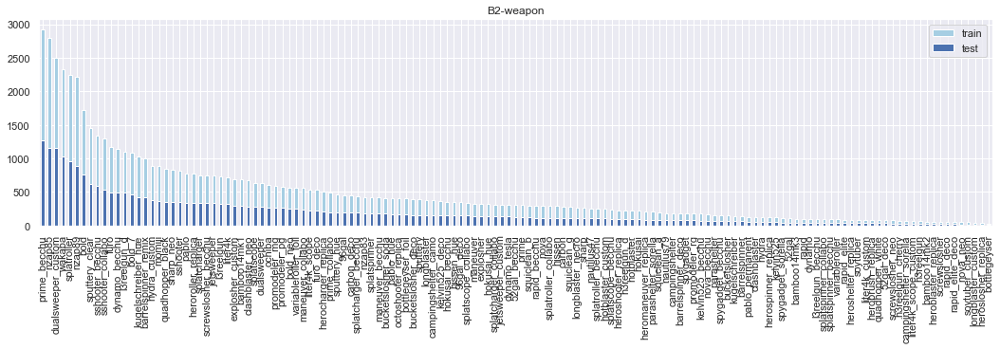

B2-rank


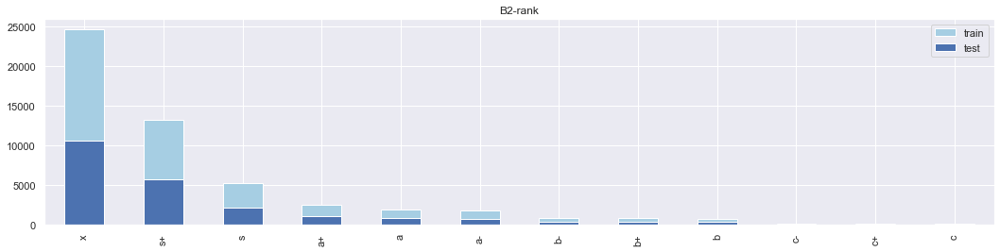

B3-weapon


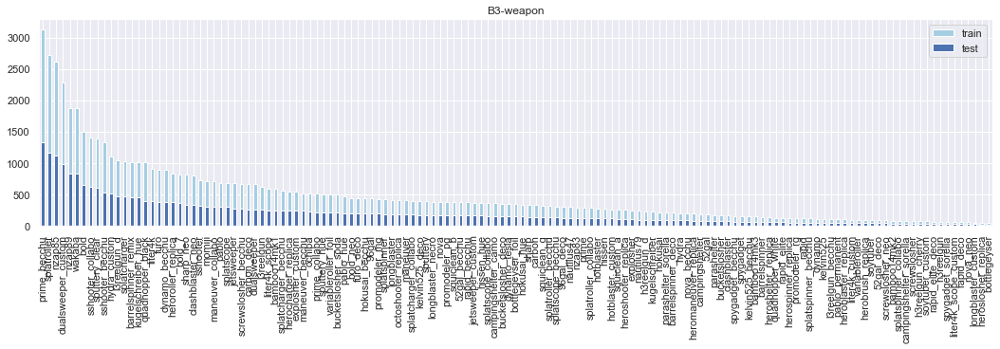

B3-rank


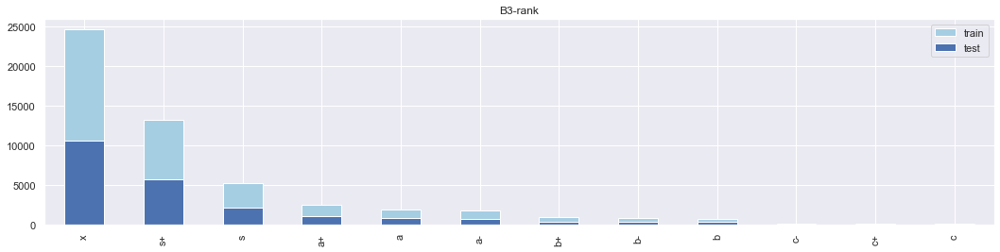

B4-weapon


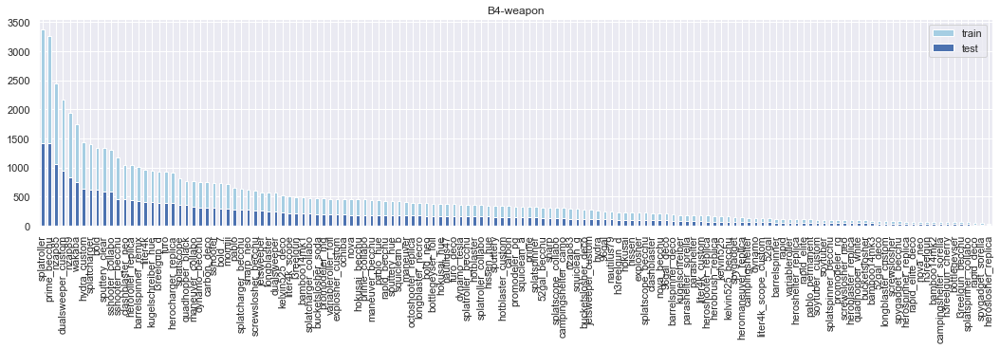

B4-rank


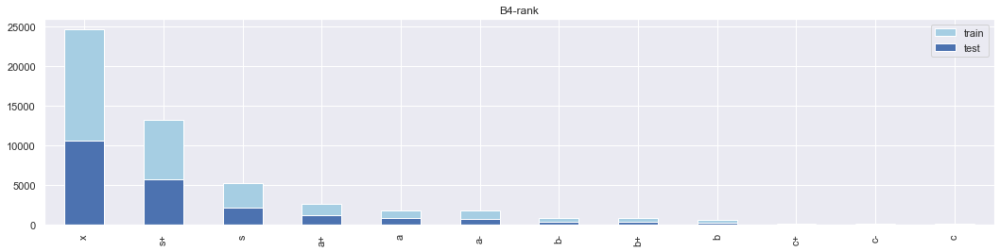

In [81]:
def compare_train_test_cate(col):
    """trainとtestでカテゴリ列の分布比較"""
    plt.figure(figsize=(18, 4))
    ax1 = train_df[col].value_counts().plot.bar(colormap='Paired', title=f"{col}")# , logy=True)
    test_df[col].value_counts().plot.bar(ax=ax1)#, logy=True)
    ax1.legend(["train", "test"]);
    plt.show()
    plt.clf()
    plt.close()
    
cate_cols = test_df.select_dtypes(include=["object", "category", "bool"]).columns.to_list()
cate_cols.remove("period")
for col in cate_cols:
    print(col)
    compare_train_test_cate(col)

A1-level


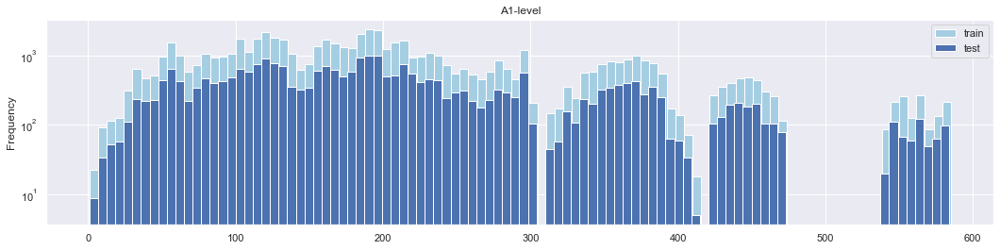

A2-level


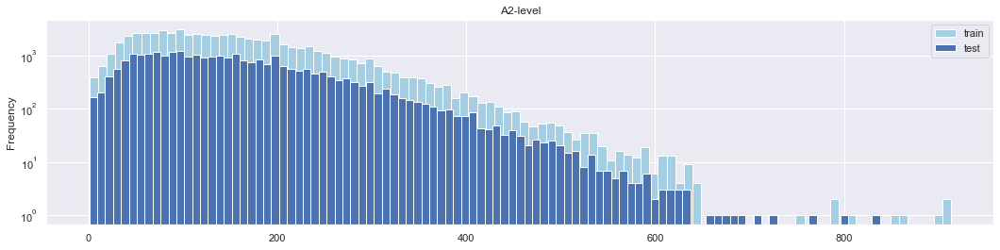

A3-level


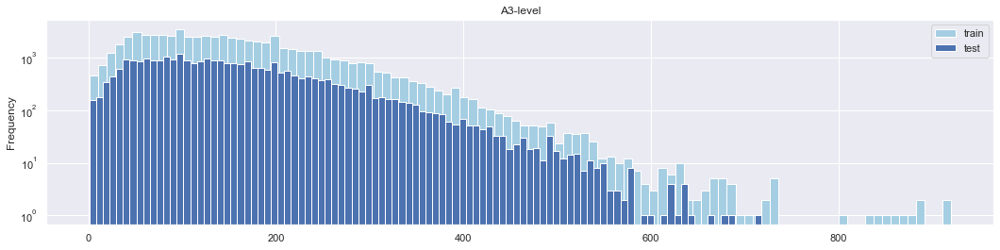

A4-level


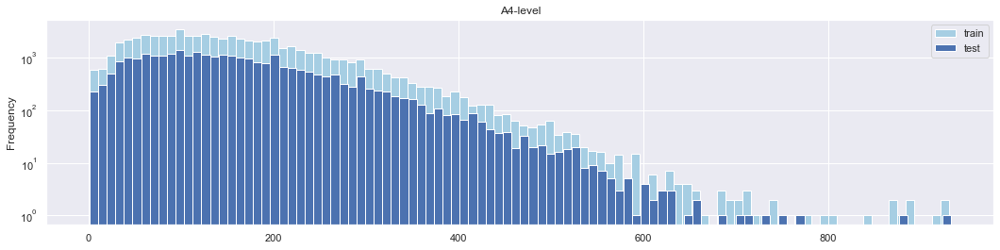

B1-level


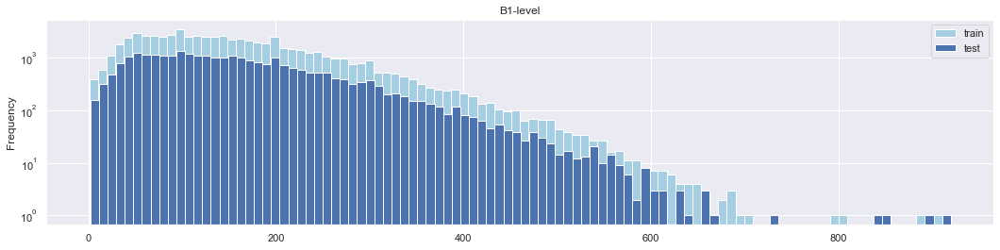

B2-level


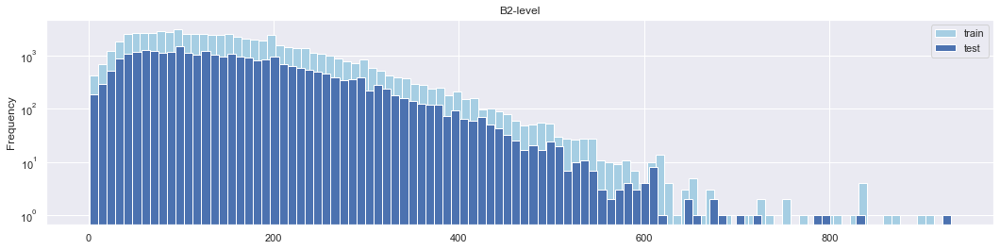

B3-level


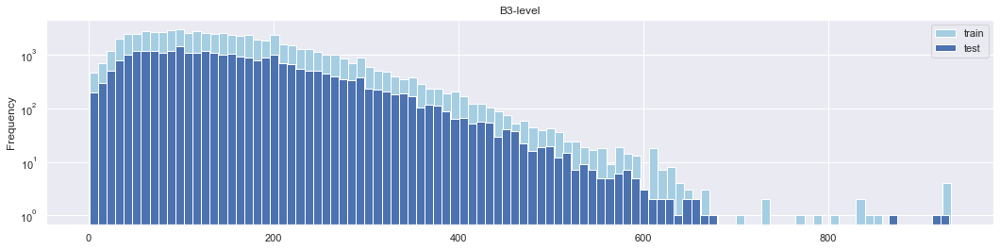

B4-level


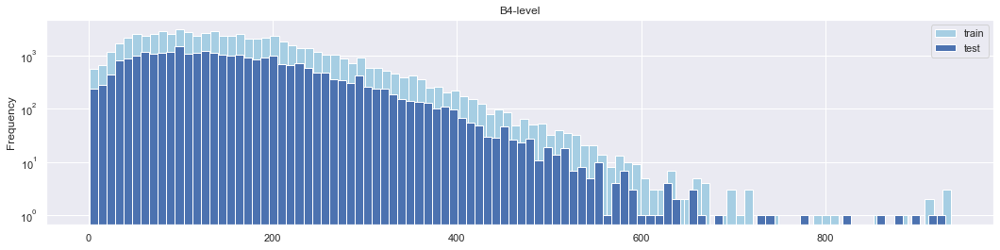

In [79]:
def compare_train_test_num(col):#, is_log=True):
    """trainとtestで数値列の分布比較"""
    plt.figure(figsize=(18, 4))
    #if is_log:
    #    # 対数化
    #    train_df[col] = np.log1p(train_df[col])
    #    test_df[col] = np.log1p(test_df[col])
    ax1 = train_df[col].plot.hist(colormap='Paired', title=f"{col}", bins=100, logy=True)
    test_df[col].plot.hist(ax=ax1, bins=100, logy=True)
    ax1.legend(["train", "test"]);
    plt.show()
    plt.clf()
    plt.close()
    
num_cols = test_df.select_dtypes(include=["int", "int32", "int64", "float", "float32", "float64"]).columns.to_list()
num_cols.remove("id")
for col in num_cols:
    print(col)
    compare_train_test_num(col)

In [84]:
df_all[df_all["A1-level"] > 500]

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,period,stage,y,year,month,day,dayofyear,dayofweek,weekend,hour
9,580,x,splatspinner_becchu,104.0,x,l3reelgun,157.0,x,wakaba,140.0,x,barrelspinner_remix,215,x,barrelspinner_remix,292.0,x,bucketslosher_soda,117.0,x,sshooter_becchu,224.0,x,prime,gachi,yagura,2019-12-19 16:00:00+00:00,gangaze,1.0,2019,12,19,353,3,0,16
43,552,x,sputtery,283.0,x,bold,174.0,x,heroroller_replica,351.0,x,bamboo14mk1,139,x,hydra_custom,228.0,x,pablo,411.0,x,bottlegeyser_foil,385.0,x,bold,gachi,hoko,2019-10-27 12:00:00+00:00,arowana,1.0,2019,10,27,300,6,1,12
74,549,x,sputtery,243.0,x,l3reelgun_d,250.0,x,jetsweeper_custom,104.0,x,longblaster_necro,312,x,hotblaster_custom,263.0,x,octoshooter_replica,179.0,x,screwslosher_becchu,159.0,x,dualsweeper_custom,gachi,hoko,2019-10-25 08:00:00+00:00,arowana,0.0,2019,10,25,298,4,0,8
125,565,NaN,l3reelgun,50.0,NaN,bold,38.0,NaN,nzap89,118.0,NaN,nova,116,NaN,nzap83,31.0,NaN,sshooter,184.0,NaN,bold_7,126.0,NaN,ochiba,regular,nawabari,2019-12-04 06:00:00+00:00,zatou,1.0,2019,12,4,338,2,0,6
233,566,NaN,l3reelgun,91.0,NaN,wakaba,43.0,NaN,momiji,197.0,NaN,liter4k,9,NaN,maneuver,165.0,NaN,momiji,24.0,NaN,promodeler_mg,162.0,NaN,splatscope,regular,nawabari,2019-12-04 10:00:00+00:00,engawa,1.0,2019,12,4,338,2,0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94278,567,NaN,splatscope_collabo,161.0,NaN,maneuver_becchu,65.0,NaN,liter4k,119.0,NaN,splatroller,272,NaN,l3reelgun,270.0,NaN,nzap89,64.0,NaN,hokusai_hue,216.0,NaN,sshooter_collabo,regular,nawabari,2019-12-05 08:00:00+00:00,anchovy,NaN,2019,12,5,339,3,0,8
94334,584,x,splatspinner_becchu,282.0,x,dynamo_becchu,293.0,x,bucketslosher_soda,231.0,x,splatroller_becchu,310,x,screwslosher_becchu,248.0,x,96gal,176.0,x,herocharger_replica,234.0,x,carbon_deco,gachi,hoko,2019-12-31 22:00:00+00:00,zatou,NaN,2019,12,31,365,1,0,22
94386,556,x,explosher,270.0,x,splatroller,257.0,x,96gal_deco,421.0,x,prime_becchu,80,x,prime_becchu,309.0,x,screwslosher_becchu,437.0,x,bamboo14mk1,214.0,x,variableroller_foil,gachi,yagura,2019-10-31 18:00:00+00:00,mozuku,NaN,2019,10,31,304,3,0,18
94434,555,x,explosher,226.0,x,prime_becchu,297.0,x,l3reelgun_d,154.0,x,sshooter_collabo,440,x,liter4k_scope,313.0,x,screwslosher_becchu,336.0,x,l3reelgun_d,368.0,x,prime_collabo,gachi,yagura,2019-10-31 04:00:00+00:00,anchovy,NaN,2019,10,31,304,3,0,4


In [105]:
# ランクちょっと違うユーザ同士もマッチングする
df_gachi = df_all[df_all["lobby-mode"] == "gachi"]
#display(df_gachi)
df_gachi[
    (df_gachi["A1-rank"] != df_gachi["A2-rank"])
    | (df_gachi["A1-rank"] != df_gachi["A3-rank"])
    | (df_gachi["A1-rank"] != df_gachi["A4-rank"])
    | (df_gachi["A1-rank"] != df_gachi["B1-rank"])
    | (df_gachi["A1-rank"] != df_gachi["B2-rank"])
    | (df_gachi["A1-rank"] != df_gachi["B3-rank"])
    | (df_gachi["A1-rank"] != df_gachi["B4-rank"])
    | (df_gachi["A2-rank"] != df_gachi["A3-rank"])
    | (df_gachi["A2-rank"] != df_gachi["A4-rank"])
    | (df_gachi["A2-rank"] != df_gachi["B1-rank"])
    | (df_gachi["A2-rank"] != df_gachi["B2-rank"])
    | (df_gachi["A2-rank"] != df_gachi["B3-rank"])
    | (df_gachi["A2-rank"] != df_gachi["B4-rank"])
    | (df_gachi["A3-rank"] != df_gachi["A4-rank"])
    | (df_gachi["A3-rank"] != df_gachi["B1-rank"])
    | (df_gachi["A3-rank"] != df_gachi["B2-rank"])
    | (df_gachi["A3-rank"] != df_gachi["B3-rank"])
    | (df_gachi["A3-rank"] != df_gachi["B4-rank"])
    | (df_gachi["A4-rank"] != df_gachi["B1-rank"])
    | (df_gachi["A4-rank"] != df_gachi["B2-rank"])
    | (df_gachi["A4-rank"] != df_gachi["B3-rank"])
    | (df_gachi["A4-rank"] != df_gachi["B4-rank"])
    | (df_gachi["B1-rank"] != df_gachi["B2-rank"])
    | (df_gachi["B1-rank"] != df_gachi["B3-rank"])
    | (df_gachi["B1-rank"] != df_gachi["B4-rank"])
    | (df_gachi["B2-rank"] != df_gachi["B3-rank"])
    | (df_gachi["B2-rank"] != df_gachi["B4-rank"])
    | (df_gachi["B3-rank"] != df_gachi["B4-rank"])
]

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,period,stage,y,year,month,day,dayofyear,dayofweek,weekend,hour
2,114,a-,nzap89,68.0,a,quadhopper_black,225.0,a,prime_becchu,107.0,a,jetsweeper,50,a-,bold_7,163.0,a+,nzap85,160.0,a-,prime_becchu,126.0,a,dualsweeper_custom,gachi,hoko,2019-12-25 14:00:00+00:00,ama,0.0,2019,12,25,359,2,0,14
6,27,b,dualsweeper,30.0,b-,maneuver_becchu,41.0,b,splatspinner,49.0,b-,heromaneuver_replica,50,b-,liter4k_scope,25.0,b-,furo_deco,34.0,b,maneuver_becchu,35.0,b-,maneuver_collabo,gachi,hoko,2019-11-10 14:00:00+00:00,hokke,1.0,2019,11,10,314,6,1,14
20,237,a+,nzap85,65.0,a+,52gal_becchu,209.0,a+,barrelspinner_remix,86.0,a,dualsweeper_custom,23,a-,prime_becchu,153.0,a+,nzap89,194.0,a+,clashblaster_neo,54.0,a-,liter4k,gachi,asari,2019-12-11 14:00:00+00:00,devon,0.0,2019,12,11,345,2,0,14
26,87,c+,sshooter_collabo,55.0,c,soytuber,60.0,c+,momiji,33.0,c+,screwslosher_becchu,21,c,dualsweeper_custom,26.0,c,furo,30.0,c,variableroller_foil,17.0,c-,nzap89,gachi,yagura,2019-12-17 16:00:00+00:00,mozuku,0.0,2019,12,17,351,1,0,16
46,118,a+,bucketslosher_soda,217.0,a+,wakaba,121.0,a+,nzap85,64.0,a+,nzap85,242,a,momiji,159.0,a+,furo,134.0,a+,nzap85,198.0,a+,splatroller_collabo,gachi,hoko,2019-10-27 12:00:00+00:00,zatou,1.0,2019,10,27,300,6,1,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94415,33,a+,longblaster,170.0,a+,sputtery_clear,106.0,a,hydra_custom,84.0,a+,explosher,282,a+,liter4k_scope,82.0,a+,dynamo_becchu,68.0,a+,nzap89,33.0,a+,hydra_custom,gachi,area,2019-10-17 14:00:00+00:00,mongara,NaN,2019,10,17,290,3,0,14
94421,90,a-,nzap89,70.0,a,variableroller_foil,138.0,a+,octoshooter_replica,78.0,a-,bold,186,a+,bold,76.0,a-,nzap89,335.0,a,screwslosher_becchu,111.0,a+,sshooter_collabo,gachi,asari,2019-10-13 10:00:00+00:00,ama,NaN,2019,10,13,286,6,1,10
94427,74,a,sharp_neo,72.0,a,explosher_custom,370.0,a+,nzap83,207.0,a+,variableroller_foil,54,a,nzap89,50.0,a-,barrelspinner_remix,56.0,a+,prime_becchu,36.0,a,heroroller_replica,gachi,asari,2019-10-14 06:00:00+00:00,fujitsubo,NaN,2019,10,14,287,0,0,6
94428,105,b+,kugelschreiber_hue,43.0,b-,rapid,61.0,b-,dualsweeper_custom,167.0,b,carbon_deco,40,b-,liter4k_scope,67.0,b-,longblaster_necro,69.0,b+,ochiba,144.0,b,variableroller_foil,gachi,area,2019-10-27 00:00:00+00:00,manta,NaN,2019,10,27,300,6,1,0


In [14]:
def check_countplot_col_y(df, cate_col):
    """ラベルとカテゴリ列のカウント数plot"""
    target = "y"
    for i, _df in df.groupby(cate_col):
        m = _df.iloc[0][cate_col]
        _df = _df.rename(columns={target: f"{m}_{target}"})
        sns.countplot(_df[f"{m}_{target}"])
        plt.show()
        plt.clf()
        plt.close()

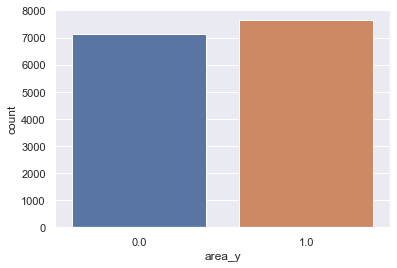

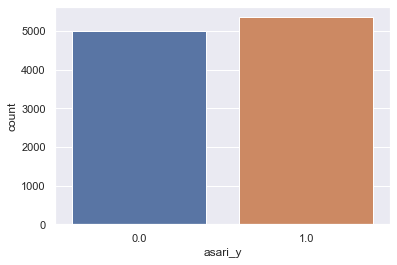

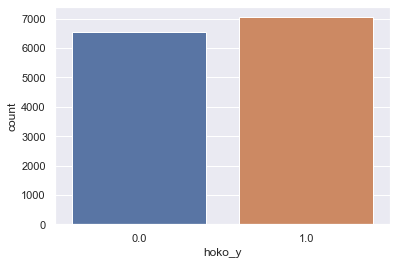

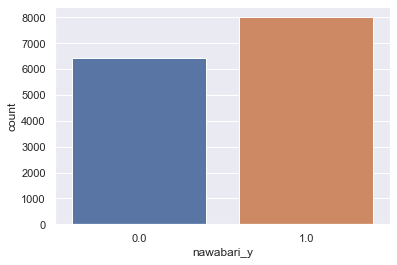

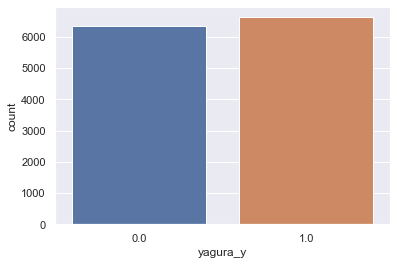

In [15]:
# バトルモードで勝敗の差若干ある
check_countplot_col_y(df_all, "mode")

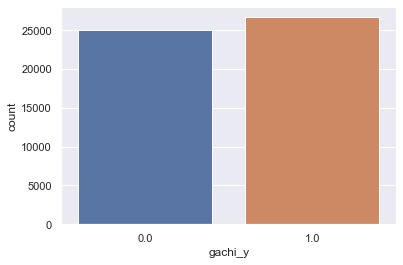

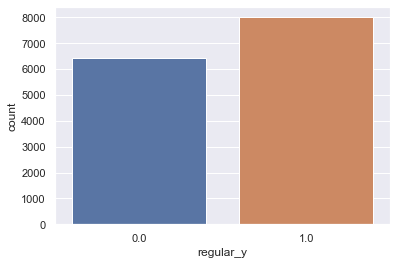

In [16]:
# lobby-modeで勝敗の差若干ある。
# セグメンテーションしようかな
check_countplot_col_y(df_all, "lobby-mode")

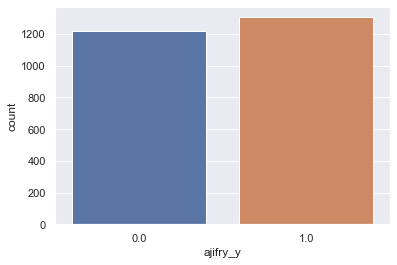

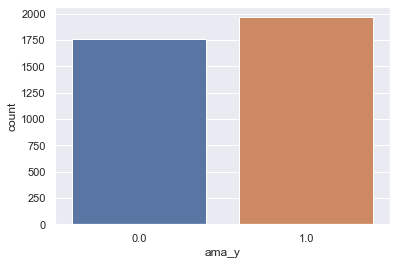

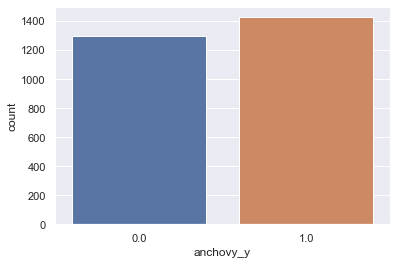

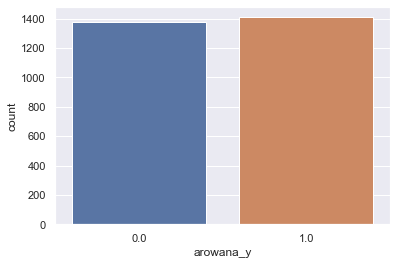

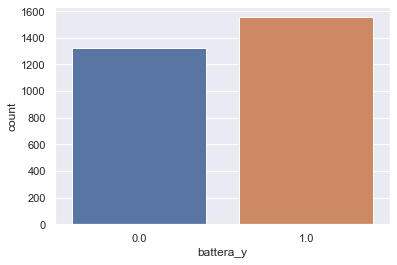

...

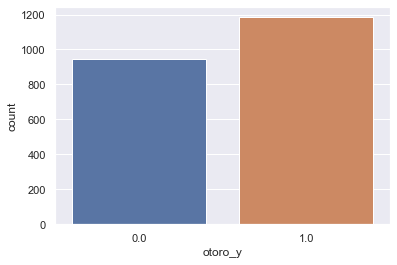

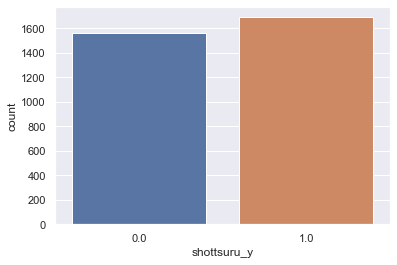

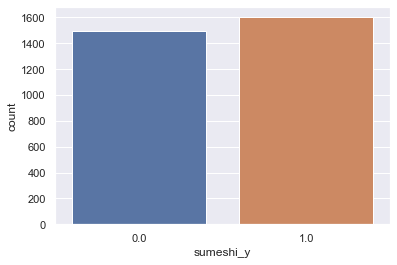

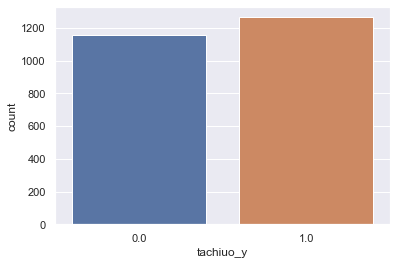

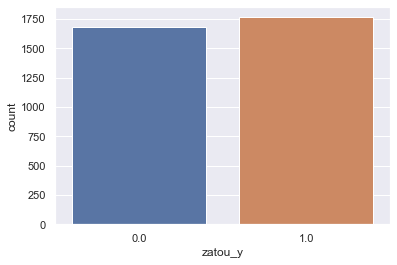

In [17]:
# stageで勝敗の差若干ある
check_countplot_col_y(df_all, "stage")

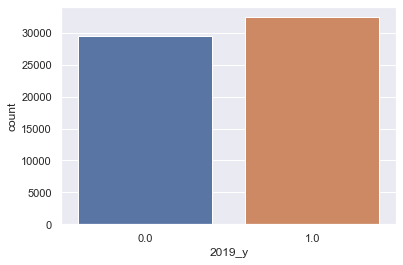

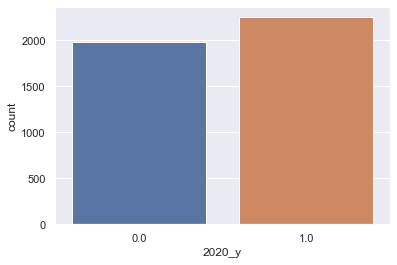

In [18]:
# yearで勝敗の差若干ある。期間は2019-2020年
check_countplot_col_y(df_all, "year")

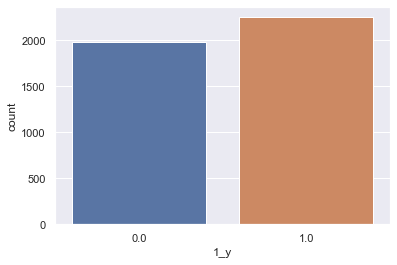

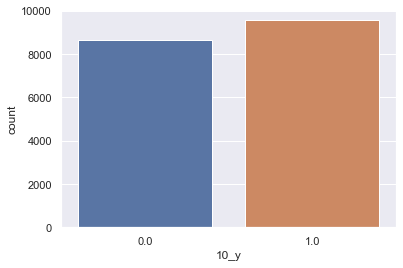

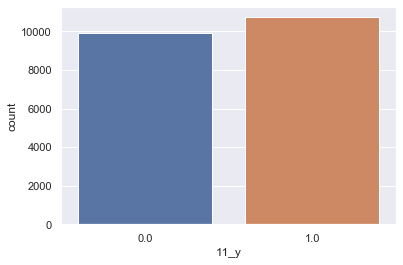

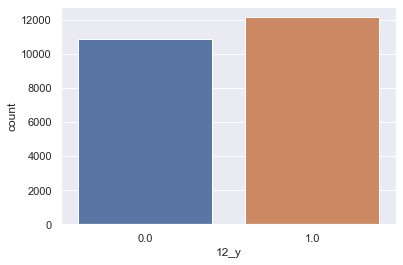

In [19]:
# monthで勝敗の差若干ある。期間は2019/10-2020/01
check_countplot_col_y(df_all, "month")

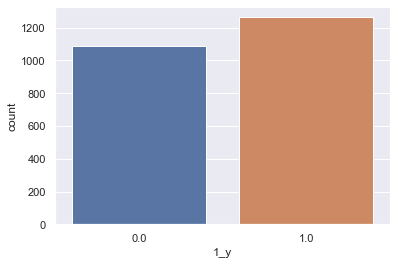

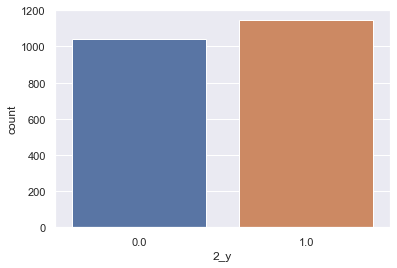

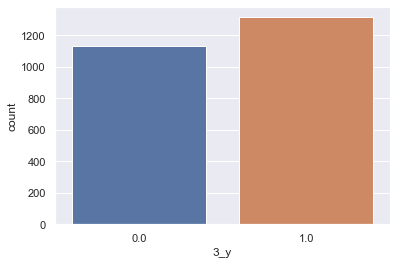

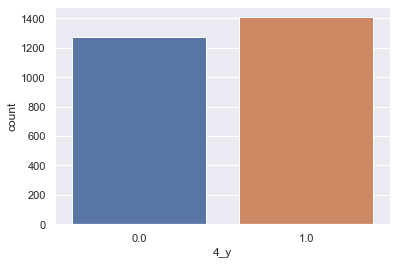

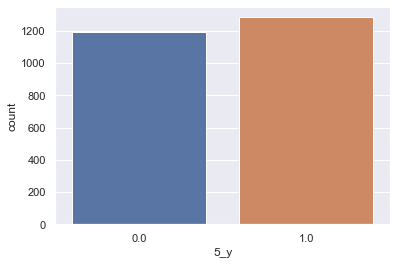

...

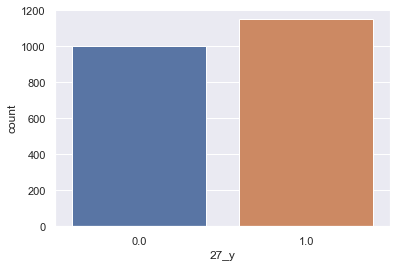

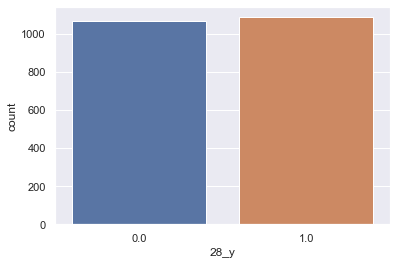

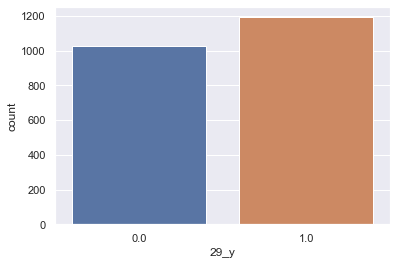

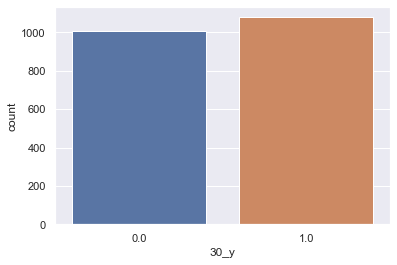

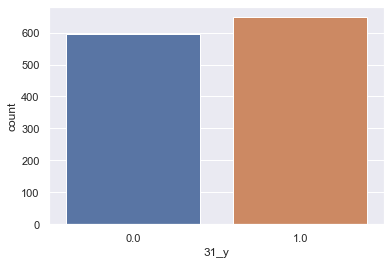

In [20]:
# dayで勝敗の差若干ある。16dayだけy=0.0のほうが多い
check_countplot_col_y(df_all, "day")

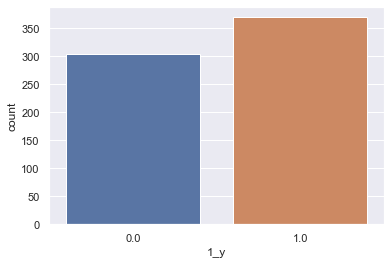

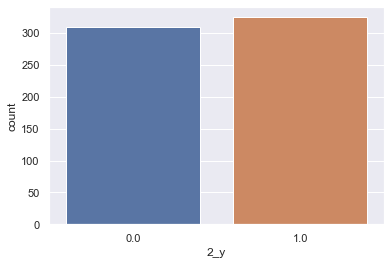

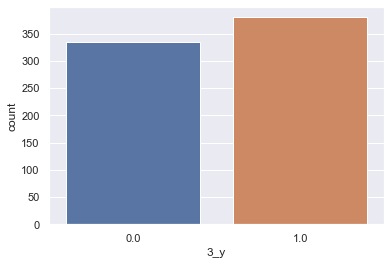

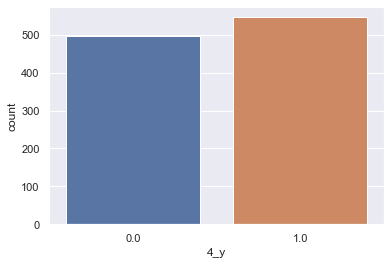

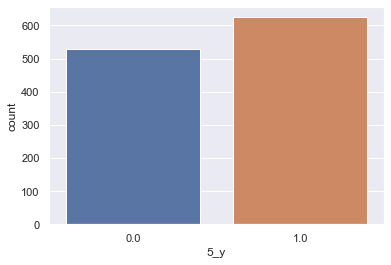

...

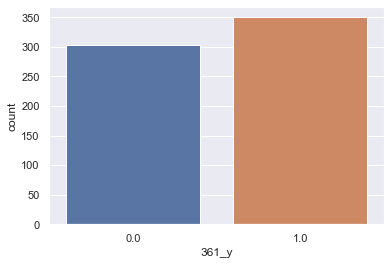

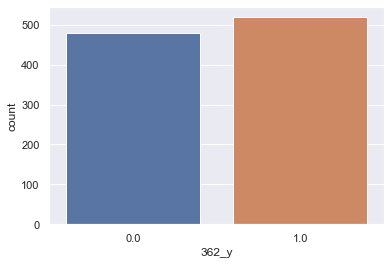

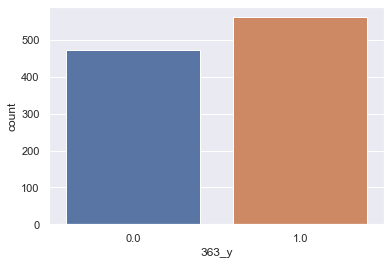

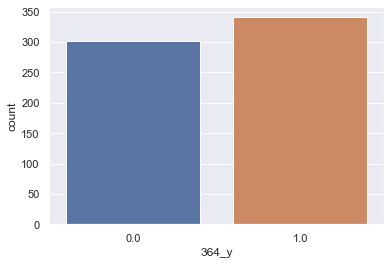

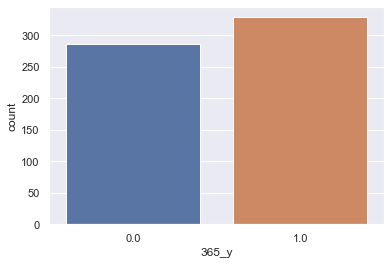

In [21]:
# dayofyearで勝敗の差若干ある。6dayofyearだけ異様にデータ数少ない。メンテとかはいったんかな？
check_countplot_col_y(df_all, "dayofyear")

In [22]:
# 6dayofyearのレコード。hour0の時間しかないので多分メンテ日だな
df_all[df_all["dayofyear"] == 6] 

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,period,stage,y,year,month,day,dayofyear,dayofweek,weekend,hour
7009,110,x,kelvin525_deco,198.0,x,spygadget,100.0,x,bold,337.0,x,pablo_permanent,230,x,kugelschreiber_hue,104.0,x,clashblaster_neo,89.0,x,pablo,138.0,x,sputtery_hue,gachi,asari,2020-01-06 00:00:00+00:00,anchovy,0.0,2020,1,6,6,0,0,0
14345,110,x,kelvin525_deco,173.0,x,hokusai_hue,82.0,x,prime_becchu,96.0,x,pablo,62,x,nzap85,220.0,x,hokusai_hue,205.0,x,liter4k,81.0,x,splatroller_collabo,gachi,asari,2020-01-06 00:00:00+00:00,gangaze,1.0,2020,1,6,6,0,0,0
17256,76,NaN,bold_7,44.0,NaN,dualsweeper,182.0,NaN,liter4k,99.0,NaN,longblaster_custom,25,NaN,pablo,107.0,NaN,nzap85,78.0,NaN,splatcharger_becchu,127.0,NaN,sputtery_clear,regular,nawabari,2020-01-06 00:00:00+00:00,chozame,0.0,2020,1,6,6,0,0,0
21012,401,x,furo,194.0,x,nzap89,73.0,x,96gal,105.0,x,splatspinner,102,x,hotblaster,241.0,x,campingshelter_camo,544.0,x,h3reelgun,146.0,x,splatcharger_becchu,gachi,asari,2020-01-06 00:00:00+00:00,anchovy,0.0,2020,1,6,6,0,0,0
22965,111,x,kelvin525_deco,97.0,x,sshooter,307.0,x,prime_becchu,316.0,x,pablo,340,x,maneuver_becchu,153.0,x,sshooter_collabo,42.0,x,bottlegeyser_foil,78.0,x,hotblaster_custom,gachi,asari,2020-01-06 00:00:00+00:00,gangaze,0.0,2020,1,6,6,0,0,0
32030,103,s+,longblaster,69.0,s+,maneuver_becchu,219.0,s+,splatspinner_collabo,45.0,s+,carbon,425,s+,sshooter_becchu,64.0,s+,splatroller,105.0,s+,clashblaster_neo,149.0,s+,kugelschreiber_hue,gachi,asari,2020-01-06 00:00:00+00:00,anchovy,1.0,2020,1,6,6,0,0,0
32038,76,NaN,sharp,107.0,NaN,nzap85,78.0,NaN,splatcharger_becchu,99.0,NaN,hydra,44,NaN,dualsweeper,182.0,NaN,liter4k,127.0,NaN,sputtery_clear,25.0,NaN,pablo,regular,nawabari,2020-01-06 00:00:00+00:00,mozuku,1.0,2020,1,6,6,0,0,0
34031,103,s+,prime,52.0,s+,splatroller,130.0,s+,nzap89,68.0,s+,explosher,149,s+,hokusai_hue,73.0,s+,maneuver,117.0,s+,splatcharger,205.0,s+,nzap89,gachi,asari,2020-01-06 00:00:00+00:00,anchovy,0.0,2020,1,6,6,0,0,0
34757,76,NaN,sharp,44.0,NaN,dualsweeper,127.0,NaN,sputtery_clear,99.0,NaN,hydra,96,NaN,nzap83,182.0,NaN,liter4k,78.0,NaN,squiclean_b,218.0,NaN,splatroller_collabo,regular,nawabari,2020-01-06 00:00:00+00:00,chozame,0.0,2020,1,6,6,0,0,0
44392,401,x,furo,319.0,x,sshooter_collabo,266.0,x,dualsweeper_custom,228.0,x,longblaster,155,x,rapid_becchu,176.0,x,splatroller_becchu,78.0,x,prime_becchu,196.0,x,sshooter,gachi,asari,2020-01-06 00:00:00+00:00,anchovy,0.0,2020,1,6,6,0,0,0


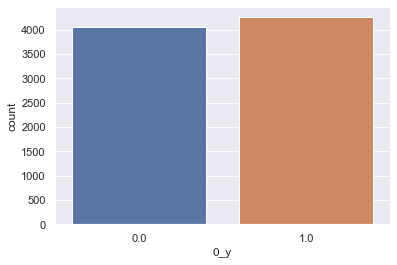

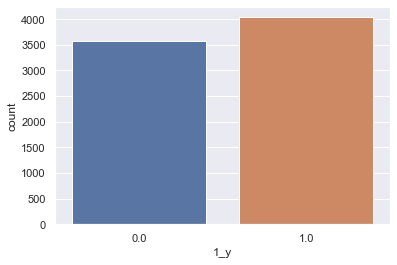

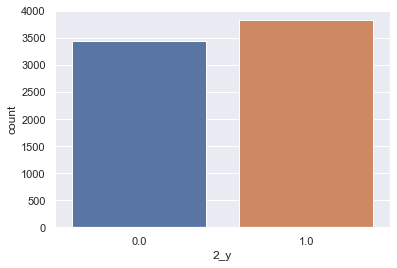

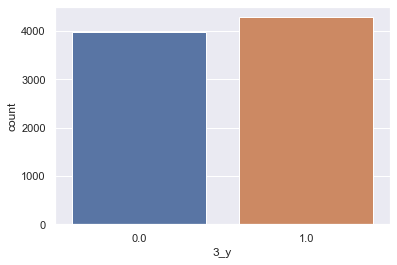

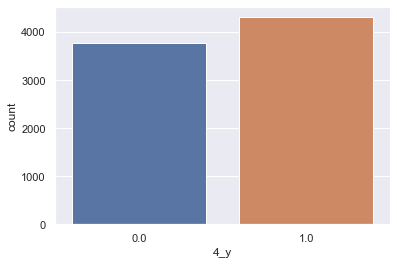

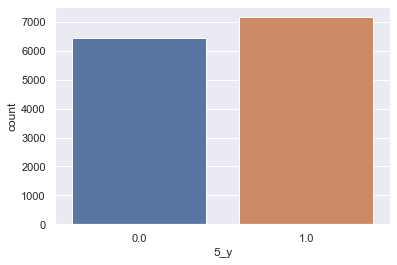

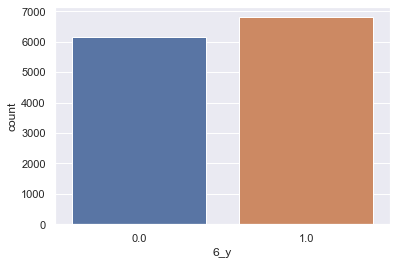

In [23]:
# dayofweek。曜日による勝敗の比の違いはない。週末は利用者増える
check_countplot_col_y(df_all, "dayofweek")

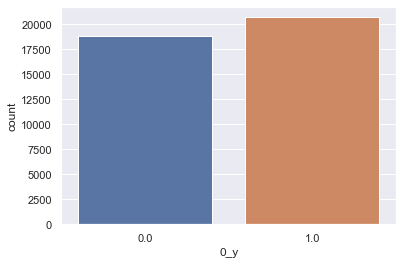

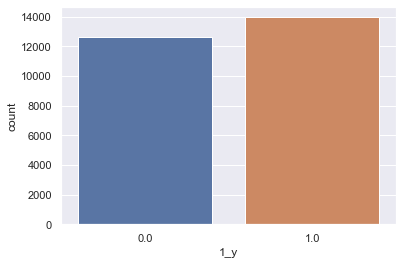

In [24]:
# weekend。週末による勝敗の比の違いはない。週末は利用者多いな
check_countplot_col_y(df_all, "weekend")

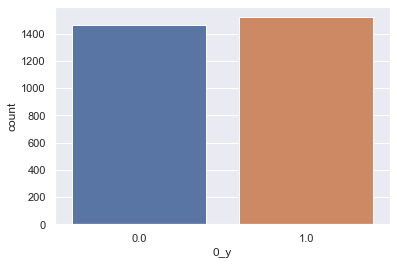

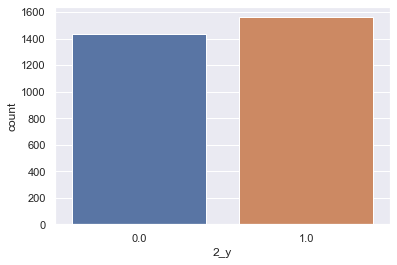

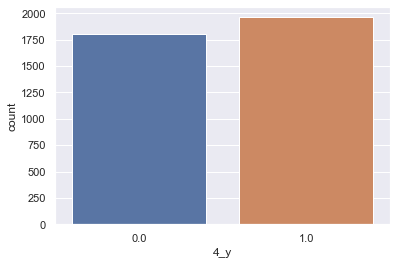

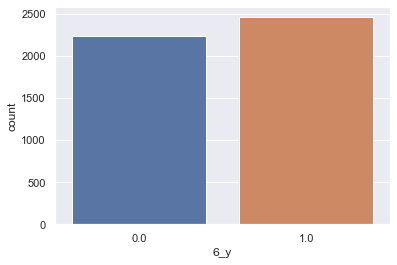

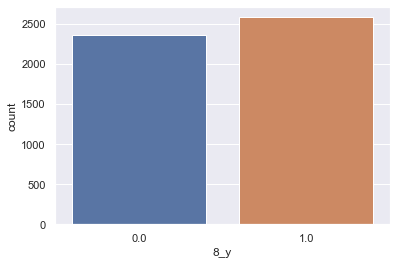

...

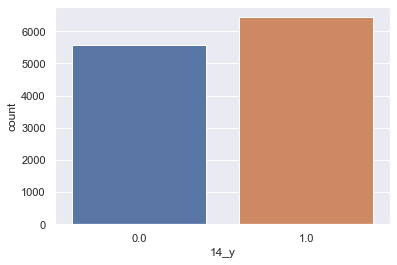

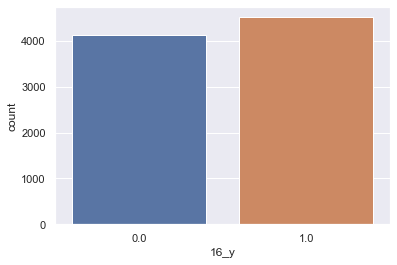

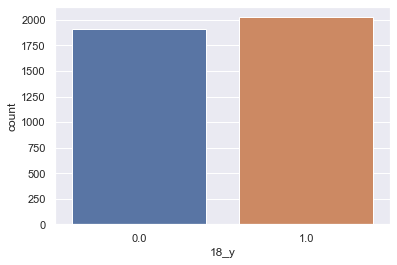

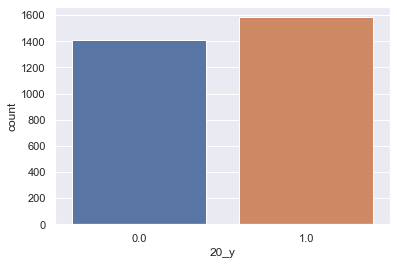

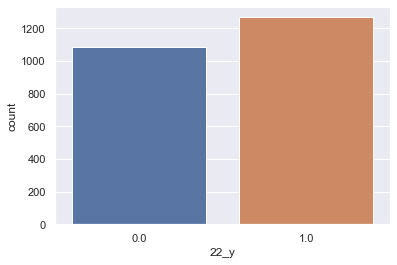

In [25]:
# hourで勝敗の差若干ある。2時間おきに集計してるみたい。14時の時間帯が利用ピーク
check_countplot_col_y(df_all, "hour")

- この時間だから勝ちやすいとかあるのかな。。。強い人がA,Bのどっちかのチーム偏る時間や日があるとか？

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 35307 entries, 2019-12-14 06:00:00+00:00 to 2019-10-12 10:00:00+00:00
Data columns (total 44 columns):
A1-level          35307 non-null int64
A1-rank           35307 non-null object
A1-weapon         35307 non-null object
A2-level          35307 non-null float64
A2-rank           35307 non-null object
A2-weapon         35307 non-null object
A3-level          35307 non-null float64
A3-rank           35307 non-null object
A3-weapon         35307 non-null object
A4-level          35279 non-null float64
A4-rank           35279 non-null object
A4-weapon         35279 non-null object
B1-level          35307 non-null int64
B1-rank           35307 non-null object
B1-weapon         35307 non-null object
B2-level          35307 non-null float64
B2-rank           35307 non-null object
B2-weapon         35307 non-null object
B3-level          35307 non-null float64
B3-rank           35307 non-null object
B3-weapon         35307 non-null object
B

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,period,stage,y,year,month,day,dayofyear,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p,id
period,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-12-14 06:00:00+00:00,299,x,bold_7,97,x,hissen_hue,96,x,h3reelgun_d,136,x,splatroller,101,x,furo,45,x,sputtery_hue,246,x,bucketslosher_soda,160,x,wakaba,gachi,hoko,2019-12-14 06:00:00+00:00,chozame,1,2019,12,14,348,5,1,6,4.58497,4.57471,4.91998,4.62497,3.82864,5.50939,5.0814,4
2019-11-28 08:00:00+00:00,443,x,splatspinner,373,x,liter4k_scope,68,x,splatcharger_becchu,109,x,nova,267,x,heroroller_replica,249,x,kugelschreiber_hue,416,x,splatscope_collabo,200,x,prime_becchu,gachi,area,2019-11-28 08:00:00+00:00,chozame,1,2019,11,28,332,3,0,8,5.92426,4.23411,4.70048,5.59099,5.52146,6.03309,5.3033,8
2019-12-19 16:00:00+00:00,580,x,splatspinner_becchu,104,x,l3reelgun,157,x,wakaba,140,x,barrelspinner_remix,215,x,barrelspinner_remix,292,x,bucketslosher_soda,117,x,sshooter_becchu,224,x,prime,gachi,yagura,2019-12-19 16:00:00+00:00,gangaze,1,2019,12,19,353,3,0,16,4.65396,5.0626,4.94876,5.37528,5.68017,4.77068,5.4161,9
2019-10-18 08:00:00+00:00,116,x,prime_becchu,202,x,bold,233,x,wakaba,70,x,splatroller,142,x,bold_7,143,x,splatroller,177,x,sharp_neo,213,x,hissen,gachi,hoko,2019-10-18 08:00:00+00:00,mutsugoro,1,2019,10,18,291,4,0,8,5.31321,5.45532,4.26268,4.96284,4.96981,5.18178,5.36598,11
2019-12-09 10:00:00+00:00,297,x,barrelspinner_remix,188,x,bamboo14mk1,175,x,bold,138,x,liter4k,193,x,bamboo14mk1,262,x,hydra_custom,194,x,bottlegeyser_foil,202,x,squiclean_b,gachi,asari,2019-12-09 10:00:00+00:00,ama,0,2019,12,9,343,0,0,10,5.24175,5.17048,4.93447,5.26786,5.57215,5.273,5.31321,12


,count,mean,std,min,25%,50%,75%,max
A1-level,35307,267.386,114.854,37,178,260,354,585
A2-level,35307,207.925,94.3688,21,141,196,260,913
A3-level,35307,204.578,93.9335,17,138,192,257,920
A4-level,35279,205.924,93.4405,16,139,194,259,933
B1-level,35307,210.429,96.2212,17,142,198,264,920
B2-level,35307,204.408,93.978,17,137,193,257,931
B3-level,35307,203.666,93.9099,16,137,192,257,933
B4-level,35266,206.444,92.9395,19,140,196,258,936
y,24724,0.51816,0.49968,0,0,1,1,1
year,35307,2019.07,0.24713,2019,2019,2019,2019,2020


,Feature,Unique values,Most frequent item,Freuquence of most frequent item,Percentage of missing values,Percentage of values in the biggest category,Type
28,y,2,1,12811,29.9742,36.2846,float64
22,B4-rank,1,x,35266,0.116124,99.8839,object
21,B4-level,589,198,663,0.116124,1.87781,float64
23,B4-weapon,139,prime_becchu,1923,0.116124,5.44651,object
42,B4-level_log1p,589,5.2933,663,0.116124,1.87781,float64
38,A4-level_log1p,597,5.2933,701,0.0793044,1.98544,float64
9,A4-level,597,198,701,0.0793044,1.98544,float64
10,A4-rank,1,x,35279,0.0793044,99.9207,object
11,A4-weapon,139,prime_becchu,1608,0.0793044,4.55434,object
40,B2-level_log1p,595,5.2933,684,0,1.93729,float64


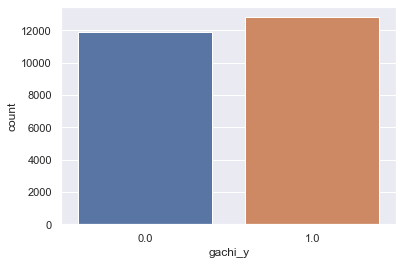

In [83]:
# rank="x"は特別なウデマエみたい
# https://pcfreebook.com/article/spla2-udemaex.html
# ウデマエXとは、スプラトゥーンのガチマッチにおける階級の最高位（最高ランク）です。
# S+9のときにウデマエゲージをMAXにすると(S+10以上にする)、ウデマエXへと昇格します。
# ウデマエXの状態では、ガチマッチはウデマエX同士でしかマッチングしなくなり、Xパワーと呼ばれるものを賭けて戦ういわゆる「レート戦」をすることになります。

# 実際、rank=xのレコードはほかのrankとマッチングしていない
df_all_x = df_all[df_all["A1-rank"] == "x"]
df_info(df_all_x)
check_countplot_col_y(df_all_x, "lobby-mode")

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3216 entries, 2019-11-10 14:00:00+00:00 to 2019-10-27 00:00:00+00:00
Data columns (total 44 columns):
A1-level          3216 non-null int64
A1-rank           3216 non-null object
A1-weapon         3216 non-null object
A2-level          3216 non-null float64
A2-rank           3216 non-null object
A2-weapon         3216 non-null object
A3-level          3216 non-null float64
A3-rank           3216 non-null object
A3-weapon         3216 non-null object
A4-level          3214 non-null float64
A4-rank           3214 non-null object
A4-weapon         3214 non-null object
B1-level          3216 non-null int64
B1-rank           3216 non-null object
B1-weapon         3216 non-null object
B2-level          3216 non-null float64
B2-rank           3216 non-null object
B2-weapon         3216 non-null object
B3-level          3216 non-null float64
B3-rank           3216 non-null object
B3-weapon         3216 non-null object
B4-level          3210 

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,period,stage,y,year,month,day,dayofyear,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p,id
period,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-11-10 14:00:00+00:00,27,b,dualsweeper,30,b-,maneuver_becchu,41,b,splatspinner,49,b-,heromaneuver_replica,50,b-,liter4k_scope,25,b-,furo_deco,34,b,maneuver_becchu,35,b-,maneuver_collabo,gachi,hoko,2019-11-10 14:00:00+00:00,hokke,1,2019,11,10,314,6,1,14,3.43399,3.73767,3.91202,3.93183,3.2581,3.55535,3.58352,6
2020-01-01 08:00:00+00:00,90,b+,sshooter_collabo,81,b-,splatcharger,30,b-,promodeler_pg,20,b-,liter4k,71,b+,sharp_neo,51,b-,splatscope_collabo,48,b+,splatroller,99,b,jetsweeper,gachi,area,2020-01-01 08:00:00+00:00,chozame,0,2020,1,1,1,2,0,8,4.40672,3.43399,3.04452,4.27667,3.95124,3.89182,4.60517,153
2019-10-27 22:00:00+00:00,60,b-,maneuver_collabo,14,b-,quadhopper_black,39,b,heromaneuver_replica,22,b+,sshooter_collabo,51,b+,maneuver_becchu,36,b+,maneuver,24,b-,prime_becchu,45,b+,heroshooter_replica,gachi,asari,2019-10-27 22:00:00+00:00,fujitsubo,1,2019,10,27,300,6,1,22,2.70805,3.68888,3.13549,3.95124,3.61092,3.21888,3.82864,157
2019-10-11 12:00:00+00:00,97,b+,kugelschreiber_hue,62,b+,bold,30,b-,squiclean_b,90,b,nova,51,b+,bold,36,b-,promodeler_pg,57,b-,splatcharger,65,b+,nautilus47,gachi,asari,2019-10-11 12:00:00+00:00,otoro,0,2019,10,11,284,4,0,12,4.14313,3.43399,4.51086,3.95124,3.61092,4.06044,4.18965,333
2019-12-27 14:00:00+00:00,135,b+,bold_neo,48,b-,promodeler_pg,49,b-,variableroller_foil,66,b-,kugelschreiber,164,b,furo,307,b,heromaneuver_replica,161,b,pablo_hue,48,b-,sshooter_becchu,gachi,hoko,2019-12-27 14:00:00+00:00,mozuku,0,2019,12,27,361,4,0,14,3.89182,3.91202,4.20469,5.10595,5.7301,5.0876,3.89182,336


,count,mean,std,min,25%,50%,75%,max
A1-level,3216,93.0535,36.4941,12,76,103,123,205
A2-level,3216,68.1632,46.7058,10,39,55,83,418
A3-level,3216,65.2867,47.8123,10,36,53,77,475
A4-level,3214,75.9017,58.2556,10,39,59,94.75,734
B1-level,3216,71.838,54.5362,11,38,55.5,86,652
B2-level,3216,64.9966,46.2336,10,37,53,77,421
B3-level,3216,68.2665,50.763,10,38,54,82,475
B4-level,3210,78.3558,60.9855,11,40,61,98,734
y,2279,0.521281,0.499657,0,0,1,1,1
year,3216,2019.06,0.245441,2019,2019,2019,2019,2020


,Feature,Unique values,Most frequent item,Freuquence of most frequent item,Percentage of missing values,Percentage of values in the biggest category,Type
28,y,2,1,1188,29.1356,36.9403,float64
22,B4-rank,3,b-,1203,0.186567,37.4067,object
21,B4-level,267,45,51,0.186567,1.58582,float64
23,B4-weapon,127,nzap89,261,0.186567,8.11567,object
42,B4-level_log1p,267,3.82864,51,0.186567,1.58582,float64
38,A4-level_log1p,272,3.78419,52,0.0621891,1.61692,float64
9,A4-level,272,43,52,0.0621891,1.61692,float64
10,A4-rank,3,b-,1204,0.0621891,37.4378,object
11,A4-weapon,136,nzap89,285,0.0621891,8.86194,object
40,B2-level_log1p,237,3.68888,62,0,1.92786,float64


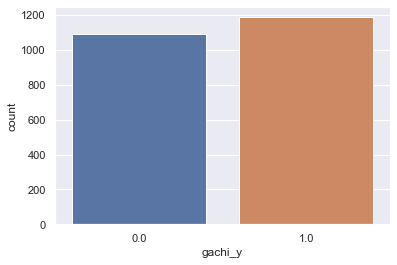

In [84]:
# rank=bについて
# 同じレベルのrank者同士がマッチングするようになってるみたい
df_all_b = df_all[
    (df_all["A1-rank"] == "b")
    | (df_all["A1-rank"] == "b-")
    | (df_all["A1-rank"] == "b+")
]
df_info(df_all_b)
check_countplot_col_y(df_all_b, "lobby-mode")

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,period,stage,y,year,month,day,dayofyear,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p,id
period,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-12-17 16:00:00+00:00,87,c+,sshooter_collabo,55.0,c,soytuber,60.0,c+,momiji,33.0,c+,screwslosher_becchu,21,c,dualsweeper_custom,26.0,c,furo,30.0,c,variableroller_foil,17.0,c-,nzap89,gachi,yagura,2019-12-17 16:00:00+00:00,mozuku,0.0,2019,12,17,351,1,0,16,4.025352,4.110874,3.526361,3.091042,3.295837,3.433987,2.890372,26
2019-10-19 06:00:00+00:00,57,c+,octoshooter_replica,39.0,c+,dynamo_becchu,30.0,c,hokusai_becchu,25.0,c,maneuver,29,c-,promodeler_rg,157.0,c+,screwslosher_becchu,34.0,c+,nzap89,23.0,c+,splatroller,gachi,yagura,2019-10-19 06:00:00+00:00,shottsuru,0.0,2019,10,19,292,5,1,6,3.688879,3.433987,3.258097,3.401197,5.062595,3.555348,3.178054,315
2019-10-20 22:00:00+00:00,30,c-,bold_7,19.0,c+,barrelspinner_remix,12.0,c-,maneuver_collabo,33.0,c-,pablo,11,c-,furo,13.0,c-,pablo,10.0,c-,carbon_deco,14.0,c,nzap85,gachi,hoko,2019-10-20 22:00:00+00:00,engawa,1.0,2019,10,20,293,6,1,22,2.995732,2.564949,3.526361,2.484907,2.639057,2.397895,2.708050,576
2019-10-20 12:00:00+00:00,25,c,longblaster_necro,15.0,c,maneuver_collabo,26.0,c,momiji,11.0,c-,parashelter,25,c+,quadhopper_white,28.0,c+,hokusai_becchu,15.0,c-,maneuver_collabo,24.0,c,prime_becchu,gachi,yagura,2019-10-20 12:00:00+00:00,anchovy,0.0,2019,10,20,293,6,1,12,2.772589,3.295837,2.484907,3.258097,3.367296,2.772589,3.218876,811
2020-01-05 10:00:00+00:00,91,c+,sshooter_collabo,32.0,c+,quadhopper_black,28.0,c,splatroller,38.0,c+,pablo,14,c-,nzap85,14.0,c-,splatroller,49.0,c+,splatroller,37.0,c+,sputtery_clear,gachi,yagura,2020-01-05 10:00:00+00:00,tachiuo,0.0,2020,1,5,5,6,1,10,3.496508,3.367296,3.663562,2.708050,2.708050,3.912023,3.637586,996
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-10-21 10:00:00+00:00,58,c+,wakaba,81.0,c+,splatroller,31.0,c-,splatroller,25.0,c-,splatscope_collabo,42,c+,wakaba,59.0,c+,heroroller_replica,49.0,c,heroroller_replica,23.0,c+,bold,gachi,yagura,2019-10-21 10:00:00+00:00,kombu,NaN,2019,10,21,294,0,0,10,4.406719,3.465736,3.258097,3.761200,4.094345,3.912023,3.178054,91956
2019-10-28 20:00:00+00:00,106,c+,hissen_hue,85.0,c,heroroller_replica,18.0,c,bottlegeyser,31.0,c+,splatroller,36,c+,longblaster,49.0,c-,splatroller,37.0,c+,splatroller,14.0,c-,sshooter,gachi,yagura,2019-10-28 20:00:00+00:00,anchovy,NaN,2019,10,28,301,0,0,20,4.454347,2.944439,3.465736,3.610918,3.912023,3.637586,2.708050,93501
2019-12-22 02:00:00+00:00,88,c+,sshooter_collabo,30.0,c,squiclean_g,22.0,c+,nova,23.0,c-,splatroller,54,c+,bold,32.0,c,variableroller_foil,35.0,c+,nova_becchu,27.0,c+,nzap85,gachi,yagura,2019-12-22 02:00:00+00:00,mongara,NaN,2019,12,22,356,6,1,2,3.433987,3.135494,3.178054,4.007333,3.496508,3.583519,3.332205,93612


(271, 44)


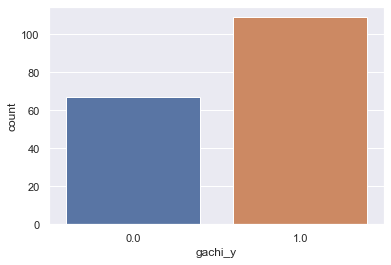

In [80]:
# rank=cについて
# 同じレベルのrank者同士がマッチングするようになってるみたい
df_all_c = df_all[
    (df_all["A1-rank"] == "c")
    | (df_all["A1-rank"] == "c-")
    | (df_all["A1-rank"] == "c+")
]
display(df_all_c)
print(df_all_c.shape)
check_countplot_col_y(df_all_c, "lobby-mode")

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,period,stage,y,year,month,day,dayofyear,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p,id
period,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-10-15 20:00:00+00:00,139,NaN,sshooter_becchu,118.0,NaN,soytuber_custom,13.0,NaN,pablo_hue,10.0,NaN,hokusai,28,NaN,bold_7,26.0,NaN,hokusai_becchu,68.0,NaN,herocharger_replica,31.0,NaN,sharp_neo,regular,nawabari,2019-10-15 20:00:00+00:00,sumeshi,1.0,2019,10,15,288,1,0,20,4.779123,2.639057,2.397895,3.367296,3.295837,4.234107,3.465736,0
2019-12-14 04:00:00+00:00,198,NaN,parashelter_sorella,77.0,NaN,jetsweeper,198.0,NaN,campingshelter_camo,123.0,NaN,nzap85,83,NaN,momiji,118.0,NaN,squiclean_b,168.0,NaN,campingshelter,151.0,NaN,sputtery_clear,regular,nawabari,2019-12-14 04:00:00+00:00,arowana,0.0,2019,12,14,348,5,1,4,4.356709,5.293305,4.820282,4.430817,4.779123,5.129899,5.023881,1
2019-11-11 14:00:00+00:00,336,NaN,bamboo14mk1,131.0,NaN,splatroller_becchu,189.0,NaN,dynamo_tesla,41.0,NaN,prime_becchu,273,NaN,splatcharger_becchu,189.0,NaN,liter4k,194.0,NaN,promodeler_mg,391.0,NaN,hotblaster_custom,regular,nawabari,2019-11-11 14:00:00+00:00,engawa,0.0,2019,11,11,315,0,0,14,4.882802,5.247024,3.737670,5.613128,5.247024,5.273000,5.971262,3
2019-12-31 06:00:00+00:00,113,NaN,octoshooter_replica,7.0,NaN,bucketslosher,12.0,NaN,carbon,19.0,NaN,jetsweeper,8,NaN,maneuver,13.0,NaN,pablo_permanent,38.0,NaN,dynamo_becchu,32.0,NaN,splatscope_becchu,regular,nawabari,2019-12-31 06:00:00+00:00,ama,1.0,2019,12,31,365,1,0,6,2.079442,2.564949,2.995732,2.197225,2.639057,3.663562,3.496508,7
2019-11-02 12:00:00+00:00,176,NaN,hydra_custom,113.0,NaN,furo,95.0,NaN,furo,83.0,NaN,nzap85,197,NaN,splatscope_collabo,169.0,NaN,barrelspinner_remix,96.0,NaN,ochiba,117.0,NaN,sharp_neo,regular,nawabari,2019-11-02 12:00:00+00:00,chozame,0.0,2019,11,2,306,5,1,12,4.736198,4.564348,4.430817,5.288267,5.135798,4.574711,4.770685,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-10-22 10:00:00+00:00,58,NaN,maneuver,39.0,NaN,furo,38.0,NaN,splatroller,51.0,NaN,splatcharger_collabo,228,NaN,splatcharger,61.0,NaN,bold,53.0,NaN,liter4k_scope,21.0,NaN,liter4k,regular,nawabari,2019-10-22 10:00:00+00:00,chozame,NaN,2019,10,22,295,1,0,10,3.688879,3.663562,3.951244,5.433722,4.127134,3.988984,3.091042,94423
2019-11-19 20:00:00+00:00,49,NaN,promodeler_pg,51.0,NaN,jetsweeper,175.0,NaN,sputtery_clear,31.0,NaN,longblaster,21,NaN,jetsweeper,114.0,NaN,96gal_deco,43.0,NaN,sshooter,137.0,NaN,campingshelter_camo,regular,nawabari,2019-11-19 20:00:00+00:00,devon,NaN,2019,11,19,323,1,0,20,3.951244,5.170484,3.465736,3.091042,4.744932,3.784190,4.927254,94425
2019-11-17 20:00:00+00:00,96,NaN,liter4k,78.0,NaN,kelvin525_becchu,28.0,NaN,52gal,67.0,NaN,promodeler_mg,39,NaN,bold_7,155.0,NaN,promodeler_rg,84.0,NaN,pablo,114.0,NaN,clashblaster,regular,nawabari,2019-11-17 20:00:00+00:00,devon,NaN,2019,11,17,321,6,1,20,4.369448,3.367296,4.219508,3.688879,5.049856,4.442651,4.744932,94429


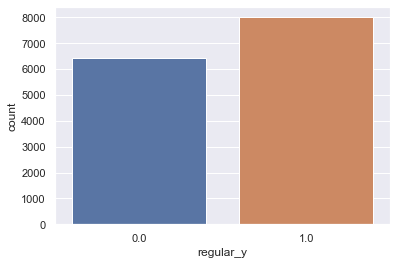

In [67]:
# A1-rankが欠損はレギューラーマッチのみ。レギューラーマッチはランク関係ないから？
df_all_n = df_all[df_all["A1-rank"].isnull()]
display(df_all_n)
check_countplot_col_y(df_all_n, "lobby-mode")

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,period,stage,y,year,month,day,dayofyear,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p,id
period,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-10-15 20:00:00+00:00,139,NaN,sshooter_becchu,118.0,NaN,soytuber_custom,13.0,NaN,pablo_hue,10.0,NaN,hokusai,28,NaN,bold_7,26.0,NaN,hokusai_becchu,68.0,NaN,herocharger_replica,31.0,NaN,sharp_neo,regular,nawabari,2019-10-15 20:00:00+00:00,sumeshi,1.0,2019,10,15,288,1,0,20,4.779123,2.639057,2.397895,3.367296,3.295837,4.234107,3.465736,0
2019-12-14 04:00:00+00:00,198,NaN,parashelter_sorella,77.0,NaN,jetsweeper,198.0,NaN,campingshelter_camo,123.0,NaN,nzap85,83,NaN,momiji,118.0,NaN,squiclean_b,168.0,NaN,campingshelter,151.0,NaN,sputtery_clear,regular,nawabari,2019-12-14 04:00:00+00:00,arowana,0.0,2019,12,14,348,5,1,4,4.356709,5.293305,4.820282,4.430817,4.779123,5.129899,5.023881,1
2019-11-11 14:00:00+00:00,336,NaN,bamboo14mk1,131.0,NaN,splatroller_becchu,189.0,NaN,dynamo_tesla,41.0,NaN,prime_becchu,273,NaN,splatcharger_becchu,189.0,NaN,liter4k,194.0,NaN,promodeler_mg,391.0,NaN,hotblaster_custom,regular,nawabari,2019-11-11 14:00:00+00:00,engawa,0.0,2019,11,11,315,0,0,14,4.882802,5.247024,3.737670,5.613128,5.247024,5.273000,5.971262,3
2019-12-31 06:00:00+00:00,113,NaN,octoshooter_replica,7.0,NaN,bucketslosher,12.0,NaN,carbon,19.0,NaN,jetsweeper,8,NaN,maneuver,13.0,NaN,pablo_permanent,38.0,NaN,dynamo_becchu,32.0,NaN,splatscope_becchu,regular,nawabari,2019-12-31 06:00:00+00:00,ama,1.0,2019,12,31,365,1,0,6,2.079442,2.564949,2.995732,2.197225,2.639057,3.663562,3.496508,7
2019-11-02 12:00:00+00:00,176,NaN,hydra_custom,113.0,NaN,furo,95.0,NaN,furo,83.0,NaN,nzap85,197,NaN,splatscope_collabo,169.0,NaN,barrelspinner_remix,96.0,NaN,ochiba,117.0,NaN,sharp_neo,regular,nawabari,2019-11-02 12:00:00+00:00,chozame,0.0,2019,11,2,306,5,1,12,4.736198,4.564348,4.430817,5.288267,5.135798,4.574711,4.770685,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-10-22 10:00:00+00:00,58,NaN,maneuver,39.0,NaN,furo,38.0,NaN,splatroller,51.0,NaN,splatcharger_collabo,228,NaN,splatcharger,61.0,NaN,bold,53.0,NaN,liter4k_scope,21.0,NaN,liter4k,regular,nawabari,2019-10-22 10:00:00+00:00,chozame,NaN,2019,10,22,295,1,0,10,3.688879,3.663562,3.951244,5.433722,4.127134,3.988984,3.091042,94423
2019-11-19 20:00:00+00:00,49,NaN,promodeler_pg,51.0,NaN,jetsweeper,175.0,NaN,sputtery_clear,31.0,NaN,longblaster,21,NaN,jetsweeper,114.0,NaN,96gal_deco,43.0,NaN,sshooter,137.0,NaN,campingshelter_camo,regular,nawabari,2019-11-19 20:00:00+00:00,devon,NaN,2019,11,19,323,1,0,20,3.951244,5.170484,3.465736,3.091042,4.744932,3.784190,4.927254,94425
2019-11-17 20:00:00+00:00,96,NaN,liter4k,78.0,NaN,kelvin525_becchu,28.0,NaN,52gal,67.0,NaN,promodeler_mg,39,NaN,bold_7,155.0,NaN,promodeler_rg,84.0,NaN,pablo,114.0,NaN,clashblaster,regular,nawabari,2019-11-17 20:00:00+00:00,devon,NaN,2019,11,17,321,6,1,20,4.369448,3.367296,4.219508,3.688879,5.049856,4.442651,4.744932,94429


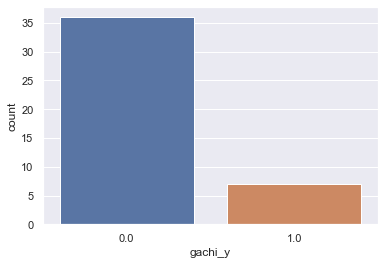

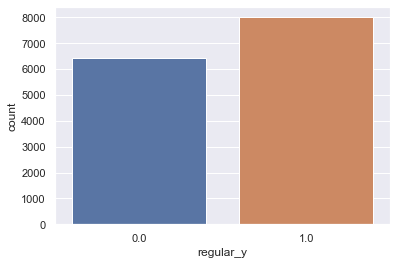

In [70]:
# A4-rankが欠損はガチマッチとレギューラーマッチ両方
df_all_n = df_all[df_all["A4-rank"].isnull()]
display(df_all_n)
check_countplot_col_y(df_all_n, "lobby-mode")

In [72]:
# A4-rankが欠損のガチマッチは人数3人とかのときだけ
df_all_n[df_all_n["lobby-mode"] == "gachi"]

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,period,stage,y,year,month,day,dayofyear,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p,id
period,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-12-27 00:00:00+00:00,394,x,furo,85.0,x,wakaba,387.0,x,nova,NaN,NaN,NaN,258,x,momiji,226.0,x,bucketslosher_deco,145.0,x,hydra_custom,NaN,NaN,NaN,gachi,area,2019-12-27 00:00:00+00:00,anchovy,1.0,2019,12,27,361,4,0,0,4.454347,5.961005,NaN,5.556828,5.424950,4.983607,NaN,326
2019-11-04 04:00:00+00:00,183,s+,prime_becchu,63.0,s+,nzap85,170.0,s+,splatscope,NaN,NaN,NaN,172,s+,sshooter_collabo,106.0,s+,ochiba,413.0,s+,hydra_custom,162.0,s+,prime_becchu,gachi,asari,2019-11-04 04:00:00+00:00,zatou,0.0,2019,11,4,308,0,0,4,4.158883,5.141664,NaN,5.153292,4.672829,6.025866,5.093750,796
2019-12-18 10:00:00+00:00,233,s+,prime_becchu,74.0,s+,maneuver,252.0,s+,sputtery_hue,NaN,NaN,NaN,143,s+,dualsweeper_custom,91.0,s+,promodeler_mg,146.0,s+,sputtery_clear,97.0,s+,splatroller,gachi,yagura,2019-12-18 10:00:00+00:00,kombu,0.0,2019,12,18,352,2,0,10,4.317488,5.533389,NaN,4.969813,4.521789,4.990433,4.584967,1096
2019-12-17 00:00:00+00:00,293,x,52gal,122.0,x,hydra_custom,195.0,x,wakaba,NaN,NaN,NaN,223,x,dualsweeper_custom,127.0,x,sshooter_collabo,292.0,x,barrelspinner_remix,198.0,x,promodeler_pg,gachi,asari,2019-12-17 00:00:00+00:00,ajifry,0.0,2019,12,17,351,1,0,0,4.812184,5.278115,NaN,5.411646,4.852030,5.680173,5.293305,2629
2019-11-06 10:00:00+00:00,110,b+,hissen_hue,22.0,b-,liter4k,20.0,b-,jetsweeper,NaN,NaN,NaN,34,b+,nzap89,39.0,b+,splatcharger,56.0,b,sshooter_collabo,30.0,b-,promodeler_pg,gachi,yagura,2019-11-06 10:00:00+00:00,fujitsubo,0.0,2019,11,6,310,2,0,10,3.135494,3.044522,NaN,3.555348,3.688879,4.043051,3.433987,6998
2019-12-25 10:00:00+00:00,378,s+,prime_becchu,109.0,s+,rapid_elite,79.0,s+,nzap85,NaN,NaN,NaN,467,s+,nzap89,454.0,s+,bold_7,55.0,s+,longblaster_necro,99.0,s+,sshooter_collabo,gachi,asari,2019-12-25 10:00:00+00:00,manta,0.0,2019,12,25,359,2,0,10,4.700480,4.382027,NaN,6.148468,6.120297,4.025352,4.605170,7614
2019-10-19 14:00:00+00:00,295,x,barrelspinner_remix,111.0,x,screwslosher_becchu,157.0,x,quadhopper_black,NaN,NaN,NaN,181,x,explosher_custom,67.0,x,nova,126.0,x,splatcharger,288.0,x,sshooter_collabo,gachi,yagura,2019-10-19 14:00:00+00:00,kombu,0.0,2019,10,19,292,5,1,14,4.718499,5.062595,NaN,5.204007,4.219508,4.844187,5.666427,9523
2019-11-25 18:00:00+00:00,244,x,rapid,180.0,x,splatcharger,85.0,x,sputtery_hue,NaN,NaN,NaN,361,x,prime_becchu,45.0,x,clashblaster_neo,349.0,x,hotblaster_custom,151.0,x,heroshelter_replica,gachi,yagura,2019-11-25 18:00:00+00:00,hakofugu,0.0,2019,11,25,329,0,0,18,5.198497,4.454347,NaN,5.891644,3.828641,5.857933,5.023881,10224
2019-12-22 06:00:00+00:00,84,x,prime_becchu,195.0,x,heroroller_replica,259.0,x,l3reelgun_becchu,NaN,NaN,NaN,154,x,splatroller,167.0,x,wakaba,146.0,x,rapid_becchu,239.0,x,nzap85,gachi,hoko,2019-12-22 06:00:00+00:00,sumeshi,0.0,2019,12,22,356,6,1,6,5.278115,5.560682,NaN,5.043425,5.123964,4.990433,5.480639,10787


,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,period,stage,y,year,month,day,dayofyear,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p,id
period,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-10-15 20:00:00+00:00,139,NaN,sshooter_becchu,118.0,NaN,soytuber_custom,13.0,NaN,pablo_hue,10.0,NaN,hokusai,28,NaN,bold_7,26.0,NaN,hokusai_becchu,68.0,NaN,herocharger_replica,31.0,NaN,sharp_neo,regular,nawabari,2019-10-15 20:00:00+00:00,sumeshi,1.0,2019,10,15,288,1,0,20,4.779123,2.639057,2.397895,3.367296,3.295837,4.234107,3.465736,0
2019-12-14 04:00:00+00:00,198,NaN,parashelter_sorella,77.0,NaN,jetsweeper,198.0,NaN,campingshelter_camo,123.0,NaN,nzap85,83,NaN,momiji,118.0,NaN,squiclean_b,168.0,NaN,campingshelter,151.0,NaN,sputtery_clear,regular,nawabari,2019-12-14 04:00:00+00:00,arowana,0.0,2019,12,14,348,5,1,4,4.356709,5.293305,4.820282,4.430817,4.779123,5.129899,5.023881,1
2019-11-11 14:00:00+00:00,336,NaN,bamboo14mk1,131.0,NaN,splatroller_becchu,189.0,NaN,dynamo_tesla,41.0,NaN,prime_becchu,273,NaN,splatcharger_becchu,189.0,NaN,liter4k,194.0,NaN,promodeler_mg,391.0,NaN,hotblaster_custom,regular,nawabari,2019-11-11 14:00:00+00:00,engawa,0.0,2019,11,11,315,0,0,14,4.882802,5.247024,3.737670,5.613128,5.247024,5.273000,5.971262,3
2019-12-31 06:00:00+00:00,113,NaN,octoshooter_replica,7.0,NaN,bucketslosher,12.0,NaN,carbon,19.0,NaN,jetsweeper,8,NaN,maneuver,13.0,NaN,pablo_permanent,38.0,NaN,dynamo_becchu,32.0,NaN,splatscope_becchu,regular,nawabari,2019-12-31 06:00:00+00:00,ama,1.0,2019,12,31,365,1,0,6,2.079442,2.564949,2.995732,2.197225,2.639057,3.663562,3.496508,7
2019-11-02 12:00:00+00:00,176,NaN,hydra_custom,113.0,NaN,furo,95.0,NaN,furo,83.0,NaN,nzap85,197,NaN,splatscope_collabo,169.0,NaN,barrelspinner_remix,96.0,NaN,ochiba,117.0,NaN,sharp_neo,regular,nawabari,2019-11-02 12:00:00+00:00,chozame,0.0,2019,11,2,306,5,1,12,4.736198,4.564348,4.430817,5.288267,5.135798,4.574711,4.770685,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-10-22 10:00:00+00:00,58,NaN,maneuver,39.0,NaN,furo,38.0,NaN,splatroller,51.0,NaN,splatcharger_collabo,228,NaN,splatcharger,61.0,NaN,bold,53.0,NaN,liter4k_scope,21.0,NaN,liter4k,regular,nawabari,2019-10-22 10:00:00+00:00,chozame,NaN,2019,10,22,295,1,0,10,3.688879,3.663562,3.951244,5.433722,4.127134,3.988984,3.091042,94423
2019-11-19 20:00:00+00:00,49,NaN,promodeler_pg,51.0,NaN,jetsweeper,175.0,NaN,sputtery_clear,31.0,NaN,longblaster,21,NaN,jetsweeper,114.0,NaN,96gal_deco,43.0,NaN,sshooter,137.0,NaN,campingshelter_camo,regular,nawabari,2019-11-19 20:00:00+00:00,devon,NaN,2019,11,19,323,1,0,20,3.951244,5.170484,3.465736,3.091042,4.744932,3.784190,4.927254,94425
2019-11-17 20:00:00+00:00,96,NaN,liter4k,78.0,NaN,kelvin525_becchu,28.0,NaN,52gal,67.0,NaN,promodeler_mg,39,NaN,bold_7,155.0,NaN,promodeler_rg,84.0,NaN,pablo,114.0,NaN,clashblaster,regular,nawabari,2019-11-17 20:00:00+00:00,devon,NaN,2019,11,17,321,6,1,20,4.369448,3.367296,4.219508,3.688879,5.049856,4.442651,4.744932,94429


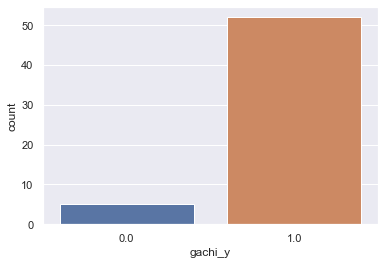

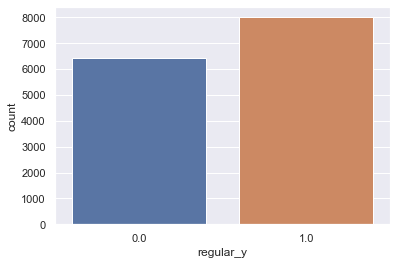

In [73]:
# B4-rankが欠損はガチマッチとレギューラーマッチ両方
df_all_n = df_all[df_all["B4-rank"].isnull()]
display(df_all_n)
check_countplot_col_y(df_all_n, "lobby-mode")

In [74]:
# B4-rankが欠損のガチマッチは人数3人とかのときだけ
df_all_n[df_all_n["lobby-mode"] == "gachi"]

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,period,stage,y,year,month,day,dayofyear,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p,id
period,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-12-27 00:00:00+00:00,394,x,furo,85.0,x,wakaba,387.0,x,nova,NaN,NaN,NaN,258,x,momiji,226.0,x,bucketslosher_deco,145.0,x,hydra_custom,NaN,NaN,NaN,gachi,area,2019-12-27 00:00:00+00:00,anchovy,1.0,2019,12,27,361,4,0,0,4.454347,5.961005,NaN,5.556828,5.424950,4.983607,NaN,326
2019-11-07 08:00:00+00:00,110,a-,hissen,47.0,a-,sputtery_hue,182.0,a-,variableroller_foil,52.0,a-,dualsweeper_custom,92,a,splatcharger,106.0,a,maneuver_becchu,61.0,a,hokusai_hue,NaN,NaN,NaN,gachi,hoko,2019-11-07 08:00:00+00:00,hokke,1.0,2019,11,7,311,3,0,8,3.871201,5.209486,3.970292,4.532599,4.672829,4.127134,NaN,2381
2019-11-18 22:00:00+00:00,41,x,sputtery_hue,89.0,x,sshooter_collabo,90.0,x,herocharger_replica,125.0,x,carbon_deco,63,x,hokusai_hue,322.0,x,prime_collabo,243.0,x,carbon_deco,NaN,NaN,NaN,gachi,hoko,2019-11-18 22:00:00+00:00,battera,1.0,2019,11,18,322,0,0,22,4.499810,4.510860,4.836282,4.158883,5.777652,5.497168,NaN,2791
2019-10-27 08:00:00+00:00,325,x,nova_neo,359.0,x,kugelschreiber_hue,193.0,x,ochiba,248.0,x,l3reelgun_d,99,x,rapid_becchu,376.0,x,carbon_deco,416.0,x,liter4k_scope,NaN,NaN,NaN,gachi,yagura,2019-10-27 08:00:00+00:00,anchovy,1.0,2019,10,27,300,6,1,8,5.886104,5.267858,5.517453,4.605170,5.932245,6.033086,NaN,5478
2019-11-07 20:00:00+00:00,194,s+,heroroller_replica,81.0,s+,hotblaster_custom,156.0,s+,splatspinner,160.0,s+,rapid_becchu,200,s+,nzap85,169.0,s+,splatroller,113.0,s+,rapid_becchu,NaN,NaN,NaN,gachi,asari,2019-11-07 20:00:00+00:00,mozuku,1.0,2019,11,7,311,3,0,20,4.406719,5.056246,5.081404,5.303305,5.135798,4.736198,NaN,5780
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-10-22 20:00:00+00:00,153,x,sshooter_collabo,259.0,x,pablo,93.0,x,splatcharger_becchu,164.0,x,sharp_neo,481,x,maneuver_collabo,410.0,x,nzap85,81.0,x,herocharger_replica,NaN,NaN,NaN,gachi,hoko,2019-10-22 20:00:00+00:00,mutsugoro,NaN,2019,10,22,295,1,0,20,5.560682,4.543295,5.105945,6.177944,6.018593,4.406719,NaN,87652
2019-12-28 08:00:00+00:00,104,a+,wakaba,419.0,a+,variableroller_foil,159.0,a,splatcharger,58.0,a+,bold,75,a+,herocharger_replica,138.0,a,barrelspinner_deco,68.0,a+,clashblaster_neo,NaN,NaN,NaN,gachi,hoko,2019-12-28 08:00:00+00:00,arowana,NaN,2019,12,28,362,5,1,8,6.040255,5.075174,4.077537,4.330733,4.934474,4.234107,NaN,88369
2019-11-10 14:00:00+00:00,195,s+,hokusai_hue,182.0,s+,prime_becchu,259.0,s+,kugelschreiber_hue,341.0,s+,maneuver_becchu,99,s+,furo_deco,122.0,s+,liter4k,267.0,s+,sputtery_hue,NaN,NaN,NaN,gachi,hoko,2019-11-10 14:00:00+00:00,hokke,NaN,2019,11,10,314,6,1,14,5.209486,5.560682,5.834811,4.605170,4.812184,5.590987,NaN,91533


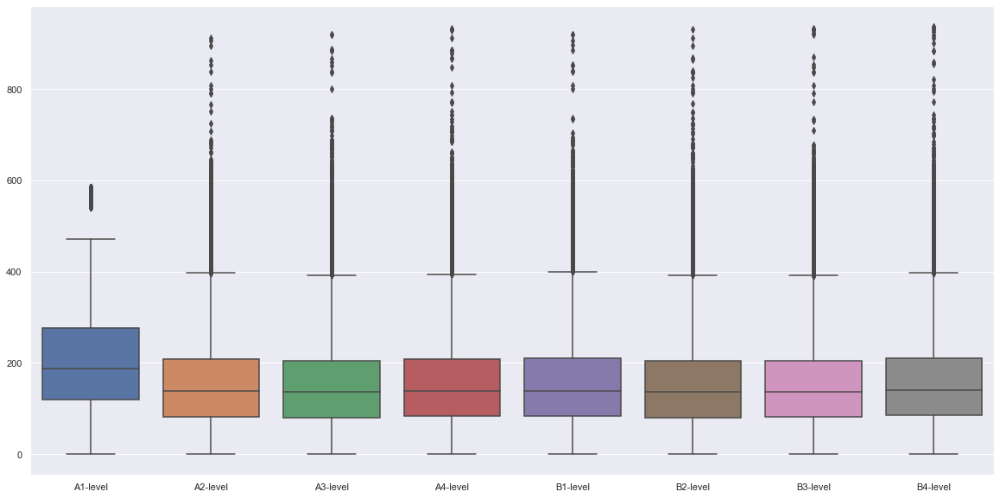

In [26]:
# A1-levelは外れ値ありそう
def check_out(df):
    # 外れ値確認
    num_cols = df.select_dtypes(include=["int", "int32", "int64", "float", "float32", "float64"]).columns.to_list()
    plt.figure(figsize=(20, 10))
    sns.boxplot(data=df[num_cols])
    plt.show()
    plt.clf()
    plt.close()
    
# level列だけで確認
l_in = [s for s in df_all.columns.to_list() if 'level' in s]
check_out(df_all[l_in])

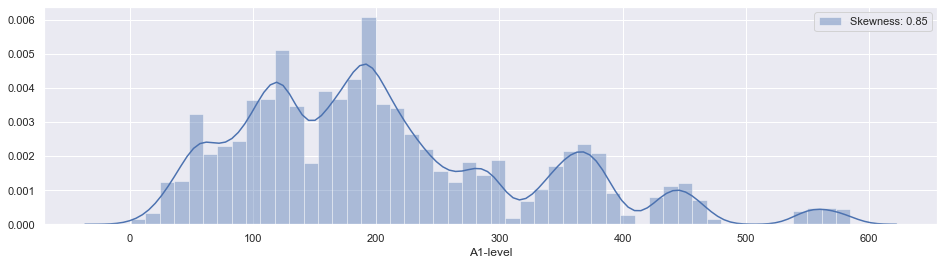

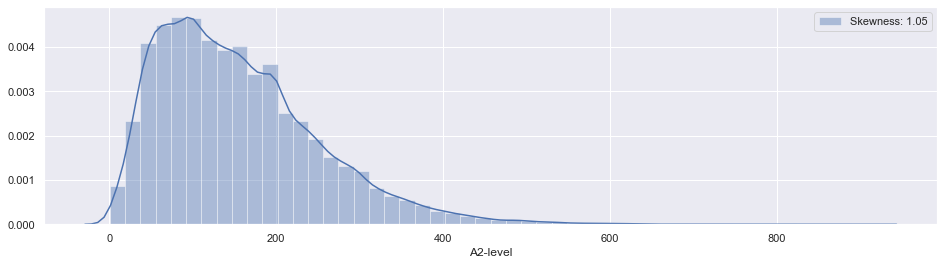

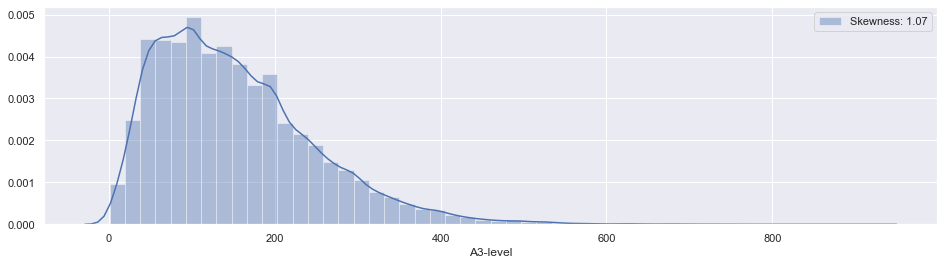

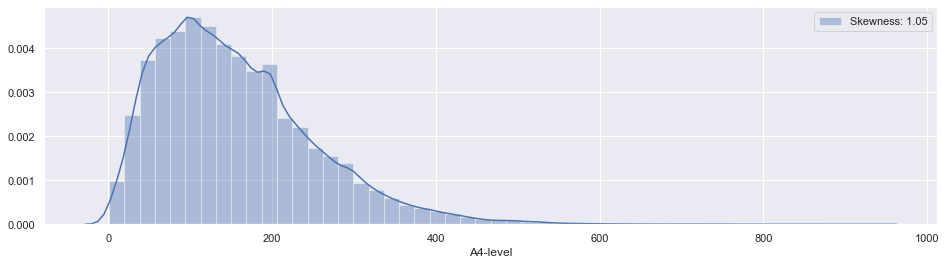

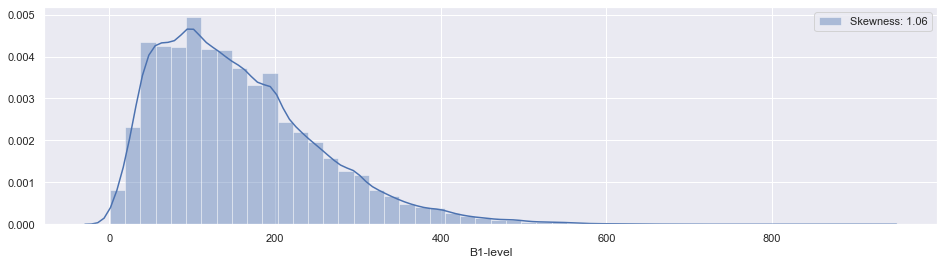

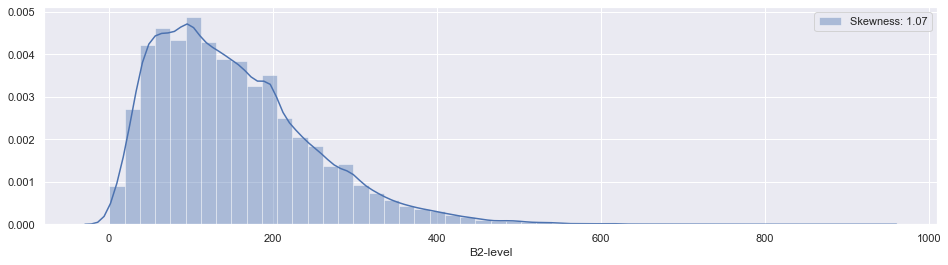

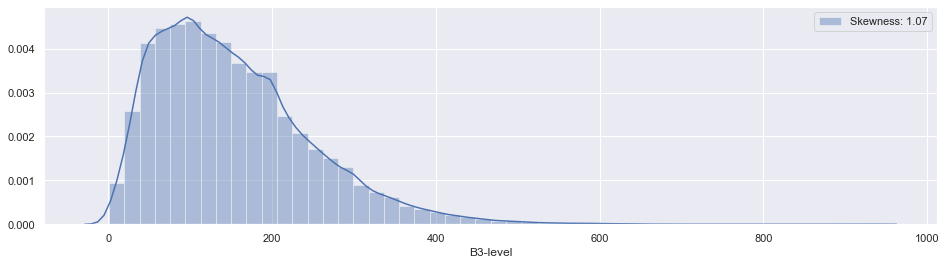

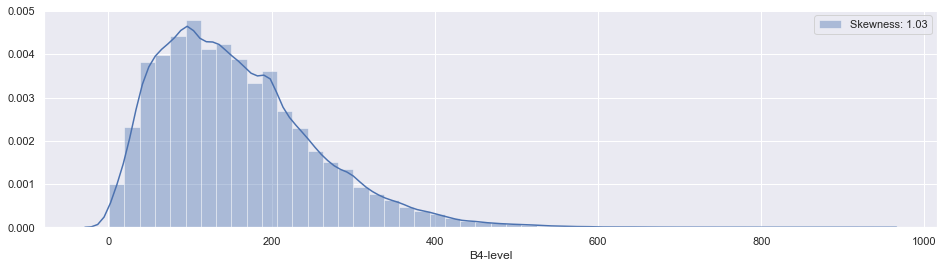

In [27]:
# A2-level, A3-level, A4-level, B1-level, B2-level, B3-level, B4-level は対数化した方が良いかも
def check_num_hist(df):
    # 数値列のヒストグラム。歪み（Skewness）大きい場合は対数変換した方が良い
    num_cols = df.select_dtypes(include=["int", "int32", "int64", "float", "float32", "float64"]).columns.to_list()
    for col in num_cols:
        try:
            _ser = df[col].dropna()
            plt.figure(figsize=(16, 4))
            sns.distplot(_ser, label=f"Skewness: {round(_ser.skew(), 2)}")
            plt.legend()
            plt.show()
            plt.clf()
            plt.close()
        except Exception as e:
            print(e)
            print(f"ERROR: {col}")

l_in = [s for s in df_all.columns.to_list() if 'level' in s]
check_num_hist(df_all[l_in])

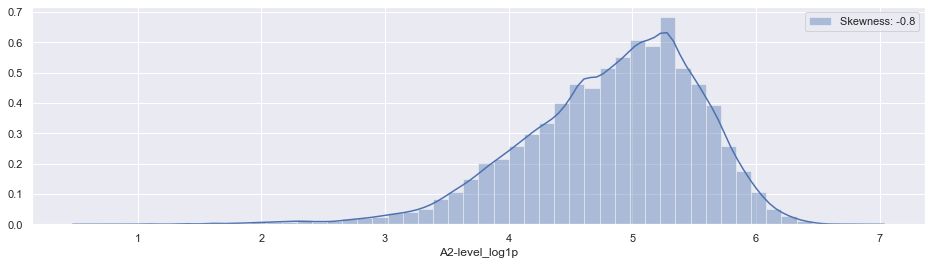

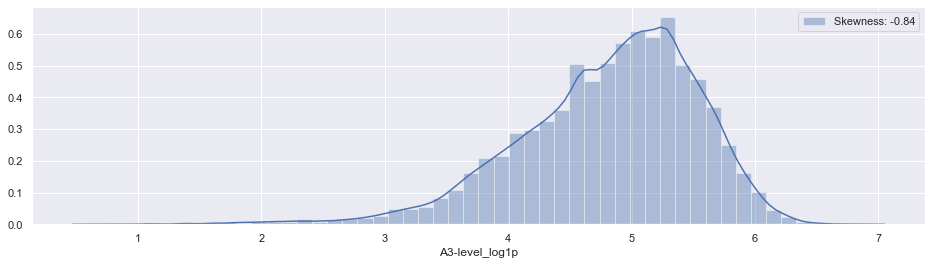

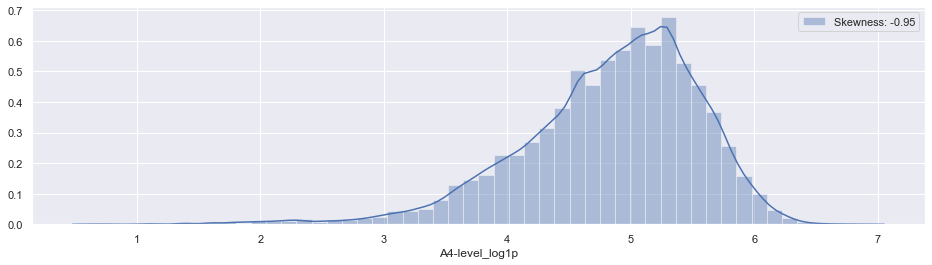

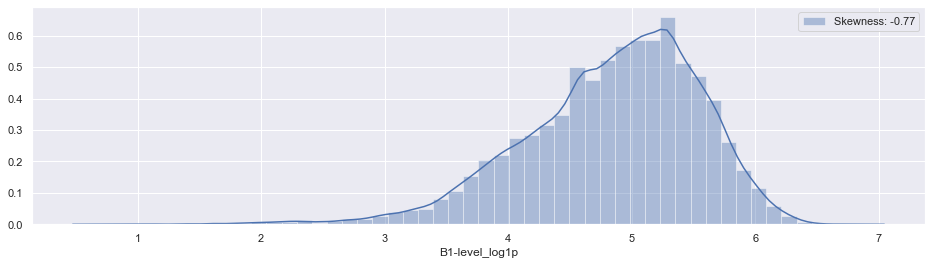

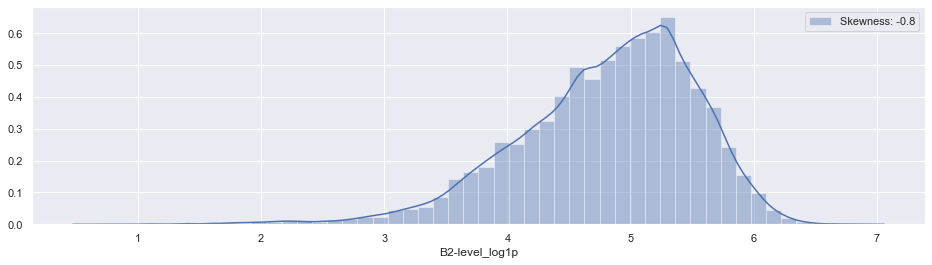

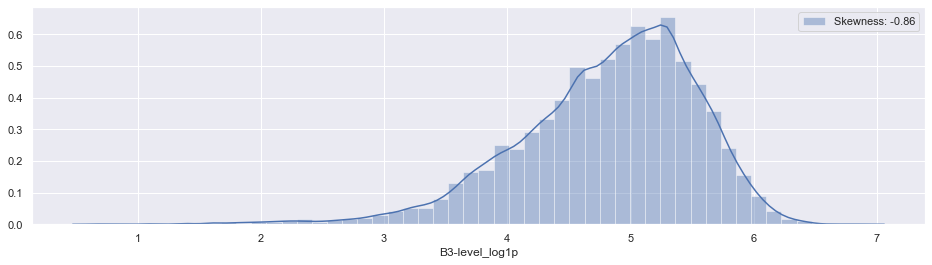

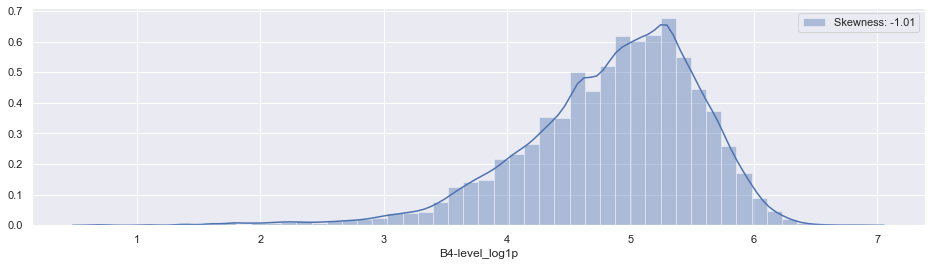

In [28]:
# 歪度あまり改善しなので対数化しても意味なさそう
def log1p(df, num_cols):
    for col in num_cols:
        df[f"{col}_log1p"] = np.log(df[col] + 1)
    return df

log1p_cols = ["A2-level", "A3-level", "A4-level", "B1-level", "B2-level", "B3-level", "B4-level"]
df_all = log1p(df_all, log1p_cols)

new_log1p_cols = [f"{c}_log1p" for c in log1p_cols]
check_num_hist(df_all[new_log1p_cols])

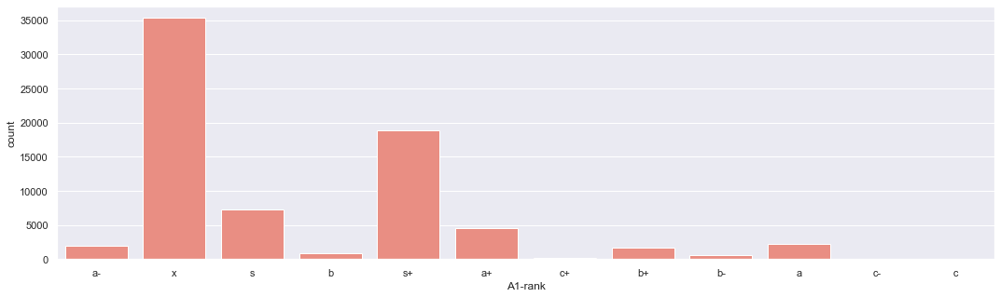

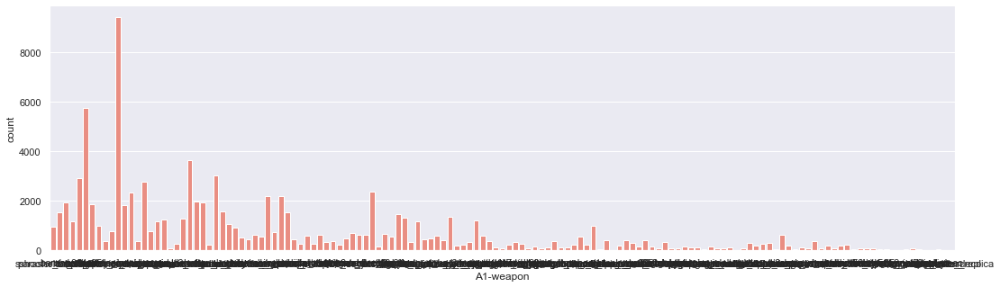

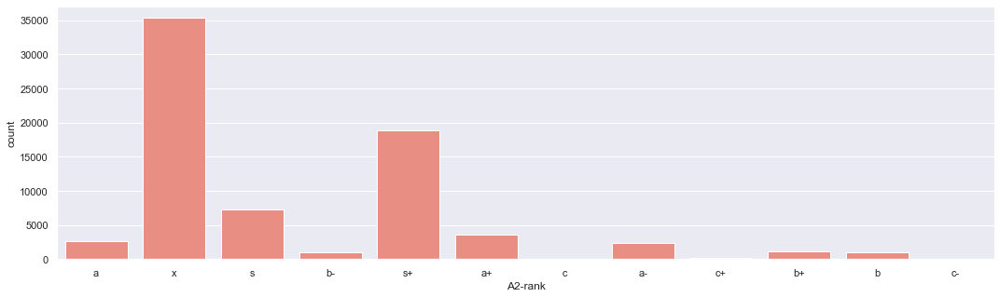

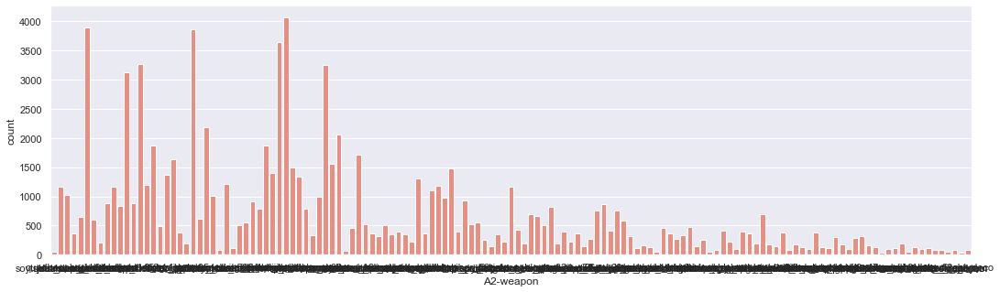

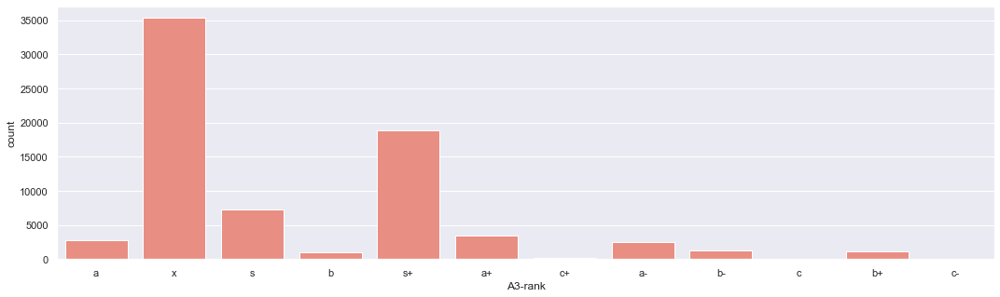

...

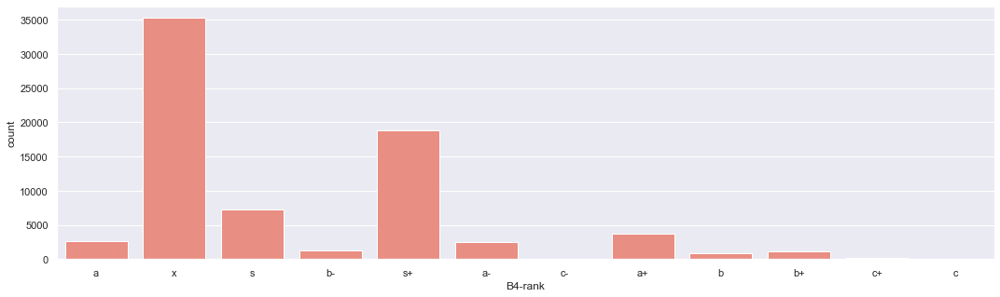

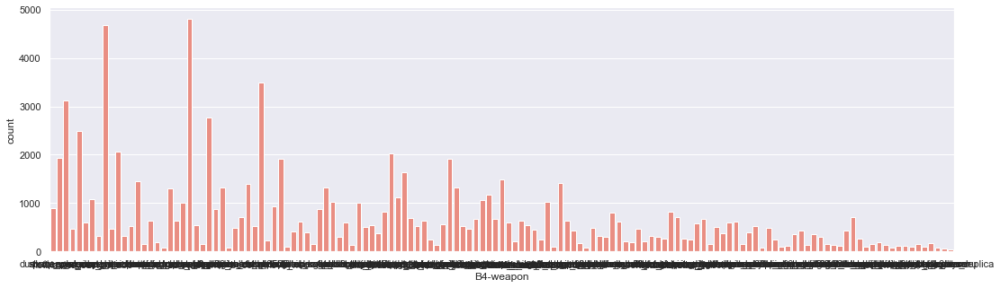

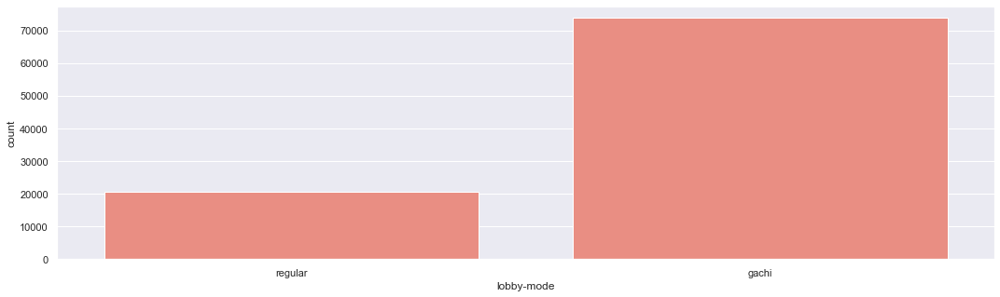

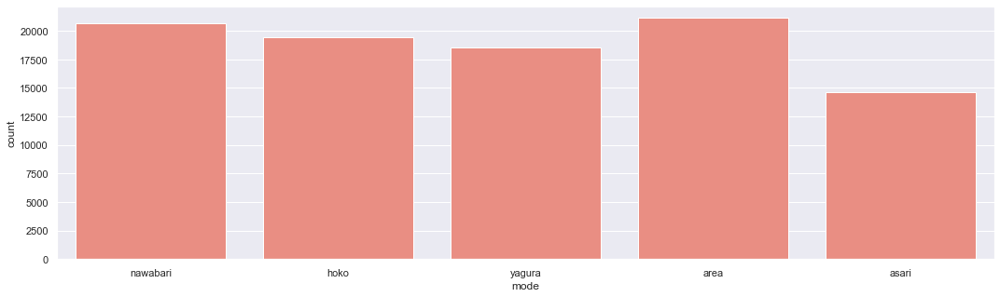

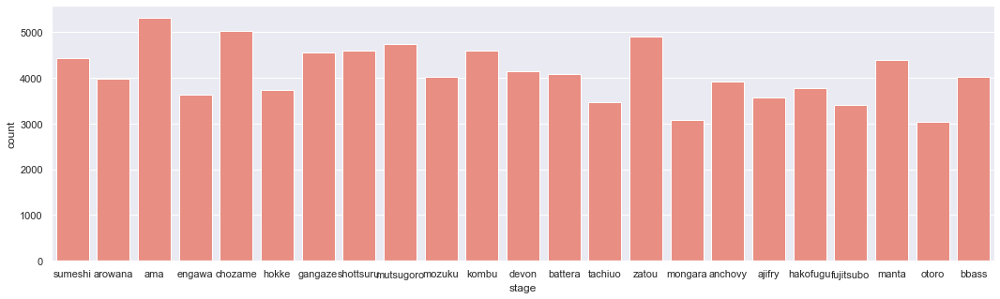

In [29]:
def check_cate_count(df):
    # カテゴリ列のレコード数
    cate_cols = df.select_dtypes(include=["object", "category", "bool"]).columns.to_list()
    for col in cate_cols:
        plt.figure(figsize=(18, 5))
        sns.countplot(x=col, data=df, color='salmon')
        plt.show()
        plt.clf()
        plt.close()
        
check_cate_count(df_all)

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,period,stage,y,year,month,day,dayofyear,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p
period,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-10-15 20:00:00+00:00,139,NaN,sshooter_becchu,118.0,NaN,soytuber_custom,13.0,NaN,pablo_hue,10.0,NaN,hokusai,28,NaN,bold_7,26.0,NaN,hokusai_becchu,68.0,NaN,herocharger_replica,31.0,NaN,sharp_neo,regular,nawabari,2019-10-15 20:00:00+00:00,sumeshi,1.0,2019,10,15,288,1,0,20,4.779123,2.639057,2.397895,3.367296,3.295837,4.234107,3.465736


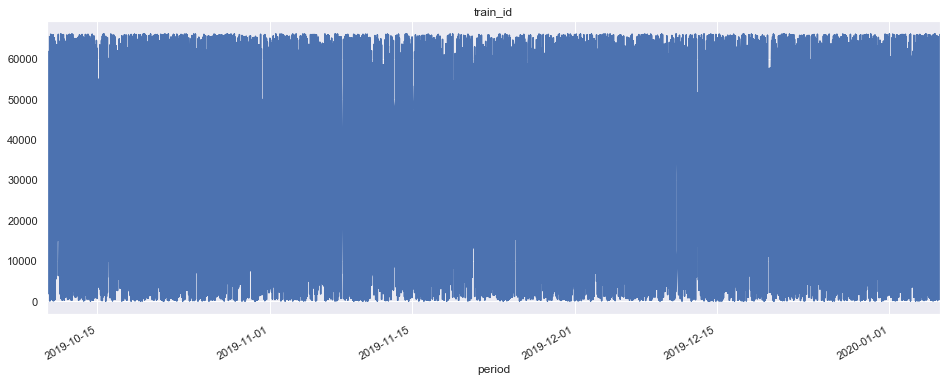

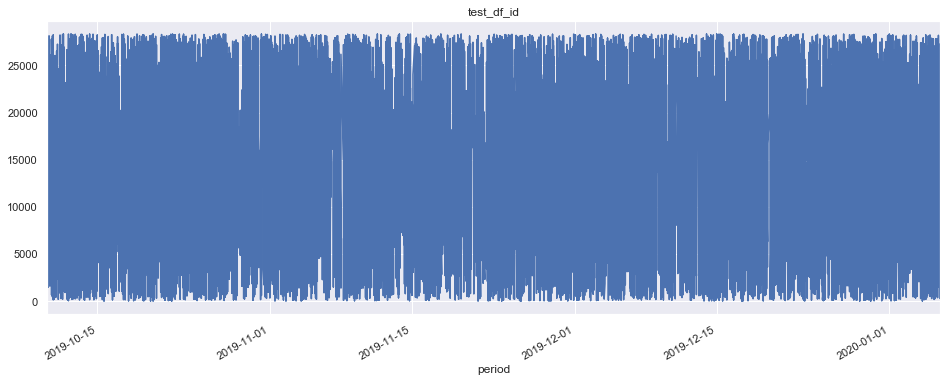

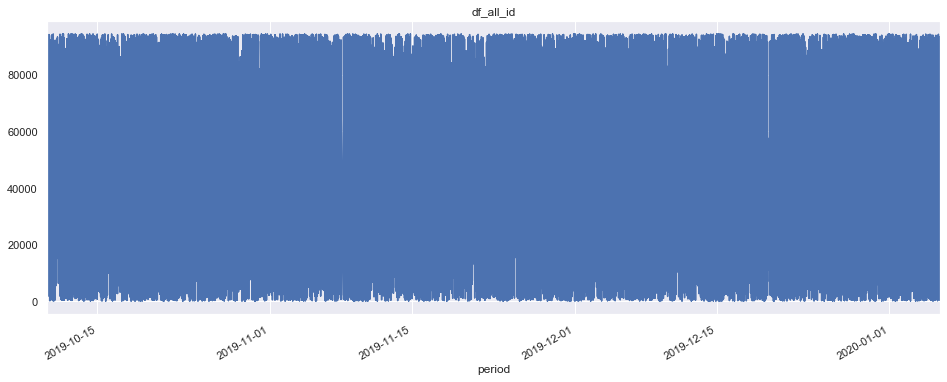

In [30]:
# trainとtestの期間はごちゃ混ぜだった
# cvは時系列のやり方で分けなくて良さそう
train_df['period'] = pd.to_datetime(train_df['period'], format='%Y-%m-%d %H:%M:%S')
test_df['period'] = pd.to_datetime(test_df['period'], format='%Y-%m-%d %H:%M:%S')
df_all['period'] = pd.to_datetime(df_all['period'], format='%Y-%m-%d %H:%M:%S')

train_df = train_df.set_index('period', drop=False)
test_df = test_df.set_index('period', drop=False)
df_all = df_all.set_index('period', drop=False)

display(df_all.head(1))

# 一意のid降りなおす
df_all["id"] = list(range(df_all.shape[0])) 

train_df["id"].plot(title="train_id", figsize=(16, 6))
plt.show()

test_df["id"].plot(title="test_df_id", figsize=(16, 6))
plt.show()

df_all["id"].plot(title="df_all_id", figsize=(16, 6))
plt.show()

- 

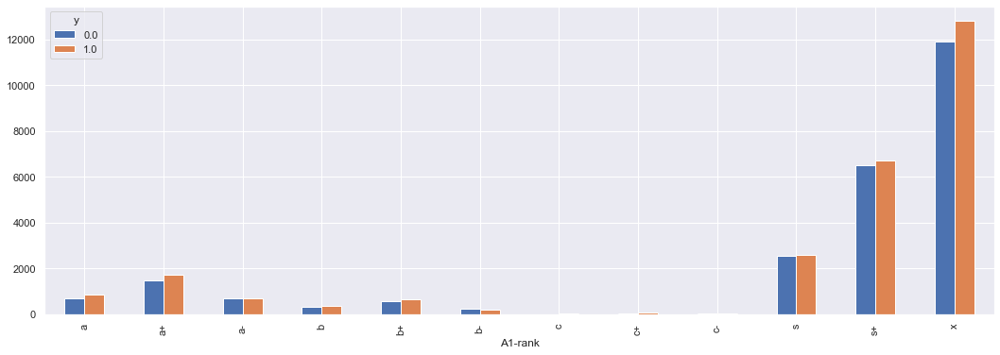

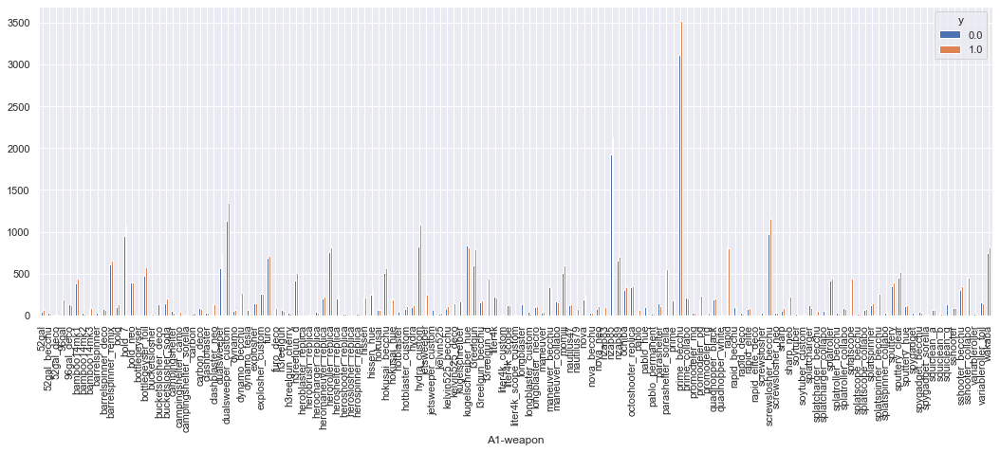

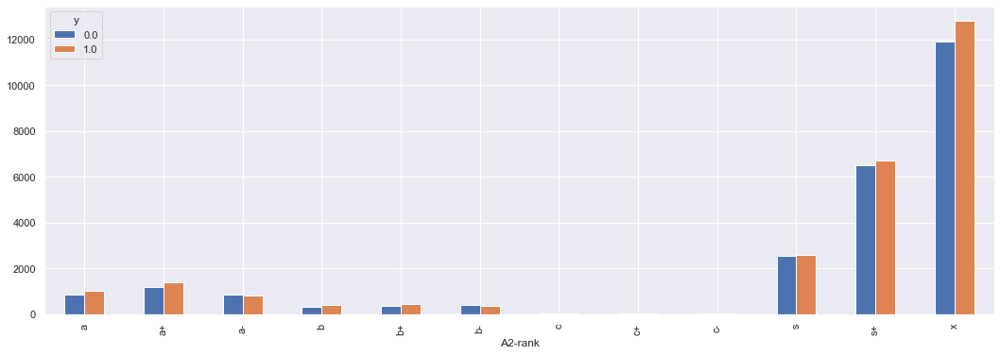

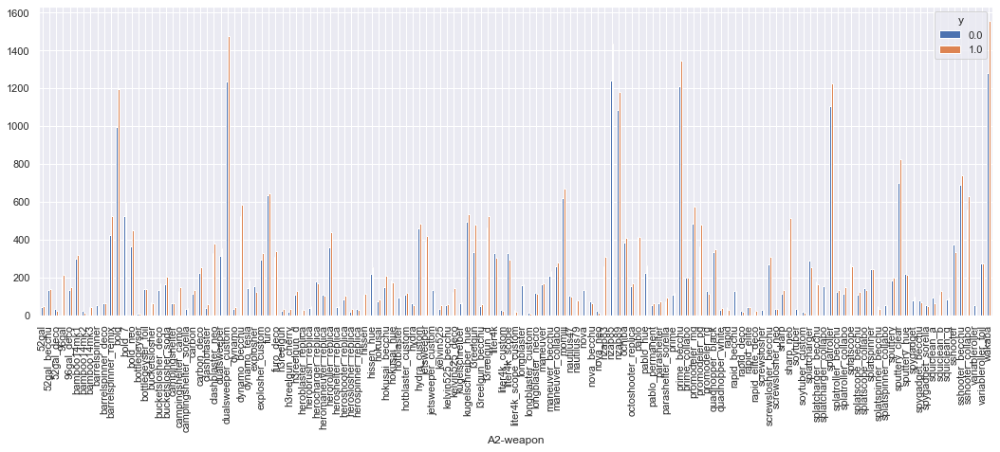

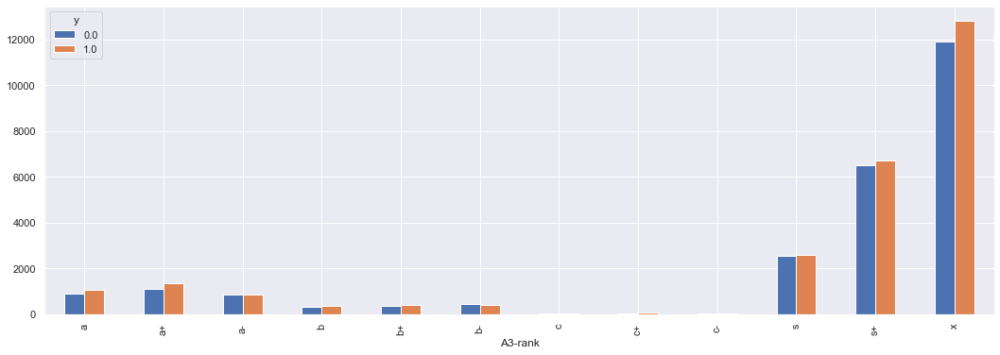

...

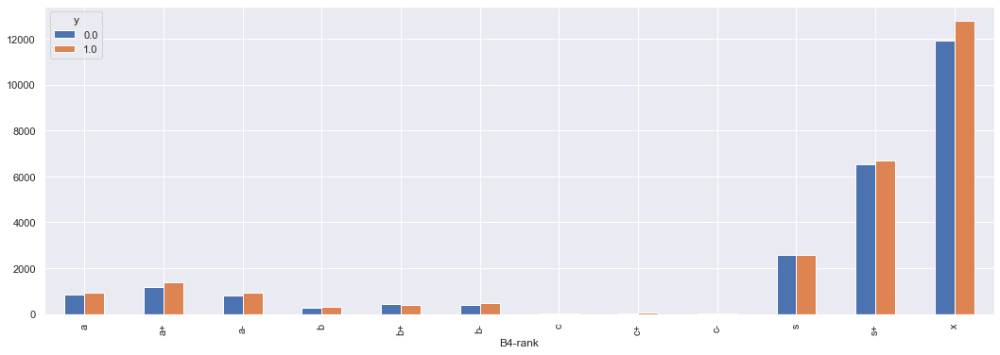

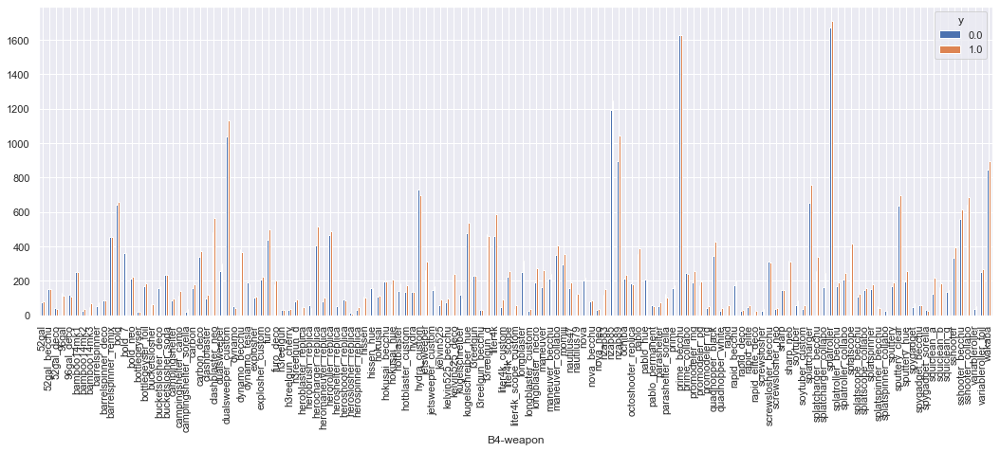

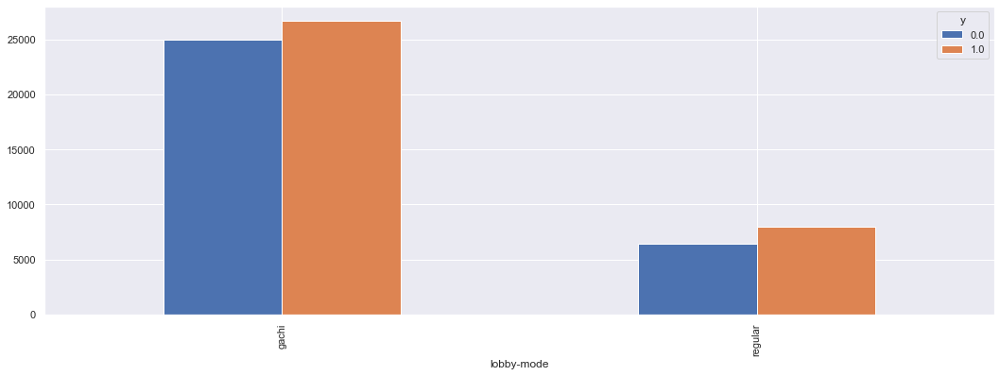

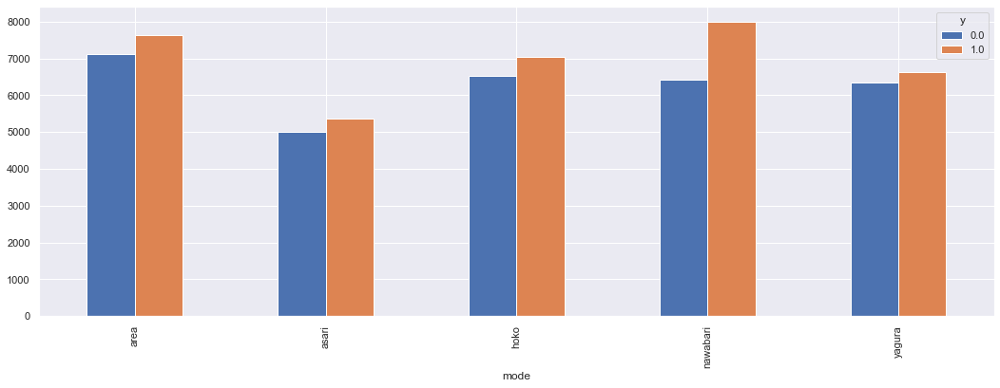

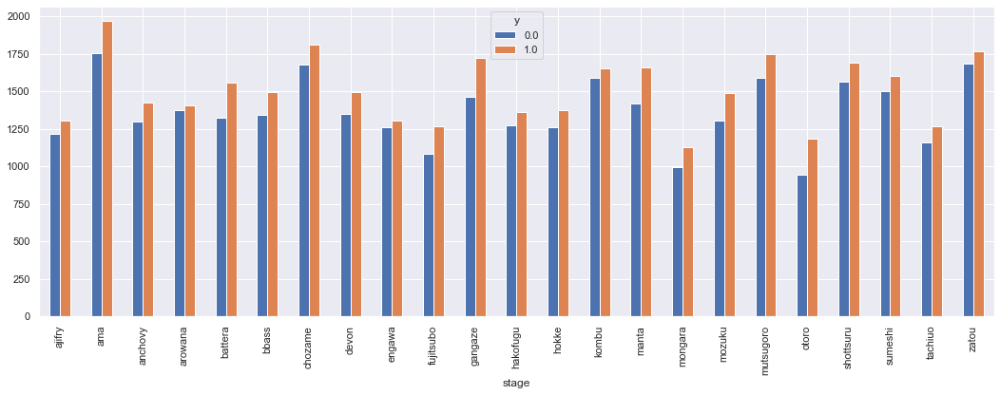

In [31]:
# カテゴリ列 vs. カテゴリ列。これは１列ごとに見てかないと理解できない
# countの場合は valuesはどの列選んでも同じ。columnsとindexが一意なレコードの数数える
str_cols = df_all.select_dtypes(include=["object", "category", "bool"]).columns.to_list()
for col in str_cols:
    _df = df_all.pivot_table(values="id", index=col, columns="y", aggfunc="count",)
    _df.plot.bar(figsize=(18, 6))
    plt.show()
    plt.clf()
    plt.close()

- rankによる勝ち負けの差は大きくはなさそう
- 武器によって勝ち負けの差大きそう
- mode違いで勝ち負けの差は少しありそう
- ステージ違いで勝ち負けの差は大きくはなさそう

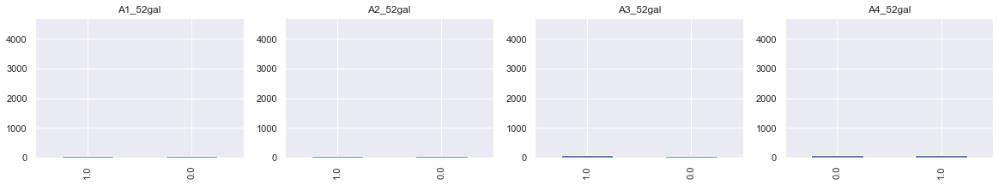

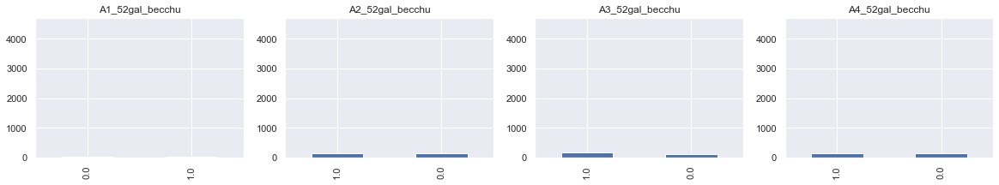

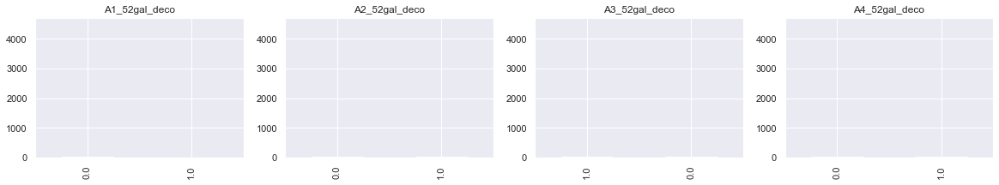

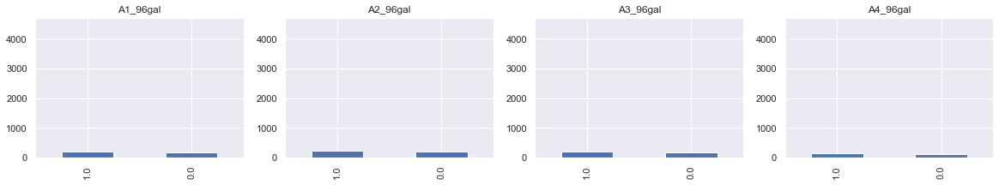

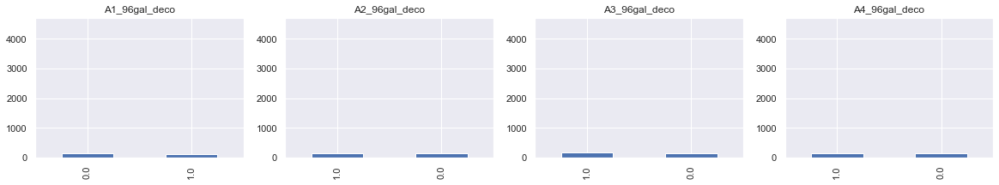

...

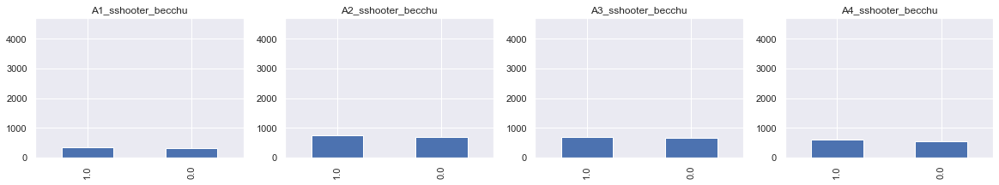

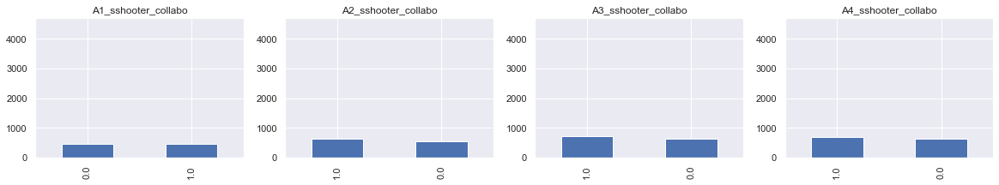

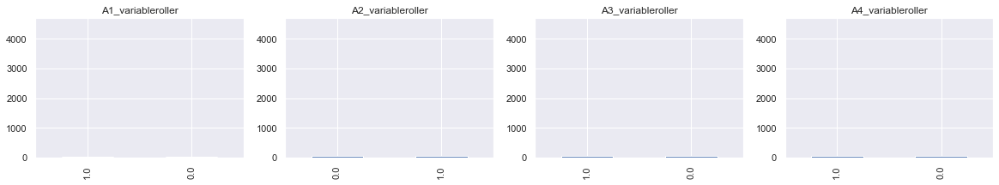

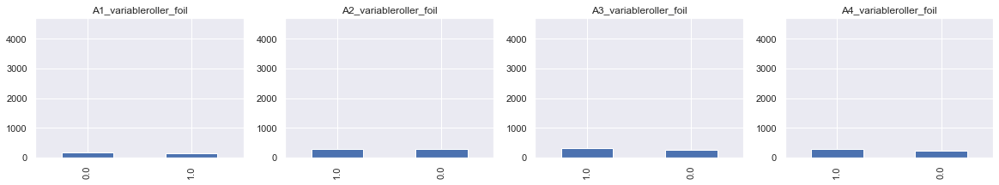

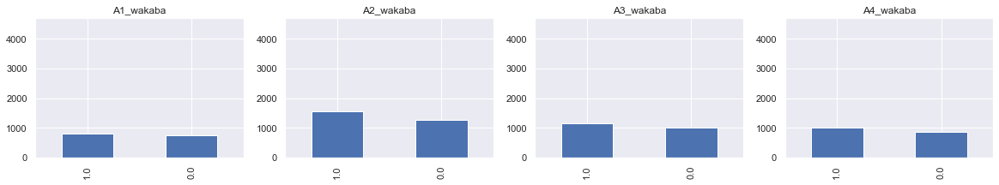

In [32]:
# Aチームの武器の分布
v_max = df_all["A1-weapon"].value_counts().max()

for (i, _df_A1), (_, _df_A2), (_, _df_A3), (_, _df_A4) in zip(
    df_all.groupby("A1-weapon"),
    df_all.groupby("A2-weapon"),
    df_all.groupby("A3-weapon"),
    df_all.groupby("A4-weapon"),
):
    fig, ax = plt.subplots(1, 4, figsize=(20, 3))
    ti = _df_A1["A1-weapon"].iloc[0]
    _df_A1["y"].value_counts().plot.bar(title=f"A1_{ti}", ylim=[0, v_max // 2], ax=ax[0])
    _df_A2["y"].value_counts().plot.bar(title=f"A2_{ti}", ylim=[0, v_max // 2], ax=ax[1])
    _df_A3["y"].value_counts().plot.bar(title=f"A3_{ti}", ylim=[0, v_max // 2], ax=ax[2])
    _df_A4["y"].value_counts().plot.bar(title=f"A4_{ti}", ylim=[0, v_max // 2], ax=ax[3])
    plt.show()
    plt.clf()
    plt.close()

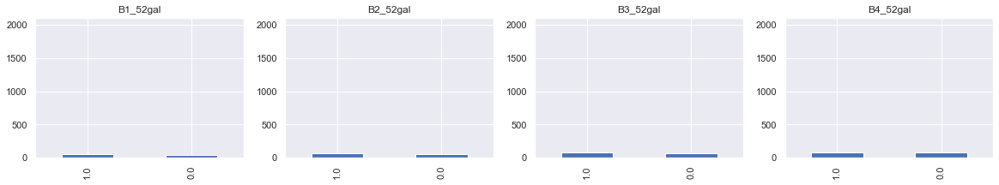

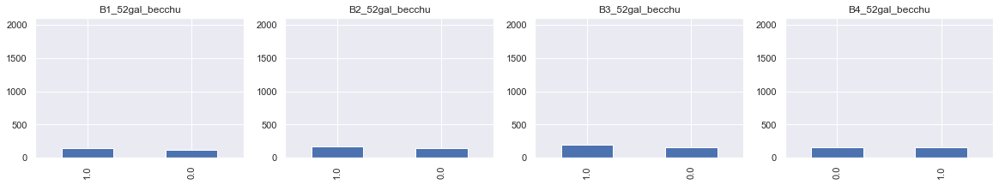

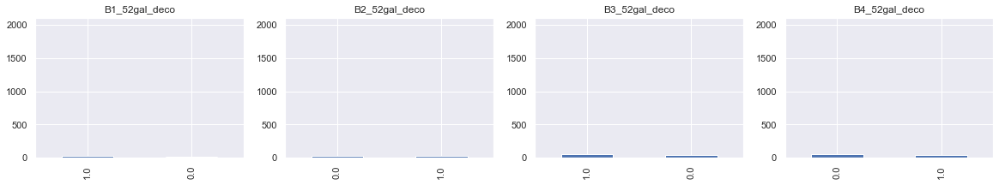

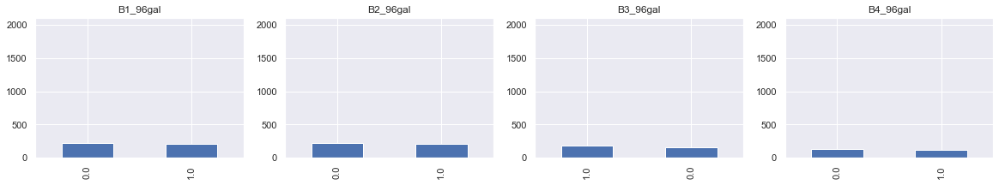

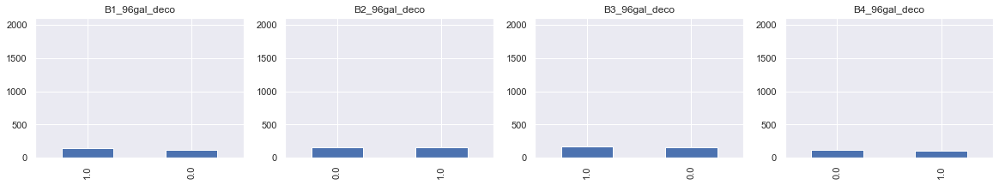

...

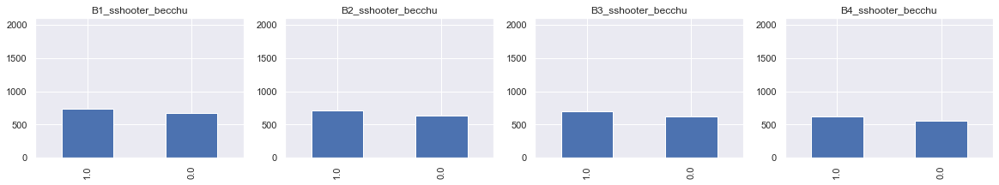

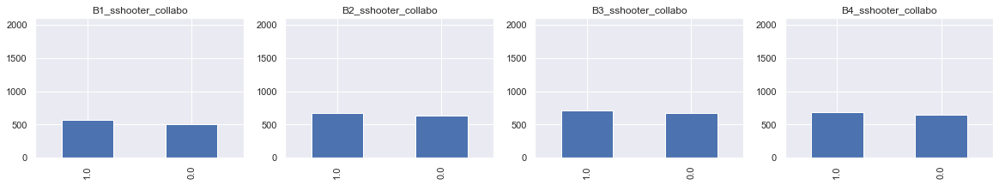

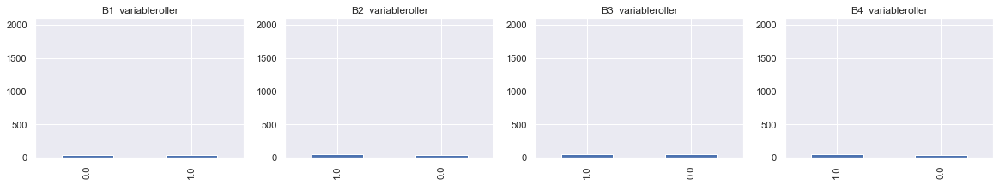

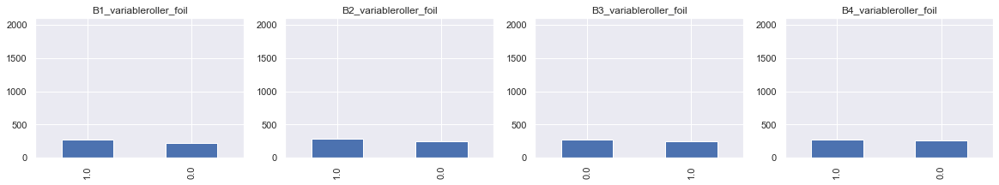

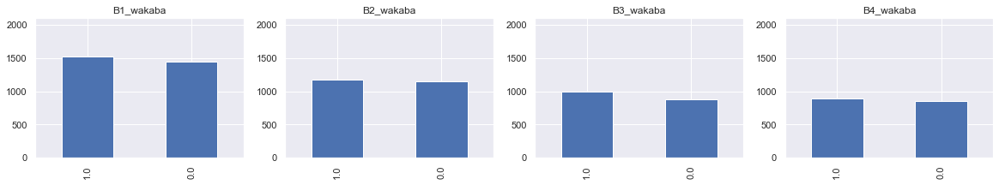

In [33]:
# Bチームの武器の分布
v_max = df_all["B1-weapon"].value_counts().max()

for (i, _df_B1), (_, _df_B2), (_, _df_B3), (_, _df_B4) in zip(
    df_all.groupby("B1-weapon"),
    df_all.groupby("B2-weapon"),
    df_all.groupby("B3-weapon"),
    df_all.groupby("B4-weapon"),
):
    fig, ax = plt.subplots(1, 4, figsize=(20, 3))
    ti = _df_B1["B1-weapon"].iloc[0]
    _df_B1["y"].value_counts().plot.bar(title=f"B1_{ti}", ylim=[0, v_max // 2], ax=ax[0])
    _df_B2["y"].value_counts().plot.bar(title=f"B2_{ti}", ylim=[0, v_max // 2], ax=ax[1])
    _df_B3["y"].value_counts().plot.bar(title=f"B3_{ti}", ylim=[0, v_max // 2], ax=ax[2])
    _df_B4["y"].value_counts().plot.bar(title=f"B4_{ti}", ylim=[0, v_max // 2], ax=ax[3])
    plt.show()
    plt.clf()
    plt.close()

- よく使われる武器とそうでない武器の差が激しい
- どの武器もラベルに不均衡はなさそう

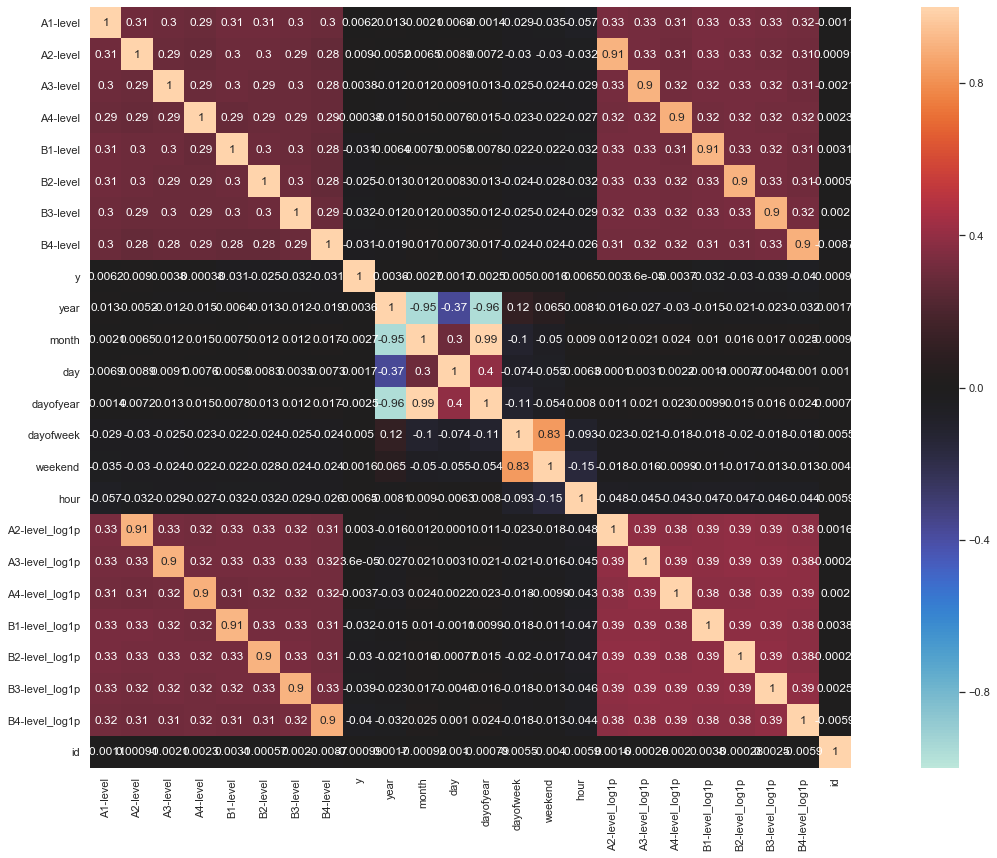

In [34]:
# 特徴量同士の相関ヒートマップ
# 元々の列で相関明らかに高い列はない
fig, ax = plt.subplots(figsize=(25, 14))
sns.heatmap(df_all.corr(), square=True, vmax=1, vmin=-1, center=0, annot=True)
plt.show()

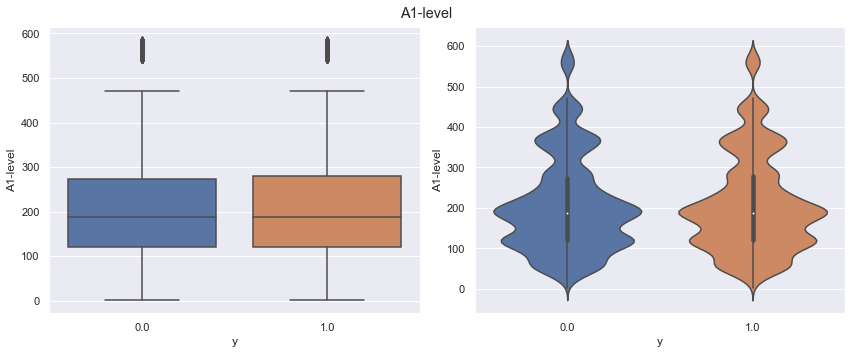

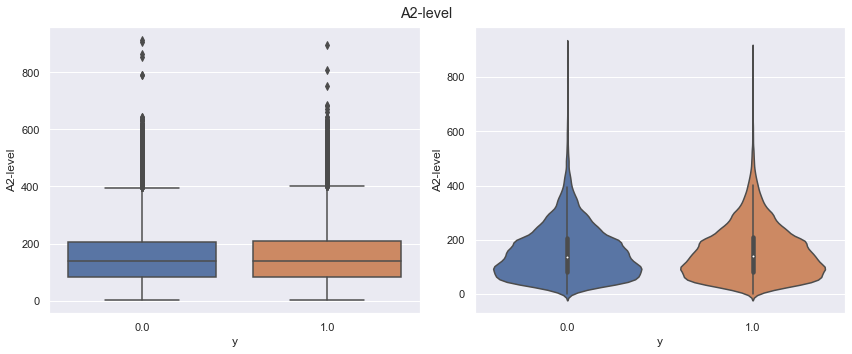

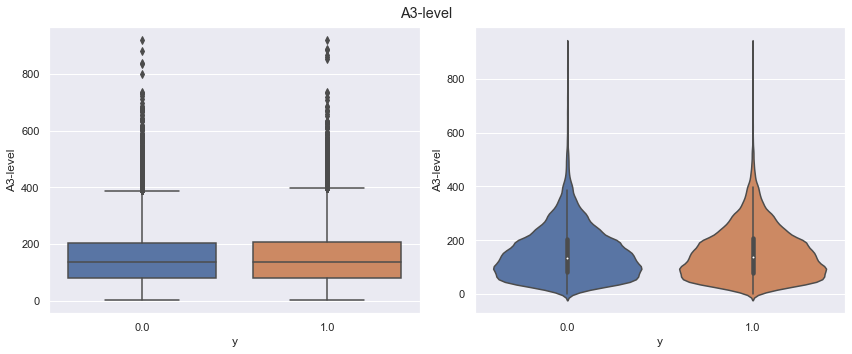

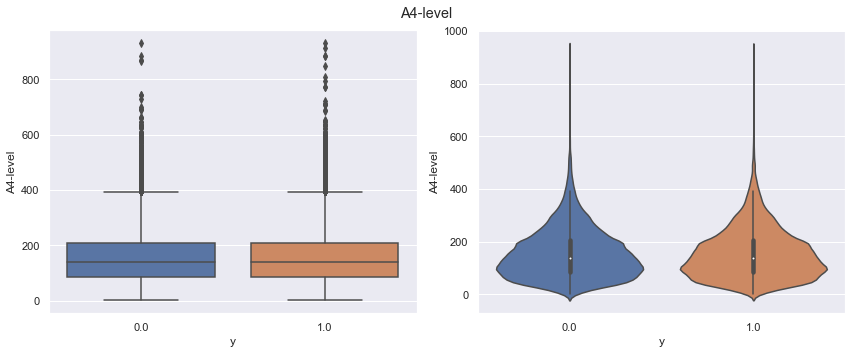

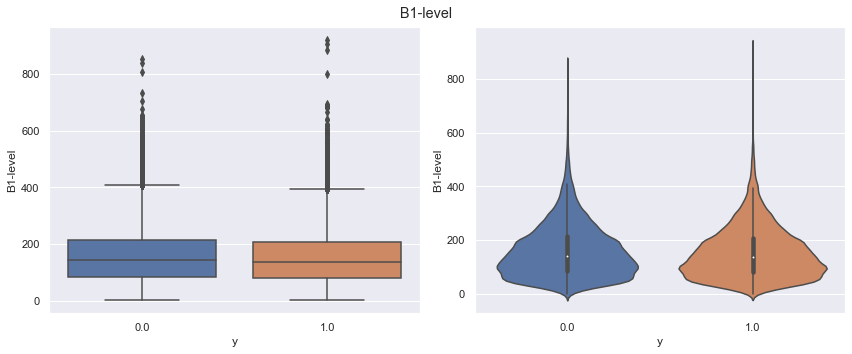

...

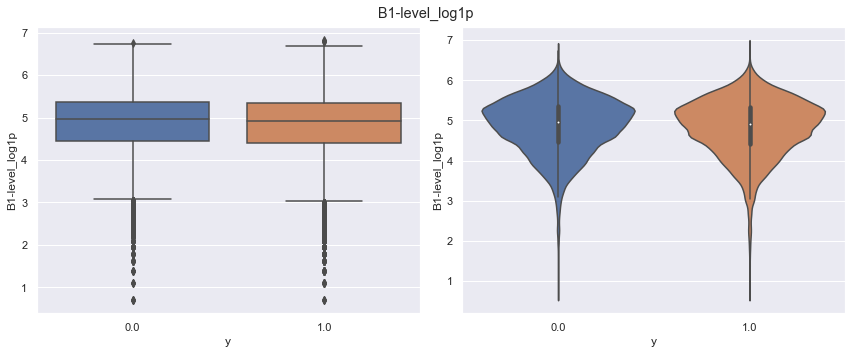

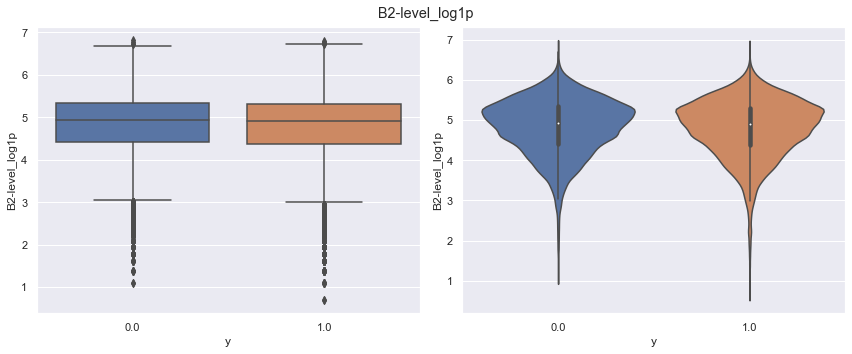

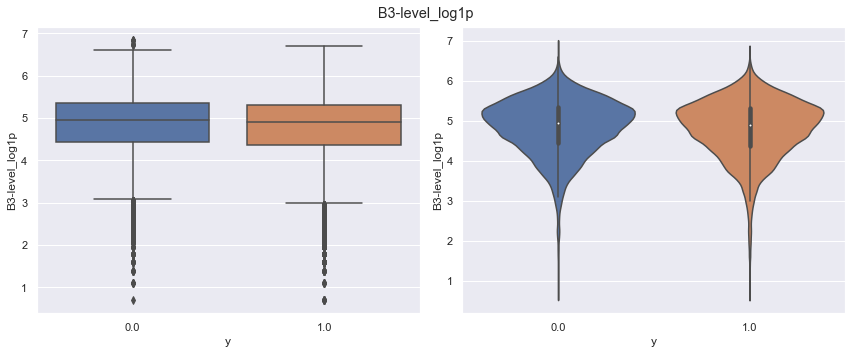

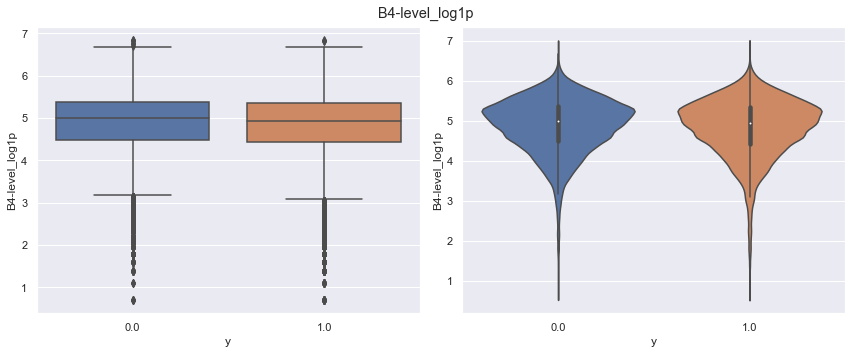

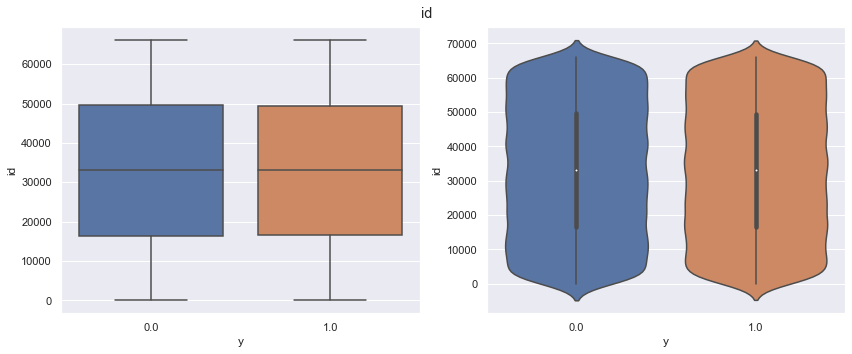

In [35]:
# カテゴリ列 vs. 複数の数値列
cate_col = "y"
num_columns = df_all.select_dtypes(include=["int", "int32", "int64", "float", "float32", "float64"]).columns.to_list()

for i, n_col in enumerate(num_columns):
    fig, ax = plt.subplots(1, 2, figsize=(12, 5))
    fig.suptitle(n_col)
    sns.boxplot(x=cate_col, y=n_col, data=df_all, ax=ax[0])
    sns.violinplot(x=cate_col, y=n_col, data=df_all, ax=ax[1])
    plt.tight_layout(rect=[0,0,1,0.96])  # タイトル重ならないようにする
    plt.show()
    plt.clf()
    plt.close()

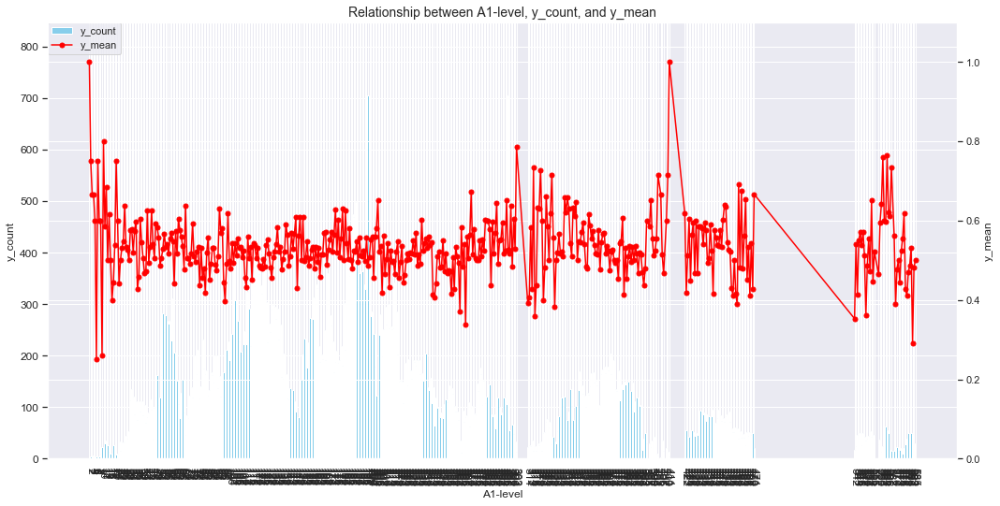

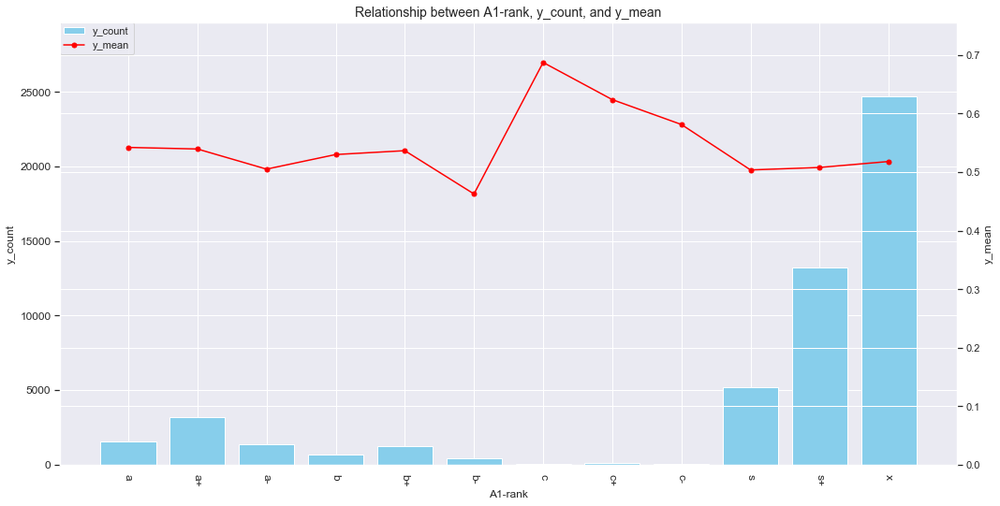

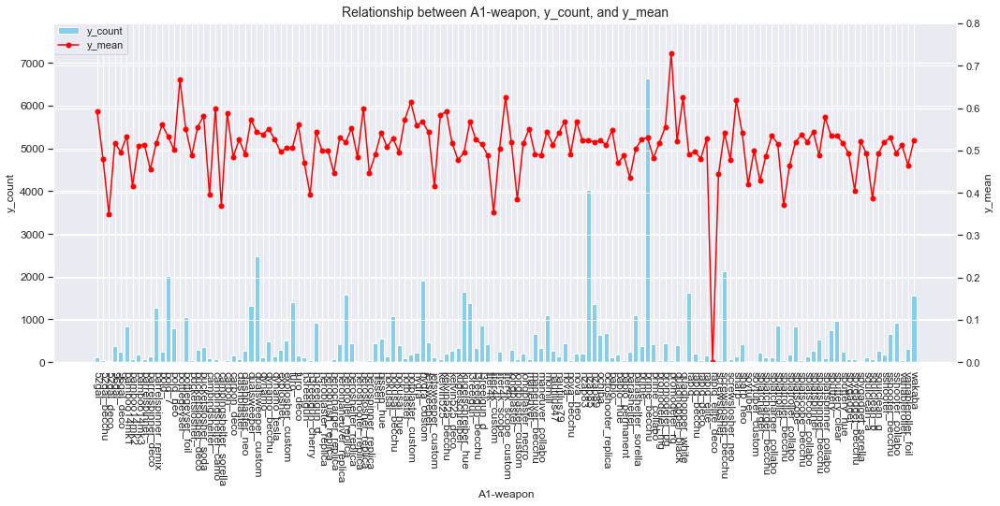

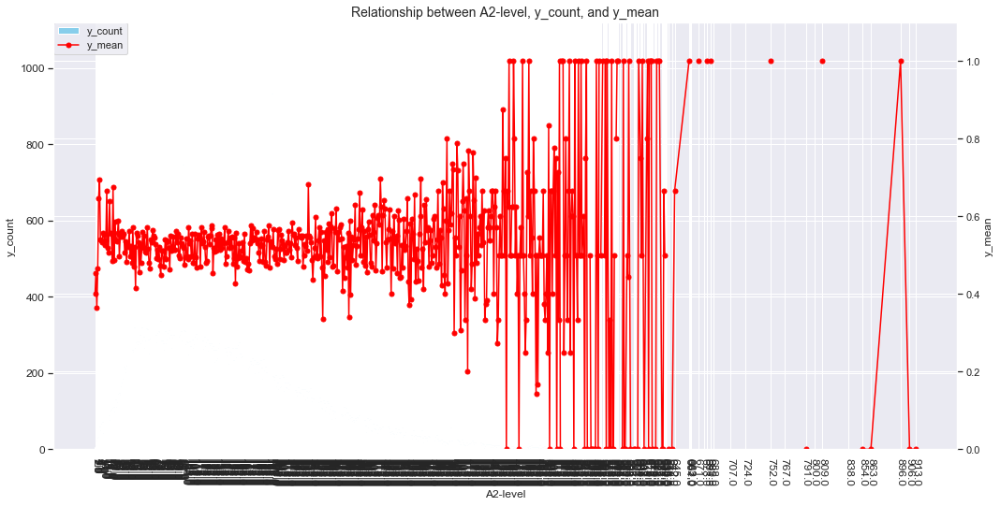

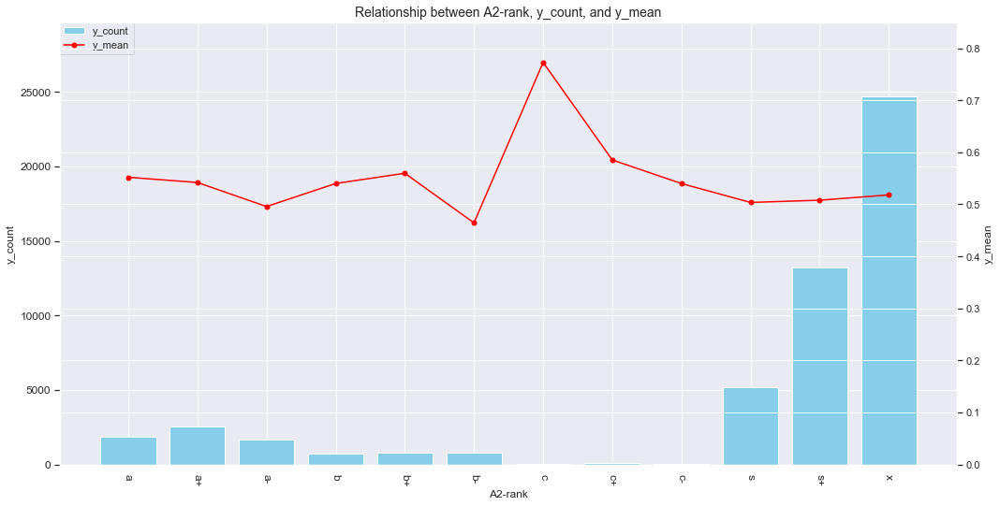

...

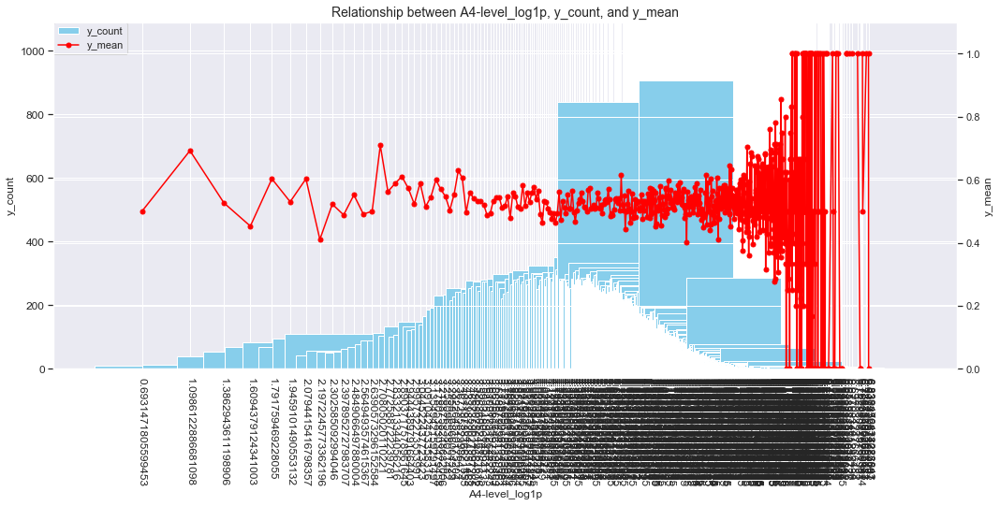

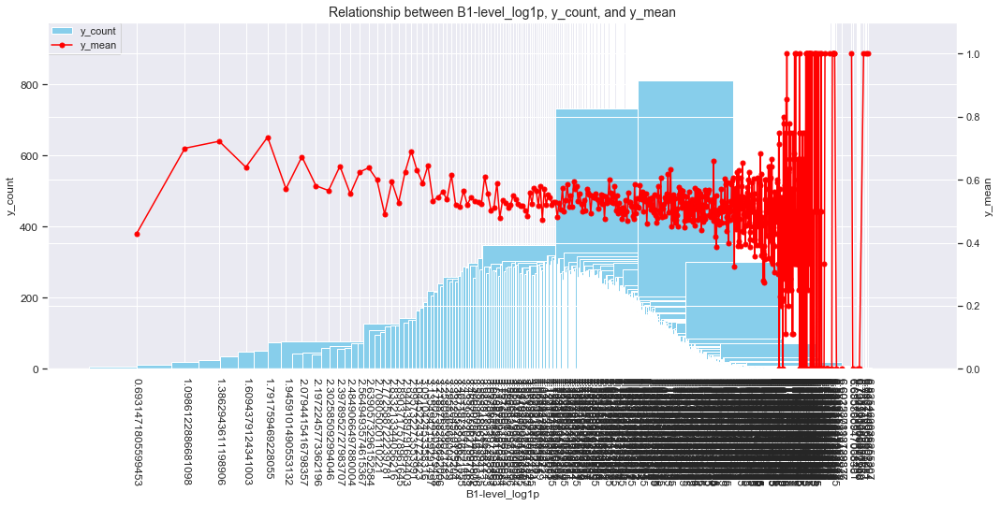

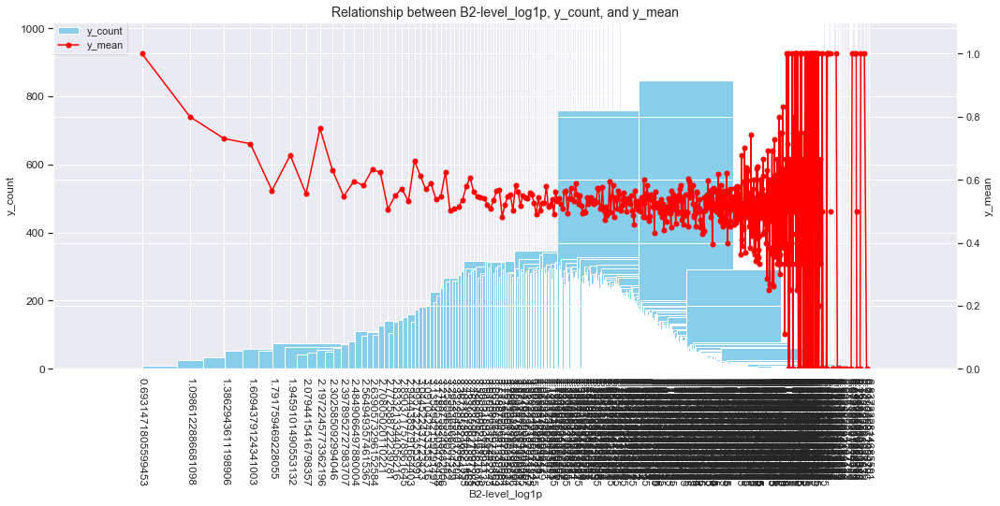

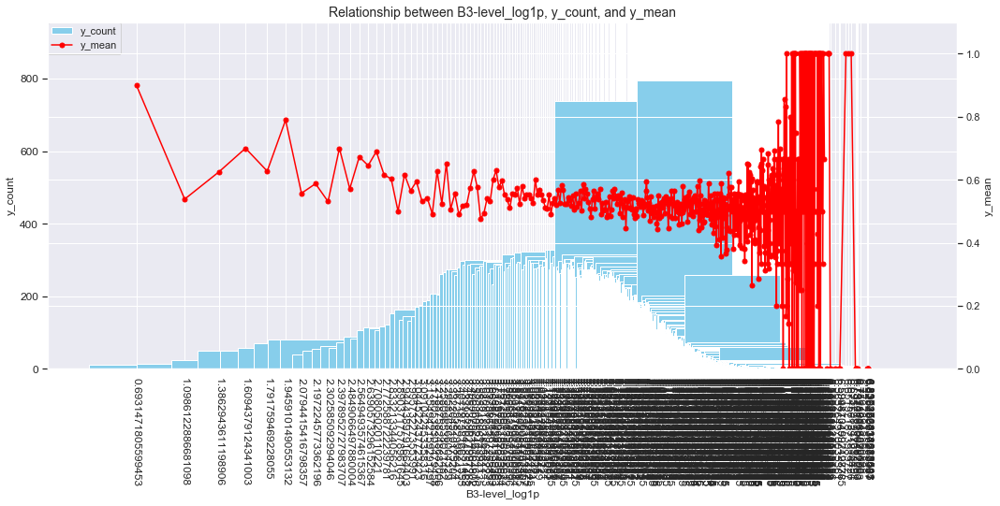

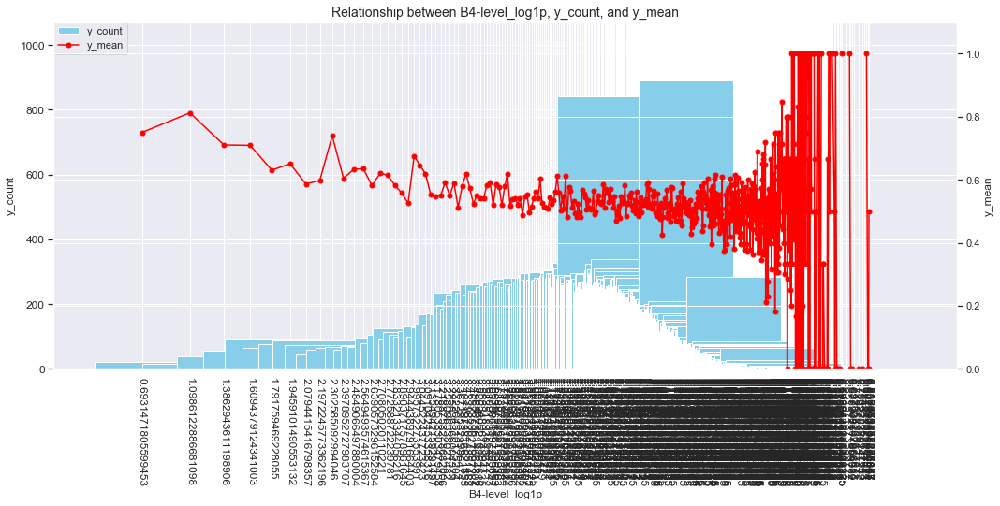

In [36]:
def grouping(df, cols, agg_dict, prefix=""):
    """特定のカラムについてgroup化された特徴量の作成を行う
    Args:
        df (pd.DataFrame): 特徴量作成のもととなるdataframe
        cols (str or list): group by処理のkeyとなるカラム (listで複数指定可能)
        agg_dict (dict): 特徴量作成を行いたいカラム/集計方法を指定するdictionary
        prefix (str): 集約後のカラムに付与するprefix name

    Returns:
        df (pd.DataFrame): 特定のカラムについてgroup化された特徴量群
    """
    group_df = df.groupby(cols).agg(agg_dict)
    group_df.columns = [prefix + c[0] + "_" + c[1] for c in list(group_df.columns)]
    group_df.reset_index(inplace=True)

    return group_df


def plot_target_stats(df, col, agg_dict, plot_config, figsize=(15, 8)):
    """指定したカラムとtargetの関係を可視化する
    Args:
        df (pd.DataFrame): 可視化したい特徴量作成のもととなるdataframe
        col (str): group by処理のkeyとなるカラム
        agg_dict (dict): 特徴量作成を行いたいカラム/集計方法を指定するdictionary

    """

    plt_data = grouping(df, col, agg_dict, prefix="")

    target_col = list(agg_dict.keys())[0]

    # 2軸グラフの作成
    fig, ax1 = plt.subplots(figsize=figsize)

    ax2 = ax1.twinx()

    ax1.bar(
        plt_data[col],
        plt_data[f"{target_col}_count"],
        label=f"{target_col}_count",
        color="skyblue",
        **plot_config["bar"],
    )
    ax2.plot(
        plt_data[col],
        plt_data[f"{target_col}_mean"],
        label=f"{target_col}_mean",
        color="red",
        marker=".",
        markersize=10,
    )

    h1, label1 = ax1.get_legend_handles_labels()
    h2, label2 = ax2.get_legend_handles_labels()

    ax1.legend(h1 + h2, label1 + label2, loc=2, borderaxespad=0.0)
    ax1.set_xticks(plt_data[col])
    ax1.set_xticklabels(plt_data[col], rotation=-90, fontsize=10)

    ax1.set_title(
        f"Relationship between {col}, {target_col}_count, and {target_col}_mean",
        fontsize=14,
    )
    ax1.set_xlabel(f"{col}")
    ax1.tick_params(labelsize=12)

    ax1.set_ylabel(f"{target_col}_count")
    ax2.set_ylabel(f"{target_col}_mean")

    ax1.set_ylim([0, plt_data[f"{target_col}_count"].max() * 1.2])
    ax2.set_ylim([0, plt_data[f"{target_col}_mean"].max() * 1.1])

    plt.tight_layout(rect=[0, 0, 1, 0.96])  # タイトル重ならないようにする
    plt.show()
    plt.clf()
    plt.close()

# 各カラムごとのレコード数と数値型の目的変数の平均値を可視化
target_col = "y"
for col in df_all.columns.to_list():
    # 種別1000未満の列のみ可視化
    n_uni = df_all[col].value_counts().shape[0]
    if n_uni < 1000:
        agg_dict = {target_col: ["count", "mean"]}
        plot_config = {"bar": {"width": 0.8}}
        plot_target_stats(df_all, col, agg_dict, plot_config)

- レベル高いレコードは少ないので平均の値が極端
- A1,A2,A3,A4,B1,B2,B3,B4それぞれレベルの分布が違う。A1はレベル高いレコード多めだが、ほかのはレベル高いのは少ない

C:\Users\81908\Anaconda3\envs\tfgpu\lib\site-packages\statsmodels\nonparametric\kde.py:447: RuntimeWarning: invalid value encountered in greater
  X = X[np.logical_and(X > clip[0], X < clip[1])] # won't work for two columns.
C:\Users\81908\Anaconda3\envs\tfgpu\lib\site-packages\statsmodels\nonparametric\kde.py:447: RuntimeWarning: invalid value encountered in less
  X = X[np.logical_and(X > clip[0], X < clip[1])] # won't work for two columns.
C:\Users\81908\Git\seaborn_analyzer\custom_pair_plot.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_xy["xyrec"] = 1
C:\Users\81908\Git\seaborn_analyzer\custom_pair_plot.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_in

<Figure size 432x288 with 0 Axes>

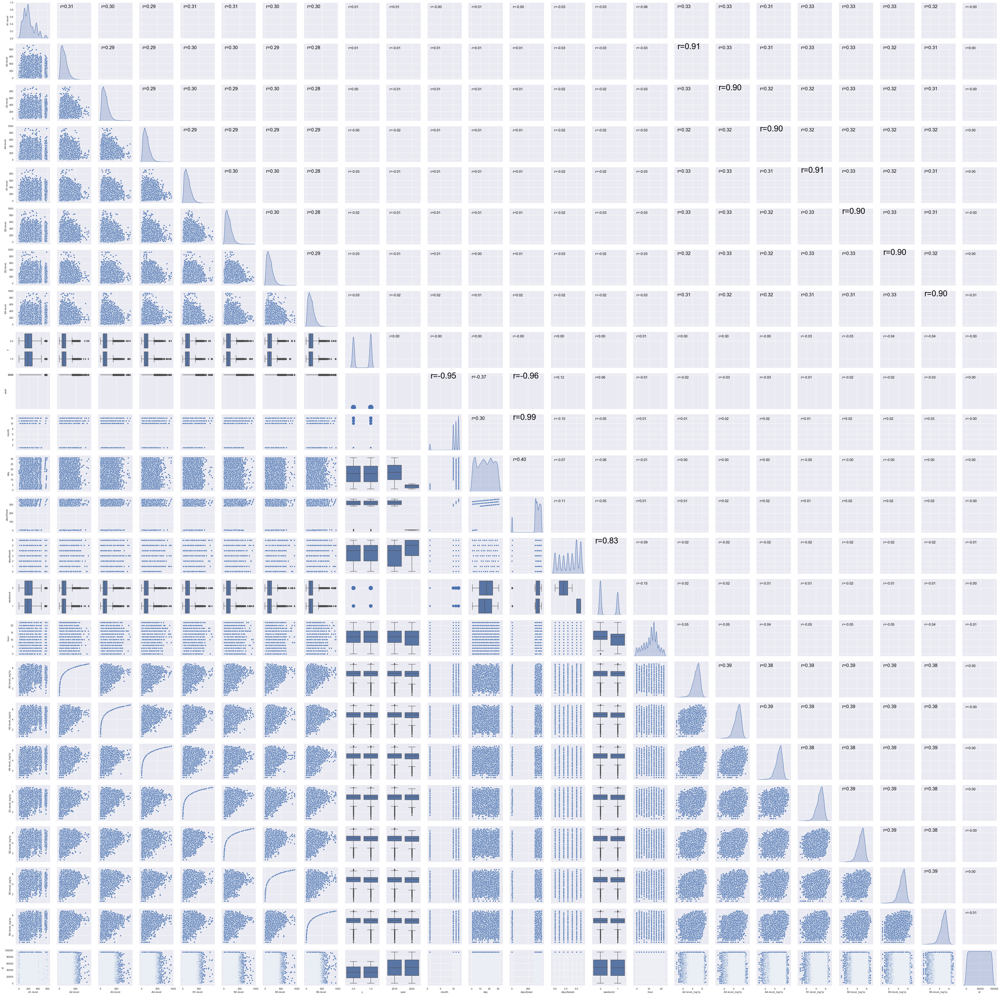

In [37]:
def c_pairplot(df):
    # カスタムペアプロット
    import sys
    sys.path.append(r'C:\Users\81908\Git\seaborn_analyzer')

    from custom_pair_plot import CustomPairPlot
    # 行数列数多いと処理終わらないので注意
    num_columns = df.select_dtypes(include=["int", "int32", "int64", "float", "float32", "float64"]).columns.to_list()
    CustomPairPlot().pairanalyzer(df[num_columns])  # dfでも実行できる
    plt.show()
    
c_pairplot(df_all)

# 追加データ見てみる

In [91]:
df_add = pd.read_csv(f"{ORIG}/statink-weapon2.csv")
df_info(df_add)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 139 entries, 0 to 138
Data columns (total 19 columns):
category1     139 non-null object
category2     139 non-null object
key           139 non-null object
subweapon     139 non-null object
special       139 non-null object
mainweapon    139 non-null object
reskin        139 non-null object
splatnet      139 non-null int64
[de-DE]       139 non-null object
[en-GB]       139 non-null object
[en-US]       139 non-null object
[es-ES]       139 non-null object
[es-MX]       139 non-null object
[fr-CA]       139 non-null object
[fr-FR]       139 non-null object
[it-IT]       139 non-null object
[ja-JP]       139 non-null object
[nl-NL]       139 non-null object
[ru-RU]       139 non-null object
dtypes: int64(1), object(18)
memory usage: 20.8+ KB


,category1,category2,key,subweapon,special,mainweapon,reskin,splatnet,[de-DE],[en-GB],[en-US],[es-ES],[es-MX],[fr-CA],[fr-FR],[it-IT],[ja-JP],[nl-NL],[ru-RU]
0,shooter,shooter,52gal,pointsensor,sphere,52gal,52gal,50,.52 Gallon,.52 Gal,.52 Gal,Salpicadora 2000,Salpicadora 2000,Calibre 2000,Calibre 2000,Calibro 2000,.52ガロン,.52 Kaliter,Струевик .52
1,shooter,shooter,52gal_deco,curlingbomb,presser,52gal,52gal_deco,51,.52 Gallon Deko,.52 Gal Deco,.52 Gal Deco,Salpicadora 2000 DX,Salpicadora 2000 chic,Calibre 2000 chic,Calibre 2000 chic,Calibro 2000 DX,.52ガロンデコ,.52 Kaliter Deco,Струевик .52 «Деко»
2,shooter,shooter,96gal,sprinkler,armor,96gal,96gal,80,.96 Gallon,.96 Gal,.96 Gal,Salpicadora 3000,Salpicadora 3000,Calibre 3000,Calibre 3000,Calibro 3000,.96ガロン,.96 Kaliter,Струевик .96
3,shooter,shooter,96gal_deco,splashshield,chakuchi,96gal,96gal_deco,81,.96 Gallon Deko,.96 Gal Deco,.96 Gal Deco,Salpicadora 3000 DX,Salpicadora 3000 chic,Calibre 3000 chic,Calibre 3000 chic,Calibro 3000 DX,.96ガロンデコ,.96 Kaliter Deco,Струевик .96 «Деко»
4,shooter,shooter,promodeler_mg,kyubanbomb,curlingbomb_pitcher,promodeler_mg,promodeler_mg,30,Airbrush MG,Aerospray MG,Aerospray MG,Aerógrafo pro,Aerógrafo GP,Pouche-pouche,Aérogun,Aerografo,プロモデラーMG,Kladderwerper,Аэроспрей


,count,mean,std,min,25%,50%,75%,max
splatnet,139,2019.99,1975.86,0,217.5,1112,4000.5,6022


,Feature,Unique values,Most frequent item,Freuquence of most frequent item,Percentage of missing values,Percentage of values in the biggest category,Type
0,category1,6,shooter,67,0,48.2014,object
10,[en-US],139,Undercover Sorella Brella,1,0,0.719424,object
17,[nl-NL],139,Octopoets Gamma,1,0,0.719424,object
16,[ja-JP],139,ロングブラスターカスタム,1,0,0.719424,object
15,[it-IT],139,Blaster lunar,1,0,0.719424,object
14,[fr-FR],139,Extraceur + modifié,1,0,0.719424,object
13,[fr-CA],139,Badigeonneur Disco,1,0,0.719424,object
12,[es-MX],139,Salpicadora 2000 Tonken,1,0,0.719424,object
11,[es-ES],139,Bambufusil 14-III,1,0,0.719424,object
9,[en-GB],139,Undercover Sorella Brella,1,0,0.719424,object


In [96]:
def merage_df_add(df_all, df_add, pre):
    """武器情報の追加ファイルを結合"""
    df_add = df_add[
        ["key", "category1", "category2", "mainweapon", "subweapon", "special", "splatnet"]
    ]
    df_add.columns = [pre + col for col in df_add.columns]
    return pd.merge(df_all, df_add, how="left", left_on=f"{pre}weapon", right_on=f"{pre}key").drop(columns=[f"{pre}key"])

    
df_add = pd.read_csv(f"{ORIG}/statink-weapon2.csv")
for pre in ["A1-", "A2-", "A3-", "A4-", "B1-", "B2-", "B3-", "B4-"]:
    df_all = merage_df_add(df_all, df_add, pre)
df_info(df_all)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 94445 entries, 0 to 94444
Data columns (total 92 columns):
A1-level          94445 non-null int64
A1-rank           73737 non-null object
A1-weapon         94445 non-null object
A2-level          94445 non-null float64
A2-rank           73737 non-null object
A2-weapon         94445 non-null object
A3-level          94445 non-null float64
A3-rank           73737 non-null object
A3-weapon         94445 non-null object
A4-level          94379 non-null float64
A4-rank           73686 non-null object
A4-weapon         94379 non-null object
B1-level          94445 non-null int64
B1-rank           73737 non-null object
B1-weapon         94445 non-null object
B2-level          94445 non-null float64
B2-rank           73737 non-null object
B2-weapon         94445 non-null object
B3-level          94443 non-null float64
B3-rank           73736 non-null object
B3-weapon         94443 non-null object
B4-level          94348 non-null float64
B4-rank

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,period,stage,y,year,month,day,dayofyear,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p,id,A1-category1,A1-category2,A1-mainweapon,A1-subweapon,A1-special,A1-splatnet,A2-category1,A2-category2,A2-mainweapon,A2-subweapon,A2-special,A2-splatnet,A3-category1,A3-category2,A3-mainweapon,A3-subweapon,A3-special,A3-splatnet,A4-category1,A4-category2,A4-mainweapon,A4-subweapon,A4-special,A4-splatnet,B1-category1,B1-category2,B1-mainweapon,B1-subweapon,B1-special,B1-splatnet,B2-category1,B2-category2,B2-mainweapon,B2-subweapon,B2-special,B2-splatnet,B3-category1,B3-category2,B3-mainweapon,B3-subweapon,B3-special,B3-splatnet,B4-category1,B4-category2,B4-mainweapon,B4-subweapon,B4-special,B4-splatnet
0,139,nan,sshooter_becchu,118,nan,soytuber_custom,13,nan,pablo_hue,10,nan,hokusai,28,nan,bold_7,26,nan,hokusai_becchu,68,nan,herocharger_replica,31,nan,sharp_neo,regular,nawabari,2019-10-15 20:00:00+00:00,sumeshi,1,2019,10,15,288,1,0,20,4.77912,2.63906,2.3979,3.3673,3.29584,4.23411,3.46574,0,shooter,shooter,sshooter,kyubanbomb,missile,42,charger,charger,soytuber,curlingbomb,jetpack,2061,roller,brush,pablo,trap,sphere,1101,roller,brush,hokusai,robotbomb,jetpack,1110,shooter,shooter,bold,splashbomb,ultrahanko,2,roller,brush,hokusai,kyubanbomb,ultrahanko,1112,charger,charger,splatcharger,splashbomb,presser,2015,shooter,shooter,sharp,quickbomb,kyubanbomb_pitcher,21
1,198,nan,parashelter_sorella,77,nan,jetsweeper,198,nan,campingshelter_camo,123,nan,nzap85,83,nan,momiji,118,nan,squiclean_b,168,nan,campingshelter,151,nan,sputtery_clear,regular,nawabari,2019-12-14 04:00:00+00:00,arowana,0,2019,12,14,348,5,1,4,4.35671,5.2933,4.82028,4.43082,4.77912,5.1299,5.02388,1,brella,brella,parashelter,robotbomb,splashbomb_pitcher,6001,shooter,shooter,jetsweeper,poisonmist,missile,90,brella,brella,campingshelter,trap,ultrahanko,6012,shooter,shooter,nzap85,kyubanbomb,armor,60,shooter,shooter,wakaba,robotbomb,amefurashi,11,charger,charger,squiclean_a,robotbomb,sphere,2001,brella,brella,campingshelter,jumpbeacon,bubble,6010,shooter,maneuver,sputtery,torpedo,chakuchi,5002
2,114,a-,nzap89,68,a,quadhopper_black,225,a,prime_becchu,107,a,jetsweeper,50,a-,bold_7,163,a+,nzap85,160,a-,prime_becchu,126,a,dualsweeper_custom,gachi,hoko,2019-12-25 14:00:00+00:00,ama,0,2019,12,25,359,2,0,14,4.23411,5.42053,4.68213,3.93183,5.09987,5.0814,4.84419,2,shooter,shooter,nzap85,robotbomb,missile,61,shooter,maneuver,quadhopper_black,robotbomb,chakuchi,5040,shooter,shooter,prime,splashbomb,nicedama,72,shooter,shooter,jetsweeper,poisonmist,missile,90,shooter,shooter,bold,splashbomb,ultrahanko,2,shooter,shooter,nzap85,kyubanbomb,armor,60,shooter,shooter,prime,splashbomb,nicedama,72,shooter,maneuver,dualsweeper,splashbomb,amefurashi,5031
3,336,nan,bamboo14mk1,131,nan,splatroller_becchu,189,nan,dynamo_tesla,41,nan,prime_becchu,273,nan,splatcharger_becchu,189,nan,liter4k,194,nan,promodeler_mg,391,nan,hotblaster_custom,regular,nawabari,2019-11-11 14:00:00+00:00,engawa,0,2019,11,11,315,0,0,14,4.8828,5.24702,3.73767,5.61313,5.24702,5.273,5.97126,3,charger,charger,bamboo14mk1,curlingbomb,missile,2050,roller,roller,splatroller,splashbomb,bubble,1012,roller,roller,dynamo,splashbomb,armor,1021,shooter,shooter,prime,splashbomb,nicedama,72,charger,charger,splatcharger,sprinkler,sphere,2012,charger,charger,liter4k,trap,amefurashi,2030,shooter,shooter,promodeler_mg,kyubanbomb,curlingbomb_pitcher,30,shooter,blaster,hotblaster,robotbomb,jetpack,211
4,299,x,bold_7,97,x,hissen_hue,96,x,h3reelgun_d,136,x,splatroller,101,x,furo,45,x,sputtery_hue,246,x,bucketslosher_soda,160,x,wakaba,gachi,hoko,2019-12-14 06:00:00+00:00,chozame,1,2019,12,14,348,5,1,6,4.58497,4.57471,4.91998,4.62497,3.82864,5.50939,5.0814

,count,mean,std,min,25%,50%,75%,max
A1-level,94445,208.731,118.85,1,120,188,277,585
A2-level,94445,155.14,96.0979,1,82,138,208,913
A3-level,94445,153.005,95.4343,1,80,136,205,920
A4-level,94379,155.814,95.4656,1,84,139,208,933
B1-level,94445,156.596,97.3135,1,83,139,210,920
B2-level,94445,152.761,95.3838,1,80,136,205,931
B3-level,94443,153.12,94.8896,1,81,137,205,933
B4-level,94348,157.179,95.3954,1,85,141,210,936
y,66105,0.524605,0.499398,0,0,1,1,1
year,94445,2019.06,0.245009,2019,2019,2019,2019,2020


,Feature,Unique values,Most frequent item,Freuquence of most frequent item,Percentage of missing values,Percentage of values in the biggest category,Type
28,y,2,1,34679,30.0069,36.7187,float64
22,B4-rank,12,x,35266,22.0128,37.3403,object
10,A4-rank,12,x,35279,21.98,37.354,object
19,B3-rank,12,x,35307,21.927,37.3837,object
4,A2-rank,12,x,35307,21.926,37.3837,object
1,A1-rank,12,x,35307,21.926,37.3837,object
7,A3-rank,12,x,35307,21.926,37.3837,object
16,B2-rank,12,x,35307,21.926,37.3837,object
13,B1-rank,12,x,35307,21.926,37.3837,object
91,B4-splatnet,139,1010,4802,0.102705,5.08444,float64


In [38]:
from IPython.display import HTML

HTML("""
<button id="code-show-switch-btn">スクリプトを非表示にする</button>

<script>
var code_show = true;

function switch_display_setting() {
    var switch_btn = $("#code-show-switch-btn");
    if (code_show) {
        $("div.input").hide();
        code_show = false;
        switch_btn.text("スクリプトを表示する");
    }else {
        $("div.input").show();
        code_show = true;
        switch_btn.text("スクリプトを非表示にする");
    }
}

$("#code-show-switch-btn").click(switch_display_setting);
</script>
""")

